# Approach 1: Counting Windows using SIFT Feature Matching & Outlier Rejection


In [1]:
import os
import sys
sys.path.append('C:\\Users\\dhruv\\Anaconda3\\envs\\testPanorama\\Lib\\site-packages')
import cv2
import numpy as np
import matplotlib.pyplot as plt
import imageio
import imutils
from imutils import paths
from sklearn.datasets import make_classification
from sklearn.cluster import MeanShift
from matplotlib import pyplot
import random
import pickle
import csv

In [2]:
!export PATH=/Library/TeX/texbin:$PATH

'export' is not recognized as an internal or external command,
operable program or batch file.


In [25]:
feature_extractor = 'sift' # one of 'sift', 'surf', 'brisk', 'orb'
feature_matching = 'bf'
imgPath = "F:\\IIIT-H Work\\win_det_heatmaps\\datasets\\IIIT-H Dataset\\Bakul-All\\003\\images\\"
coordFilePath = '..//win_det_heatmaps/recordedWindowCoordinatesCSV/coordinatesFromPostProcessing-3-shufflenet.csv'
windowCount = 0

In [26]:
# Displaying the contents of the text file

# del list

with open(coordFilePath, newline='') as f:
    csvread = csv.reader(f)
    print(csvread)
    batch_data = list(csvread)
print(len(batch_data))

print(batch_data[0])


batch_data_int = []
for inner_list in batch_data:
    innet_out_list = []
    for string in inner_list:
        innet_out_list.append(int(float(string)))
    batch_data_int.append(innet_out_list)

print("bATCH_Data_int:", batch_data_int)
print(len(batch_data_int))
print(batch_data_int[1][0])
FinalList = []
for i in range(len(batch_data_int)):
    el = batch_data_int[i]
    elChunks = [el[x:x+4] for x in range(0, len(el), 4)]
    print("elChunks:", elChunks)
    newElChunks = elChunks.copy()
    for i in range(len(elChunks)):
#         newChunk = newElChunks[i]        
        chunk = elChunks[i]
        newChunk = chunk.copy()
        print("newChunk", newChunk)
        print("chunk", chunk)
        newChunk.insert(2, chunk[0])
        newChunk.insert(3, chunk[3])
        newChunk.insert(6, chunk[2])
        newChunk.insert(7, chunk[1])
        print("newModifiedChunk", newChunk)
        newElChunks[i] = newChunk
    print(newElChunks)
    perImageCoords = np.array(newElChunks)
    perImageCoords = perImageCoords.reshape(-1,4,2)
    FinalList.append(perImageCoords)

print("Final list:", FinalList)
print("Final list size:", len(FinalList))
print("Final list:", FinalList[0].shape)
print("Final list:", FinalList[0])

20
['3.150000000000000000e+02', '4.200000000000000000e+01', '4.720000000000000000e+02', '1.870000000000000000e+02']
bATCH_Data_int: [[315, 42, 472, 187], [319, 97, 514, 272, 715, 97, 903, 265], [315, 135, 507, 302, 702, 130, 885, 292], [717, 182, 862, 312, 337, 175, 482, 305], [319, 207, 512, 365, 700, 202, 878, 362], [710, 342, 855, 450, 337, 335, 482, 440], [710, 377, 857, 485, 337, 370, 482, 477, 326, 0, 521, 102, 716, 0, 906, 97], [702, 445, 845, 545, 332, 440, 472, 537, 307, 0, 507, 172, 707, 0, 902, 167], [707, 497, 850, 590, 342, 490, 482, 580, 324, 47, 521, 227, 716, 47, 908, 222], [702, 537, 840, 625, 345, 530, 482, 615, 321, 95, 518, 270, 714, 95, 904, 262], [672, 597, 810, 682, 307, 595, 450, 675, 282, 150, 477, 325, 680, 147, 870, 317], [680, 625, 820, 705, 315, 617, 455, 700, 292, 180, 492, 352, 707, 195, 860, 337], [312, 652, 447, 725, 294, 227, 489, 387, 668, 225, 856, 382], [281, 297, 478, 452, 690, 312, 842, 437], [300, 347, 492, 497, 687, 340, 872, 490, 291, 0, 498, 9

newModifiedChunk [292, 285, 292, 412, 450, 412, 450, 285]
newChunk [687, 290, 837, 412]
chunk [687, 290, 837, 412]
newModifiedChunk [687, 290, 687, 412, 837, 412, 837, 290]
[[292, 285, 292, 412, 450, 412, 450, 285], [687, 290, 687, 412, 837, 412, 837, 290]]
Final list: [array([[[315,  42],
        [315, 187],
        [472, 187],
        [472,  42]]]), array([[[319,  97],
        [319, 272],
        [514, 272],
        [514,  97]],

       [[715,  97],
        [715, 265],
        [903, 265],
        [903,  97]]]), array([[[315, 135],
        [315, 302],
        [507, 302],
        [507, 135]],

       [[702, 130],
        [702, 292],
        [885, 292],
        [885, 130]]]), array([[[717, 182],
        [717, 312],
        [862, 312],
        [862, 182]],

       [[337, 175],
        [337, 305],
        [482, 305],
        [482, 175]]]), array([[[319, 207],
        [319, 365],
        [512, 365],
        [512, 207]],

       [[700, 202],
        [700, 362],
        [878, 362],
        [

In [27]:
def calculateRange(coordinates, padding, imageShape):
    minX = maxX = coordinates[0][0]
    minY = maxY = coordinates[0][1]
    startX = startY = endX = endY = 0
    h,w,c = imageShape
    for i in range(len(coordinates)):
        if minX > coordinates[i][0]:
            minX = coordinates[i][0]
        if maxX < coordinates[i][0]:
            maxX = coordinates[i][0]

        if minY > coordinates[i][1]:
            minY = coordinates[i][1]
        if maxY < coordinates[i][1]:
            maxY = coordinates[i][1]
    
    if (minX - padding < 0):
        startX = 0
    else:
        startX = minX - padding
    if (minY - padding < 0):
        startY = 0
    else:
        startY = minY - padding
    if (maxX + padding >= w):
        endX = w - 1
    else:
        endX = maxX + padding
    if (maxY + padding >= h):
        endY = h - 1
    else:
        endY = maxY + padding
    return startX, endX, startY, endY

def prepareBinaryMask(img_gray, coordinates, padding = 5):
    ret, binary_img = cv2.threshold(img_gray, 255, 255, cv2.THRESH_BINARY)
    for i in range(coordinates.shape[0]):
        startX, endX, startY, endY = calculateRange(coordinates[i], padding, (720,960,3))
        binary_img[startY:endY, startX:endX] = 1
    return binary_img

def mapToPick(coordinates, padding = 5):
    pick = []
    for i in range(coordinates.shape[0]):
        startX, endX, startY, endY = calculateRange(coordinates[i], padding, (720,960,3))
        pick.append([startX, startY, endX, endY])
    return pick

def mapToPickv1(coordinates, padding = 5):
    pick = []
    for i in range(coordinates.shape[0]):
#         startX, startY = coordinates[i][0]
#         endX, endY = coordinates[i][2]
        startX, endX, startY, endY = calculateRange(coordinates[i], padding, (720,960,3))
        pick.append([startX, startY, endX, endY])
    return pick
    

In [28]:
print(FinalList[10])
ans = mapToPickv1(FinalList[10])
print(ans)

[[[672 597]
  [672 682]
  [810 682]
  [810 597]]

 [[307 595]
  [307 675]
  [450 675]
  [450 595]]

 [[282 150]
  [282 325]
  [477 325]
  [477 150]]

 [[680 147]
  [680 317]
  [870 317]
  [870 147]]]
[[667, 592, 815, 687], [302, 590, 455, 680], [277, 145, 482, 330], [675, 142, 875, 322]]








# SIFT Feature Matching on Bounding Box Descriptors(Window masks):




In [29]:
def detectAndDescribe(image, mask, method=None):
    """
    Compute key points and feature descriptors using an specific method
    """
    
    assert method is not None, "You need to define a feature detection method. Values are: 'sift', 'surf'"
    
    # detect and extract features from the image
    if method == 'sift':
        descriptor = cv2.xfeatures2d.SIFT_create()
    elif method == 'surf':
        descriptor = cv2.xfeatures2d.SURF_create()
    elif method == 'brisk':
        descriptor = cv2.BRISK_create()
    elif method == 'orb':
        descriptor = cv2.ORB_create()
        
    # get keypoints and descriptors
    (kps, features) = descriptor.detectAndCompute(image, mask)
#     kps = np.float32([kp.pt for kp in kps])
    return (kps, features)

def createMatcher(method,crossCheck):
    "Create and return a Matcher Object"
    
    if method == 'sift' or method == 'surf':
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=crossCheck)
    elif method == 'orb' or method == 'brisk':
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=crossCheck)
    return bf

def matchKeyPointsBF(featuresA, featuresB, method):
    bf = createMatcher(method, crossCheck=True)
        
    # Match descriptors.
    best_matches = bf.match(featuresA,featuresB)
    
    # Sort the features in order of distance.
    # The points with small distance (more similarity) are ordered first in the vector
    rawMatches = sorted(best_matches, key = lambda x:x.distance)
    print("Raw matches (Brute force):", len(rawMatches))
    return rawMatches

def matchKeyPointsKNN(featuresA, featuresB, ratio, method):
    bf = createMatcher(method, crossCheck=False)
    # compute the raw matches and initialize the list of actual matches
    rawMatches = bf.knnMatch(featuresA, featuresB, 2)
    print("Raw matches (knn):", len(rawMatches))
    print(rawMatches)
    matches = []

    # loop over the raw matches
    for m,n in rawMatches:
        print('m: ' + str(m) + ' n: ' + str(n))
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if m.distance < n.distance * ratio:
            matches.append(m)
    return matches







## Homography Calculation and Outlier Rejection





In [30]:
#
# Computers a homography from 4-correspondences
#
def calculateHomography(correspondences):
    #loop through correspondences and create assemble matrix
    aList = []
    for corr in correspondences:
        p1 = np.matrix([corr.item(0), corr.item(1), 1])
        p2 = np.matrix([corr.item(2), corr.item(3), 1])

        a2 = [0, 0, 0, -p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2),
              p2.item(1) * p1.item(0), p2.item(1) * p1.item(1), p2.item(1) * p1.item(2)]
        a1 = [-p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2), 0, 0, 0,
              p2.item(0) * p1.item(0), p2.item(0) * p1.item(1), p2.item(0) * p1.item(2)]
        aList.append(a1)
        aList.append(a2)

    matrixA = np.matrix(aList)

    #svd composition
    u, s, v = np.linalg.svd(matrixA)

    #reshape the min singular value into a 3 by 3 matrix
    h = np.reshape(v[8], (3, 3))

    #normalize and now we have h
    h = (1/h.item(8)) * h
    return h


#
#Calculate the geometric distance between estimated points and original points
#
def geometricDistance(correspondence, h):
#     print("H: ", h)
#     print("correspondence: ", correspondence)
    p1 = np.transpose(np.matrix([correspondence[0].item(0), correspondence[0].item(1), 1]))
    estimatep2 = np.dot(h, p1)
#     print("estimatep2: ", estimatep2)
#     print(estimatep2.item(2))
    if estimatep2.item(2) == 0:
        return None
    estimatep2 = (1/estimatep2.item(2))*estimatep2
    
#     print("TRANSFORMED estimatep2: ", estimatep2)
    p2 = np.transpose(np.matrix([correspondence[0].item(2), correspondence[0].item(3), 1]))
    error = p2 - estimatep2
    return np.linalg.norm(error)


#
#Runs through ransac algorithm, creating homographies from random correspondences
#
def ransac(corr, thresh):
    maxInliers = []
    finalH = None
    for i in range(1000):
        #find 4 random points to calculate a homography
        corr1 = corr[random.randrange(0, len(corr))]
        corr2 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((corr1, corr2))
        corr3 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr3))
        corr4 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr4))

        #call the homography function on those points
        h = calculateHomography(randomFour)
        inliers = []
        continueFlag = False 
        
        for i in range(len(corr)):
            d = geometricDistance(corr[i], h)
            
            ## set the flag if divide by zero error
            if d == None:
                continueFlag = True
                break
            if d < 5:
                inliers.append(corr[i])
        
        ## Skip the set if divide by zero error
        if(continueFlag == True):
            continue
            
        if len(inliers) > len(maxInliers):
            maxInliers = inliers
            finalH = h
#         print("Corr size: ", len(corr), " NumInliers: ", len(inliers), "Max inliers: ", len(maxInliers))

        if len(maxInliers) > (len(corr)*thresh):
            break
    return finalH, maxInliers

# This draws matches and optionally a set of inliers in a different color
# Note: I lifted this drawing portion from stackoverflow and adjusted it to my needs because OpenCV 2.4.11 does not
# include the drawMatches function
def drawMatches(img1, kp1, img2, kp2, matches, inliers = None):
    print(img1.shape)
    print(img2.shape)
    # Create a new output image that concatenates the two images together
    rows1 = img1.shape[0]
    cols1 = img1.shape[1]
    rows2 = img2.shape[0]
    cols2 = img2.shape[1]

    out = np.zeros((max([rows1,rows2]),cols1+cols2,3), dtype='uint8')

    # Place the first image to the left
    print(np.dstack([img1, img1, img1]).shape)
    out[:rows1,:cols1,:] = img1 #np.dstack([img1, img1, img1])

    # Place the next image to the right of it
    out[:rows2,cols1:cols1+cols2,:] = img2 #np.dstack([img2, img2, img2])

    # For each pair of points we have between both images
    # draw circles, then connect a line between them
    for mat in matches:

        # Get the matching keypoints for each of the images
        img1_idx = mat.queryIdx
        img2_idx = mat.trainIdx

        # x - columns, y - rows
        (x1,y1) = kp1[img1_idx].pt
        (x2,y2) = kp2[img2_idx].pt

        inlier = False

        if inliers is not None:
            for i in inliers:
                if i.item(0) == x1 and i.item(1) == y1 and i.item(2) == x2 and i.item(3) == y2:
                    inlier = True

        # Draw a small circle at both co-ordinates
        cv2.circle(out, (int(x1),int(y1)), 4, (255, 0, 0), 1)
        cv2.circle(out, (int(x2)+cols1,int(y2)), 4, (255, 0, 0), 1)

        # Draw a line in between the two points, draw inliers if we have them
        if inliers is not None and inlier:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (0, 255, 0), 1)
        elif inliers is not None:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (0, 0, 255), 1)

        if inliers is None:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (255, 0, 0), 1)

    return out

In [31]:
## Calculating homography and rejecting outliers

def rejectOutliers(matches, img1, img2, kpsA, kpsB, estimation_thresh = 0.60):
    correspondenceList = []
    for match in matches:
        (x1, y1) = kpsA[match.queryIdx].pt
        (x2, y2) = kpsB[match.trainIdx].pt
        correspondenceList.append([x1, y1, x2, y2])

    corrs = np.matrix(correspondenceList)

    #run ransac algorithm
    finalH, inliers = ransac(corrs, estimation_thresh)
    print("Final homography: ", finalH)
    print("Final inliers count: ", len(inliers))
    print("Inliers: " +  str(inliers))

    img3 = drawMatches(img1,kpsA,img2,kpsB, matches, inliers)
    plt.figure(figsize=(15,15))
    plt.imshow(img3)
    plt.show()

    # for inlier in inliers:
    #     print(inlier[0][0])

    ## Converting to numpy array = INLIERS
    inliers_Arr = np.array(inliers)
    inliers = np.squeeze(inliers_Arr, axis = 1).tolist()
    print(inliers)
    
    return inliers





## Calculation of New Unmatched Windows from inliers in Current Frame:



In [32]:
## For calculation of new Windows in the current Frame
## Take care of many one correspondences even after outlier rejection!!!!

def isInsideBox(rectCoords, coords):
    sX, sY, eX, eY = rectCoords
    x, y = coords
    if x >= sX and x <= eX and y >= sY and y <= eY:
        return True
    return False

def calculateUnMatchedWindows(inliers, picksA, picksB):
    newWindowsCount = 0
    newWindows = []
    matchedWindowsInA = []
    
    insideBCounter = 0

    for box in picksB:
        newBox = True
        print("box2: ", box)

        for inlier in inliers:
            ptA = (round(inlier[0]), round(inlier[1]))
            ptB = (round(inlier[2]), round(inlier[3]))
            print("pointB: ", ptB)
            print("pointA: ", ptA)
            if isInsideBox(box, ptB) == True:
                print("Inside DEBUG LOOP")
                insideBCounter += 1
                print("insideBCounter: ", insideBCounter)
            ## Assign box from A to this inlier
            matchedWindowInA = None
            for box1 in picksA:
                if isInsideBox(box1, ptA) == True:
                    matchedWindowInA = box1
                    break
                    
            print("listA: ", matchedWindowsInA)
            print("ElementA: ", matchedWindowInA)
            print("count: ", matchedWindowsInA.count(matchedWindowInA))
            if isInsideBox(box, ptB) == True and (matchedWindowsInA.count(matchedWindowInA) == 0):
                print("##### OLD BOX #######")
                newBox = False
                matchedWindowsInA.append(matchedWindowInA)
                break
        
        print("fINAL insideBCounter: ", insideBCounter)
        if insideBCounter == 0:
            print("No inliers there in the window")
        
        insideBCounter = 0
        
        if newBox == True:
            print("##### NEW BOX #######")
            newWindowsCount += 1 
            newWindows.append(box)
        print("newCountInItr:", newWindowsCount)
    
    print("new Windows Count: ", newWindowsCount)
    return newWindows, newWindowsCount

def calculateUnMatchedWindowsv1(inliers, picksA, picksB):
    clusterInfoA = []
    clusterInfoB = []
    id1 = 1
    id2 = 1
    newWindowsCount = 0
    newWindows = []
    matchedWindowsInA = []
    
    for box in picksB:
        newBox = True
        print("box2: ", box)
        for inlier in inliers:
            ptA = (int(inlier[0]), int(inlier[1]))
            ptB = (int(inlier[2]), int(inlier[3]))
            print("pointB: ", ptB)
            
            if isInsideBox(box, ptB) == True:
                ## Assign box from A to this inlier
                matchedWindowInA = None
                for box1 in picksA:
                    if isInsideBox(box1, ptA) == True:
                        matchedWindowInA = box1
                        break

                print("listA: ", matchedWindowsInA)
                print("ElementA: ", matchedWindowInA)
                print("count: ", matchedWindowsInA.count(matchedWindowInA))
                if (matchedWindowsInA.count(matchedWindowInA) == 0):
                    print("oldBox")
                    newBox = False
                    matchedWindowsInA.append(matchedWindowInA)
                    break
                    
        if newBox == True:
            newWindowsCount += 1 
            newWindows.append(box)
        print("newCountInItr:", newWindowsCount)
    
    print("new Windows Count: ", newWindowsCount)
    return newWindows, newWindowsCount

[INFO] loading images...
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000070.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000120.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000150.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000170.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000200.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000310.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000330.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000390.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000430.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000470

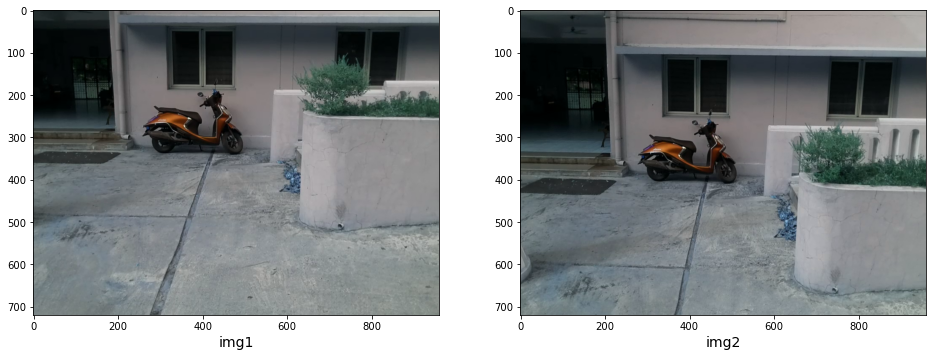

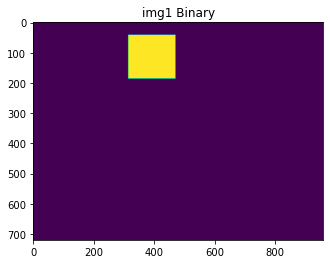

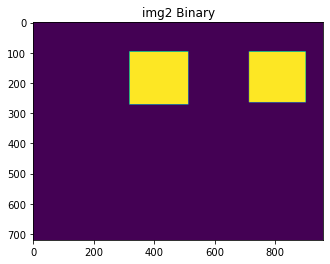

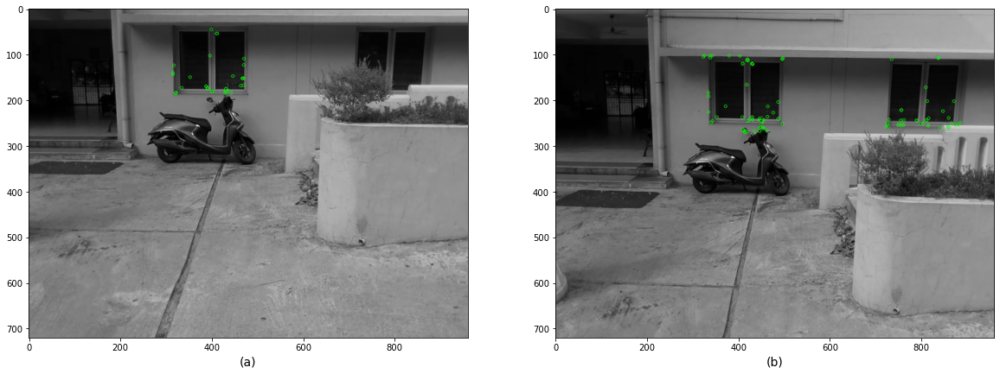

Using: bf feature matcher
Raw matches (Brute force): 18


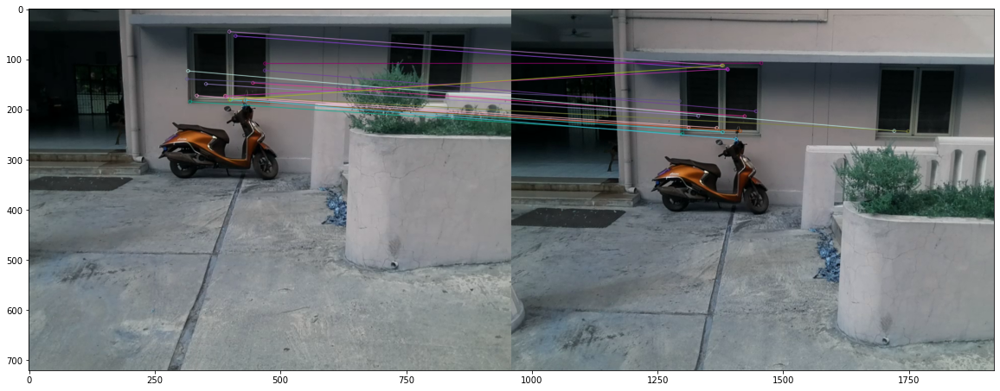

Final homography:  [[ 1.03131076e+00  1.40103559e-01  3.08303786e+00]
 [-2.03924446e-03  1.07679872e+00  6.50658085e+01]
 [-2.01124095e-05  3.53218768e-04  1.00000000e+00]]
Final inliers count:  9
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


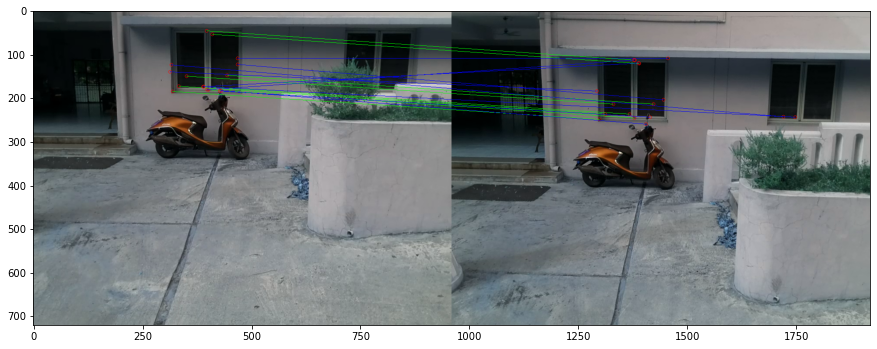

[[445.87823486328125, 147.30148315429688, 463.5961608886719, 213.57369995117188], [402.293701171875, 180.831787109375, 419.88592529296875, 245.28250122070312], [352.4273376464844, 149.47250366210938, 371.3282775878906, 213.19085693359375], [390.68865966796875, 173.063232421875, 408.1224060058594, 236.94845581054688], [320.8916015625, 184.71258544921875, 339.9171447753906, 248.6892547607422], [411.3262634277344, 53.889766693115234, 430.20843505859375, 120.95372772216797], [411.3262634277344, 53.889766693115234, 430.20843505859375, 120.95372772216797], [334.1822814941406, 172.66958618164062, 352.36431884765625, 236.81687927246094], [398.9718322753906, 45.3244743347168, 418.1131286621094, 112.7113265991211]]
pick1: [[315, 42, 472, 187]]
pick2: [[319, 97, 514, 272], [715, 97, 903, 265]]
box2:  [319, 97, 514, 272]
pointB:  (464, 214)
pointA:  (446, 147)
Inside DEBUG LOOP
insideBCounter:  1
listA:  []
ElementA:  [315, 42, 472, 187]
count:  0
##### OLD BOX #######
fINAL insideBCounter:  1
new

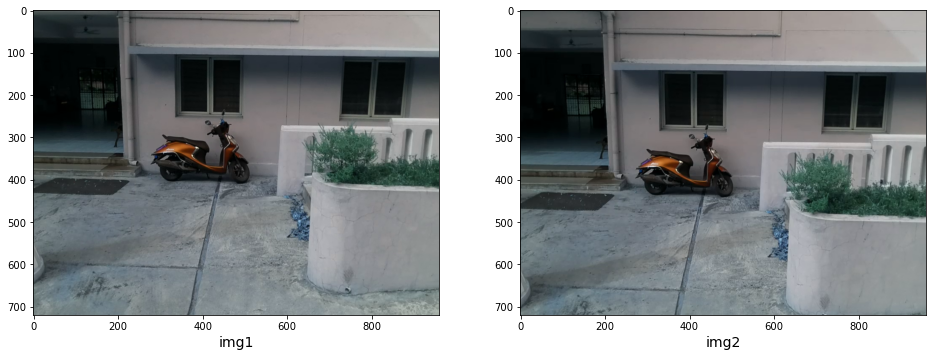

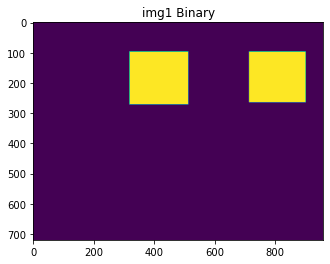

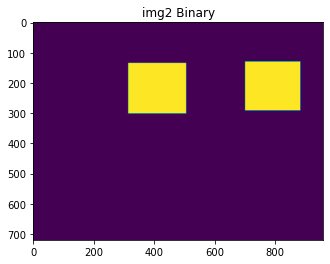

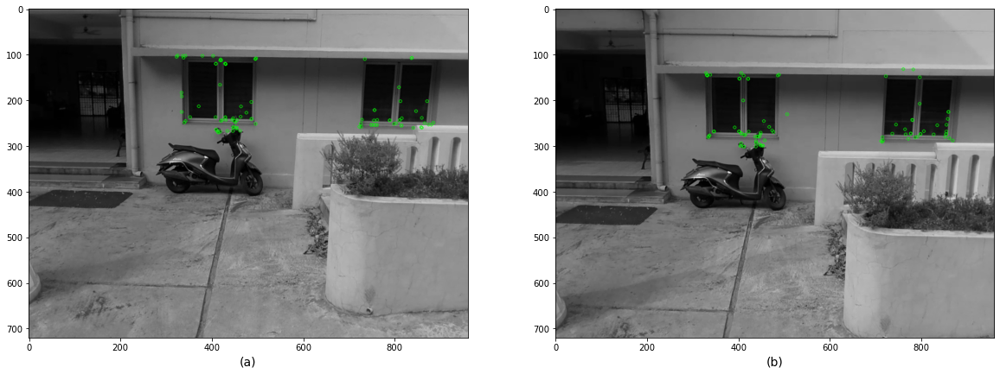

Using: bf feature matcher
Raw matches (Brute force): 48


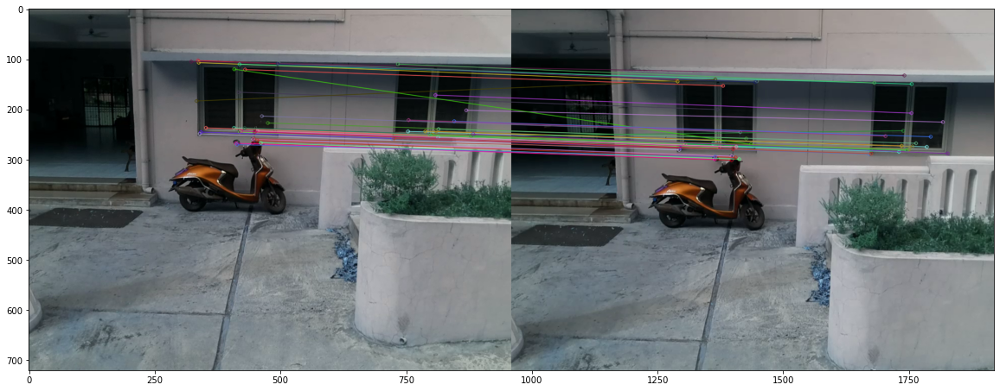

Final homography:  [[ 1.03291647e+00  2.94917395e-02 -2.01288320e+01]
 [ 1.39986910e-03  1.00027585e+00  3.82114294e+01]
 [ 2.91485713e-05  4.04952777e-05  1.00000000e+00]]
Final inliers count:  37
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


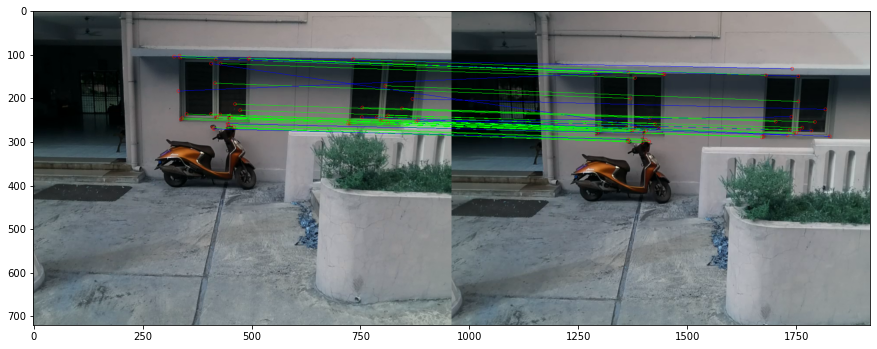

[[475.4477844238281, 227.21038818359375, 466.75531005859375, 258.2190246582031], [463.5961608886719, 213.57369995117188, 454.96649169921875, 245.49240112304688], [336.6394958496094, 102.84209442138672, 328.5779724121094, 140.3684844970703], [725.5074462890625, 251.0004119873047, 714.175537109375, 280.81866455078125], [339.9171447753906, 248.6892547607422, 333.7185974121094, 280.5792236328125], [810.2882080078125, 243.5041046142578, 797.3187255859375, 273.7519226074219], [408.1224060058594, 236.94845581054688, 400.7893371582031, 268.1194152832031], [445.80780029296875, 267.2560119628906, 437.5373840332031, 301.3048400878906], [814.9563598632812, 239.26959228515625, 804.5078125, 267.6454772949219], [337.99957275390625, 106.95259094238281, 330.3164367675781, 144.42161560058594], [419.88592529296875, 245.28250122070312, 412.4970397949219, 276.5215759277344], [352.36431884765625, 236.81687927246094, 345.65228271484375, 268.5019226074219], [429.2615661621094, 237.0513458251953, 421.898254394

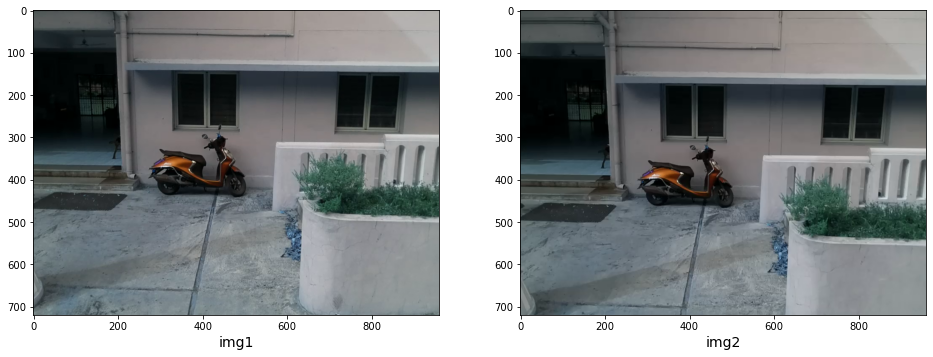

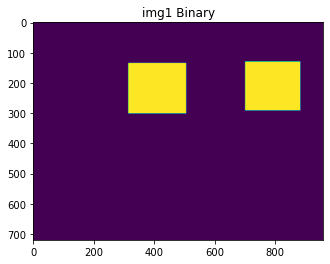

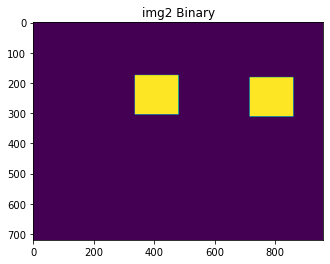

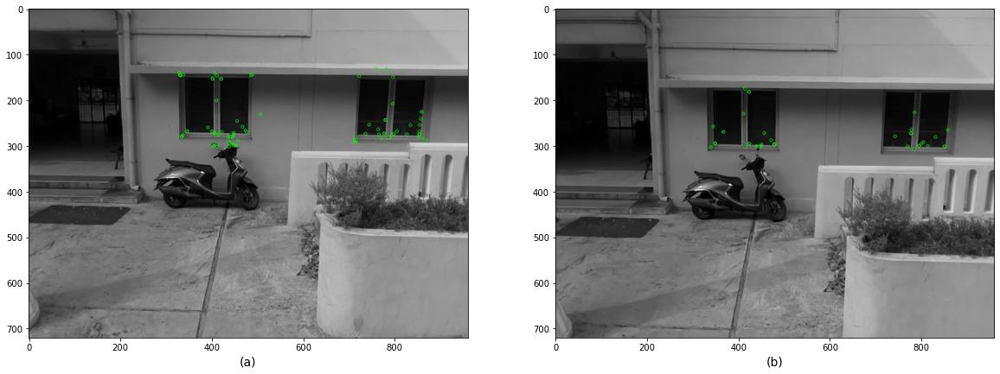

Using: bf feature matcher
Raw matches (Brute force): 28


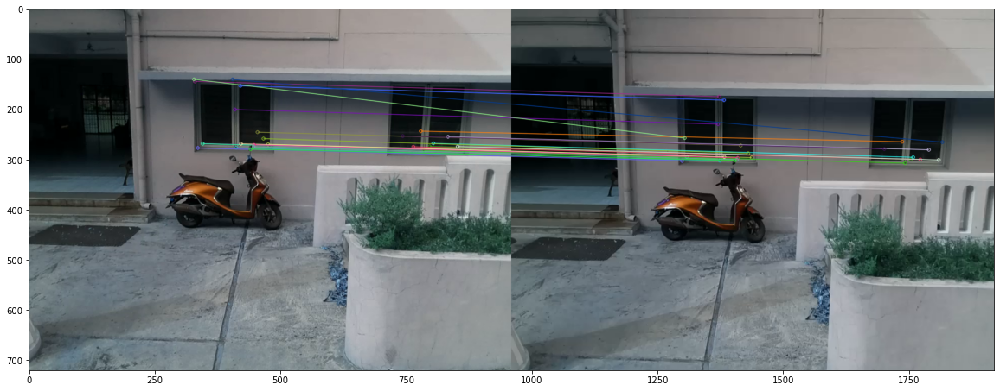

Final homography:  [[ 9.98407300e-01 -1.51887234e-03  4.29222791e+00]
 [ 3.97964761e-03  9.79930133e-01  3.04677533e+01]
 [ 1.09364942e-05 -4.76004709e-06  1.00000000e+00]]
Final inliers count:  23
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


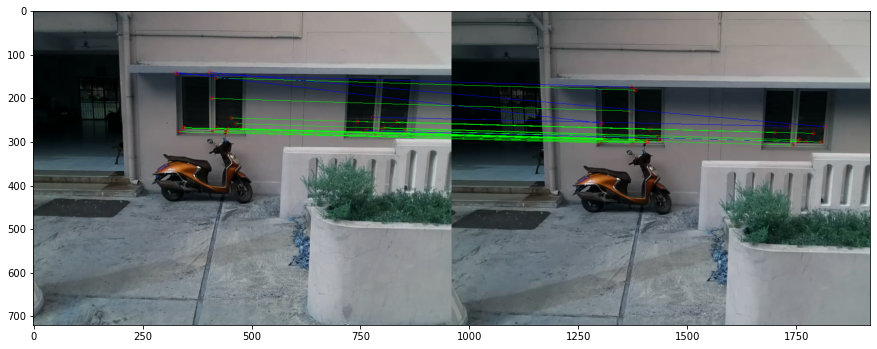

[[797.3187255859375, 273.7519226074219, 794.221435546875, 299.55328369140625], [454.96649169921875, 245.49240112304688, 455.8681335449219, 271.95849609375], [797.3187255859375, 273.7519226074219, 794.221435546875, 299.55328369140625], [346.1761779785156, 267.9504089355469, 349.0975036621094, 293.6350402832031], [412.4970397949219, 276.5215759277344, 414.3883056640625, 302.11590576171875], [833.7256469726562, 254.5486297607422, 830.0606689453125, 280.4794006347656], [409.9254150390625, 200.4058074951172, 410.7632141113281, 229.4178466796875], [476.00335693359375, 269.57891845703125, 477.7105712890625, 295.947998046875], [345.65228271484375, 268.5019226074219, 348.3680725097656, 294.3724365234375], [743.73876953125, 253.2277069091797, 741.572265625, 278.9115905761719], [785.6993408203125, 281.39154052734375, 782.6360473632812, 307.11102294921875], [421.89825439453125, 268.5611877441406, 423.16436767578125, 294.6793518066406], [420.7230224609375, 153.2165069580078, 422.4766540527344, 181.

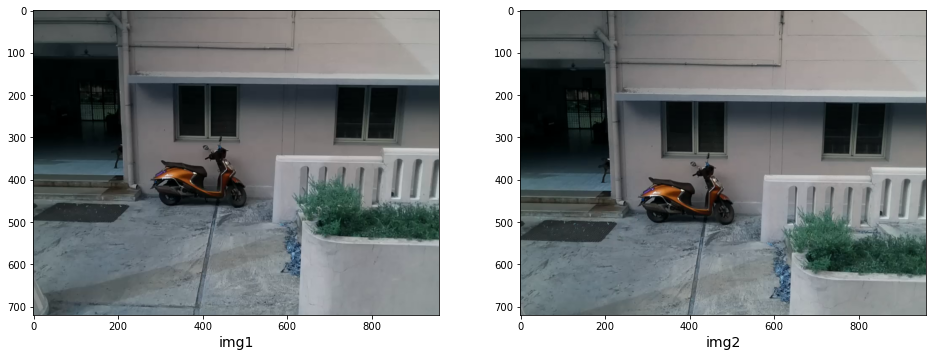

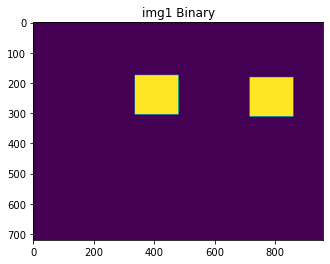

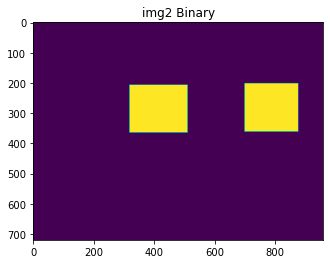

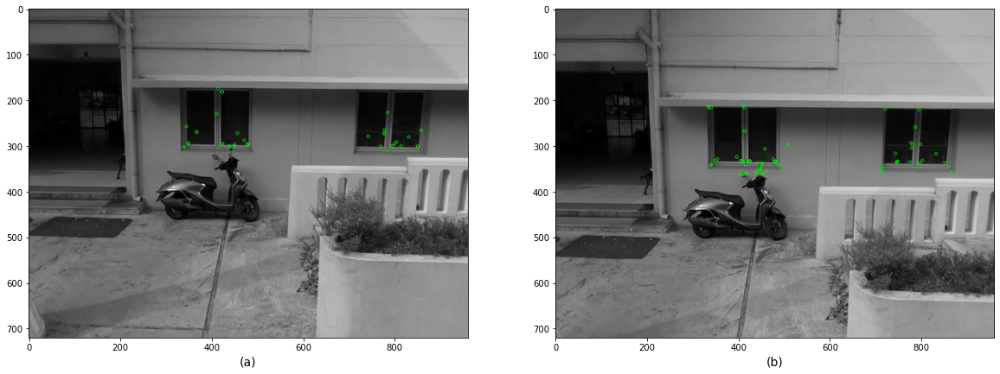

Using: bf feature matcher
Raw matches (Brute force): 27


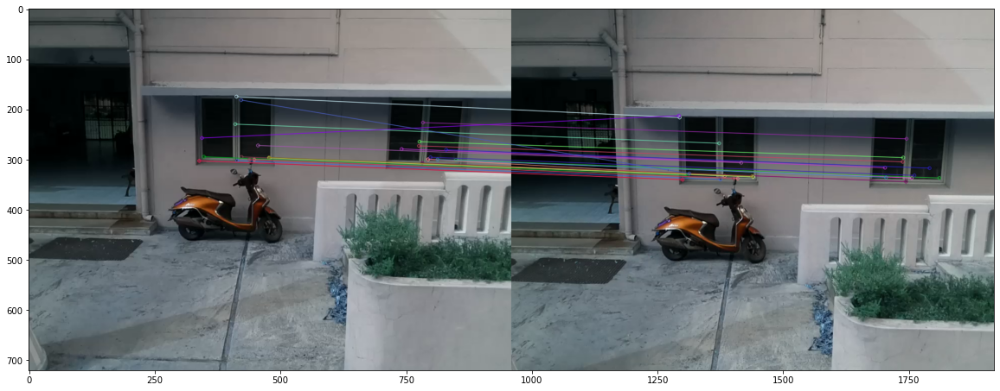

Final homography:  [[ 1.19457432e+00  2.96214524e-01 -1.07799358e+02]
 [ 2.15636439e-02  1.33247866e+00 -2.37013911e+01]
 [ 7.04616588e-05  3.74377035e-04  1.00000000e+00]]
Final inliers count:  21
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


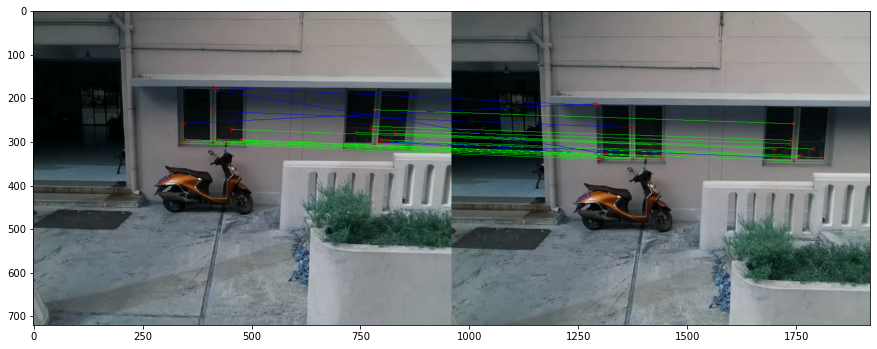

[[794.221435546875, 299.55328369140625, 795.9758911132812, 336.54132080078125], [776.06494140625, 272.75738525390625, 778.0776977539062, 304.416259765625], [849.7186279296875, 300.6654052734375, 850.9291381835938, 336.7502746582031], [777.1002807617188, 264.35321044921875, 779.0935668945312, 296.0665588378906], [477.7105712890625, 295.947998046875, 478.8143005371094, 332.8180236816406], [423.16436767578125, 294.6793518066406, 424.1540832519531, 332.58148193359375], [741.572265625, 278.9115905761719, 742.8589477539062, 316.169189453125], [782.6360473632812, 307.11102294921875, 784.609619140625, 343.890869140625], [798.9439086914062, 295.36517333984375, 801.239013671875, 331.5031433105469], [830.0606689453125, 280.4794006347656, 831.4346313476562, 316.9720458984375], [478.35650634765625, 296.666015625, 480.49151611328125, 334.49822998046875], [455.8681335449219, 271.95849609375, 456.974609375, 306.28729248046875], [478.35650634765625, 296.666015625, 480.49151611328125, 334.49822998046875

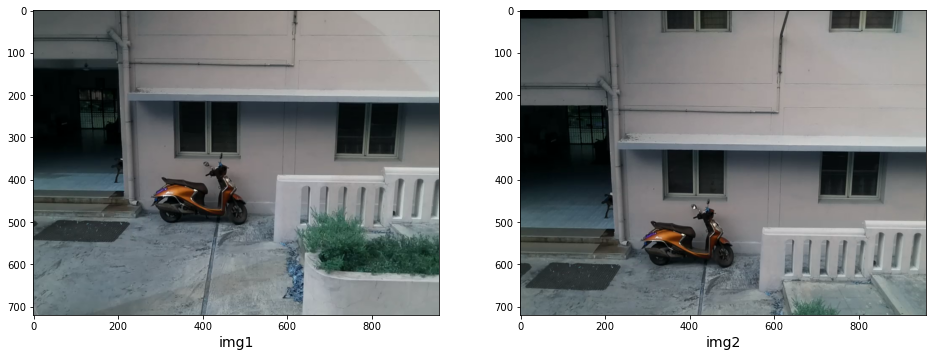

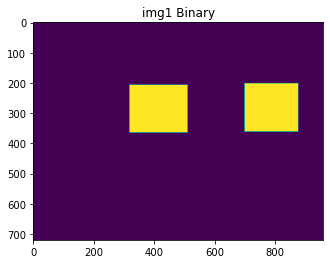

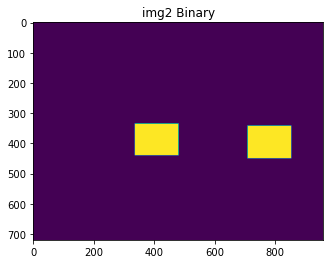

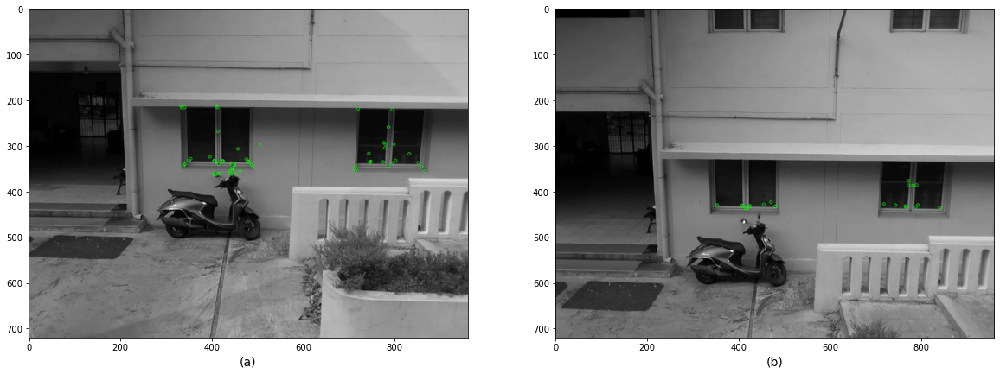

Using: bf feature matcher
Raw matches (Brute force): 20


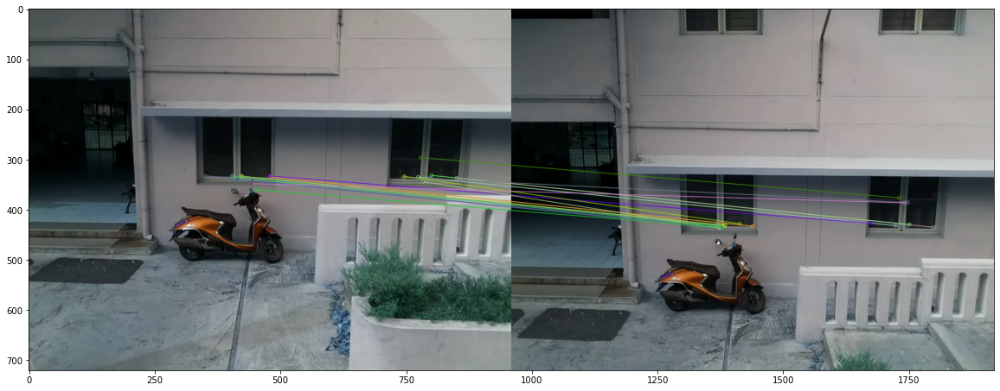

Final homography:  [[ 1.60473003e+00  1.57609953e+00 -4.87471830e+02]
 [-2.35408291e-02  3.23108406e+00 -3.38496505e+02]
 [-4.51768529e-05  2.12736214e-03  1.00000000e+00]]
Final inliers count:  14
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


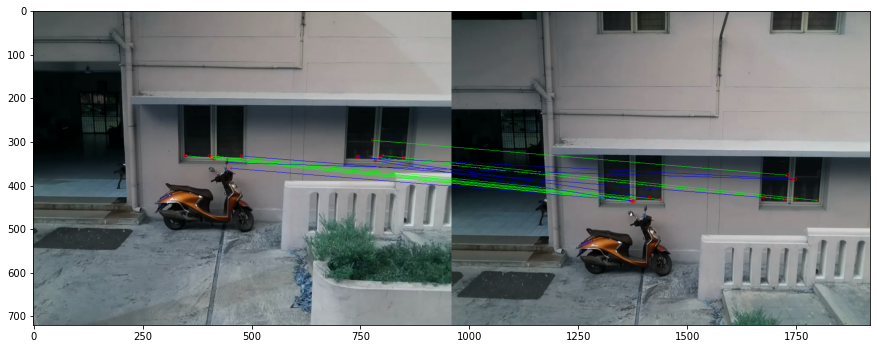

[[801.239013671875, 331.5031433105469, 791.6575927734375, 429.2463684082031], [423.5931396484375, 333.230224609375, 424.6063232421875, 430.96331787109375], [423.5931396484375, 333.230224609375, 424.6063232421875, 430.96331787109375], [480.49151611328125, 334.49822998046875, 479.78802490234375, 432.562744140625], [405.03436279296875, 332.11956787109375, 406.90826416015625, 430.2831726074219], [480.49151611328125, 334.49822998046875, 479.78802490234375, 432.562744140625], [850.9291381835938, 336.7502746582031, 839.5922241210938, 434.7814025878906], [405.03436279296875, 332.11956787109375, 406.90826416015625, 430.2831726074219], [795.9758911132812, 336.54132080078125, 786.8582763671875, 433.5219421386719], [349.6561279296875, 331.7744140625, 352.55584716796875, 429.4269104003906], [774.2904663085938, 334.5765686035156, 764.2269897460938, 431.48223876953125], [779.0935668945312, 296.0665588378906, 770.9517211914062, 376.1209411621094], [409.32720947265625, 335.6429138183594, 411.0311584472

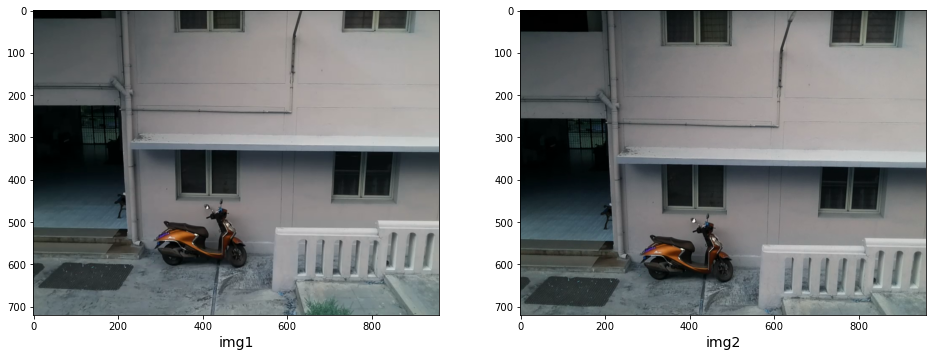

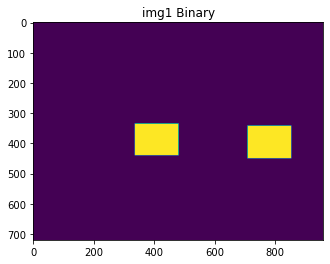

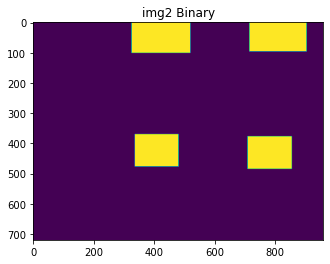

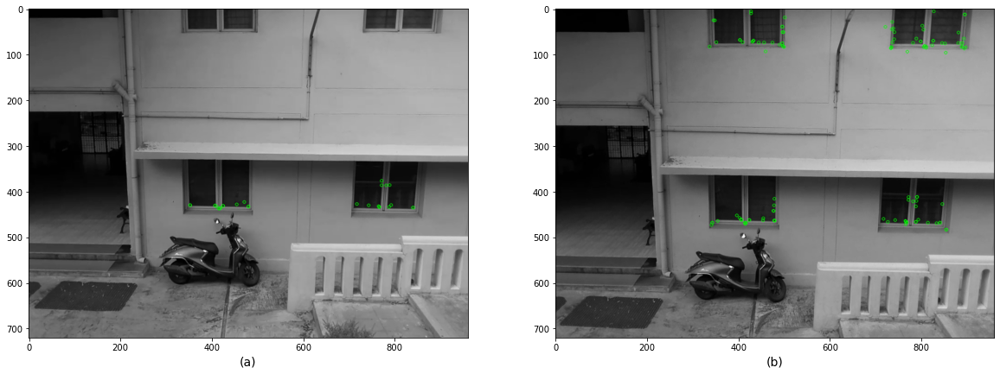

Using: bf feature matcher
Raw matches (Brute force): 19


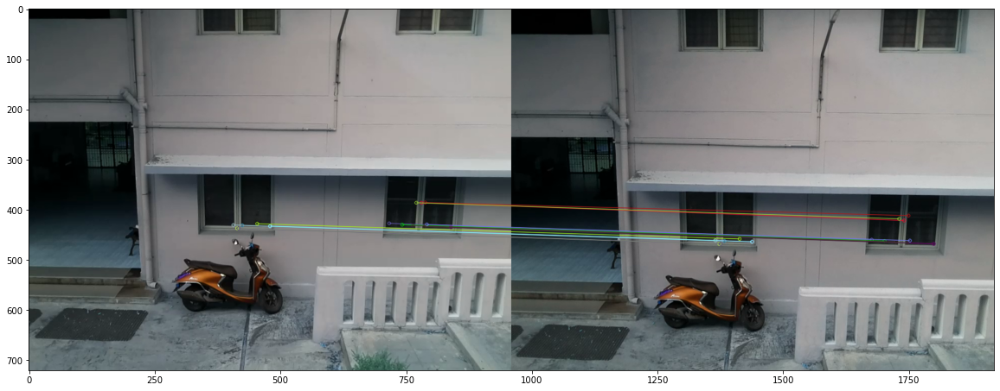

Final homography:  [[ 5.06052914e+00  5.02380817e+00 -1.60349794e+03]
 [-7.63691999e-01  1.30275924e+01 -2.33307039e+03]
 [-1.69610628e-03  1.42026935e-02  1.00000000e+00]]
Final inliers count:  16
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


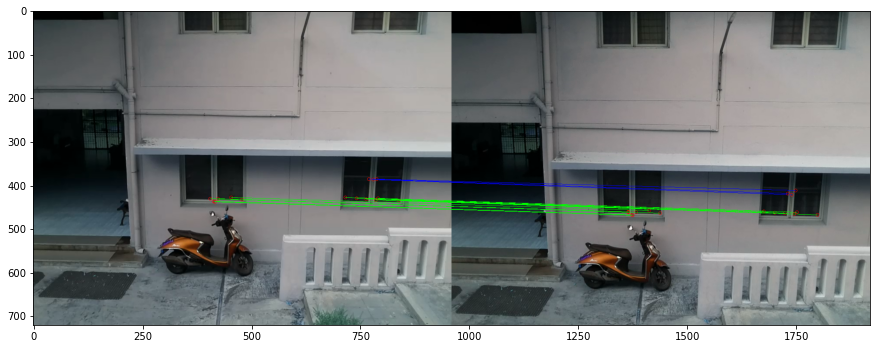

[[716.8838500976562, 427.0057067871094, 716.395751953125, 459.4634704589844], [742.714111328125, 429.689208984375, 741.8626098632812, 462.0871887207031], [424.6063232421875, 430.96331787109375, 423.4423828125, 461.9952392578125], [424.6063232421875, 430.96331787109375, 423.4423828125, 461.9952392578125], [839.5922241210938, 434.7814025878906, 839.7698974609375, 467.7240295410156], [839.5922241210938, 434.7814025878906, 839.7698974609375, 467.7240295410156], [764.2269897460938, 431.48223876953125, 764.2217407226562, 463.8215026855469], [791.6575927734375, 429.2463684082031, 792.3848266601562, 461.3352966308594], [414.5063781738281, 436.85955810546875, 413.15960693359375, 467.9324645996094], [406.90826416015625, 430.2831726074219, 405.1001281738281, 460.7977600097656], [786.8582763671875, 433.5219421386719, 786.994140625, 465.971435546875], [479.78802490234375, 432.562744140625, 478.44671630859375, 463.47344970703125], [417.10369873046875, 437.0375671386719, 415.8465270996094, 468.015075

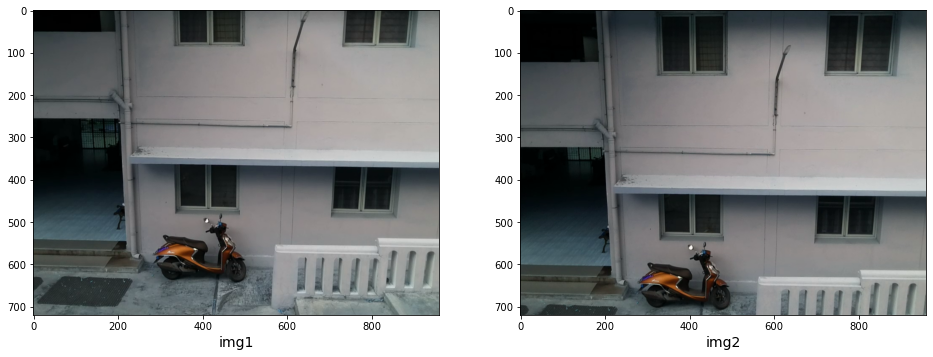

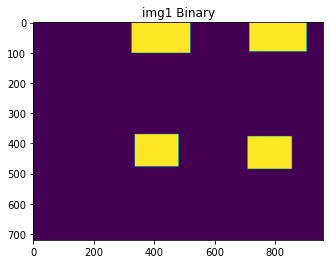

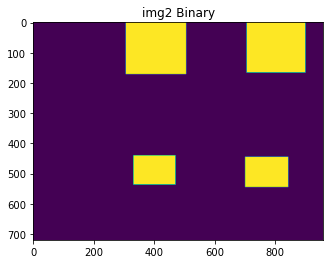

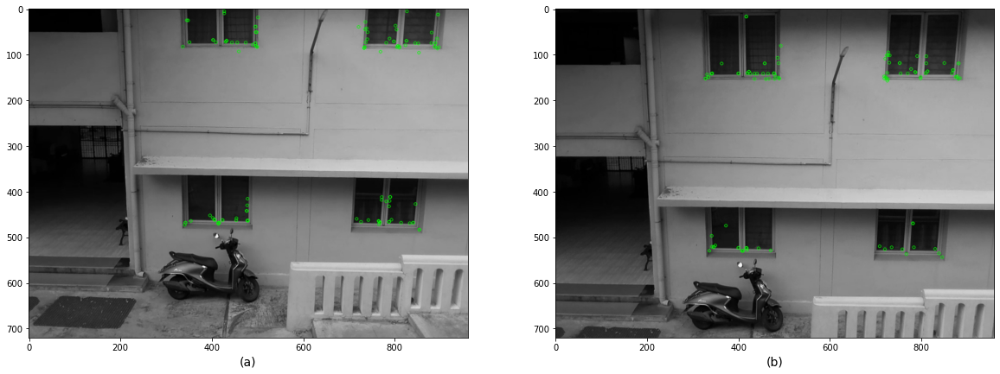

Using: bf feature matcher
Raw matches (Brute force): 62


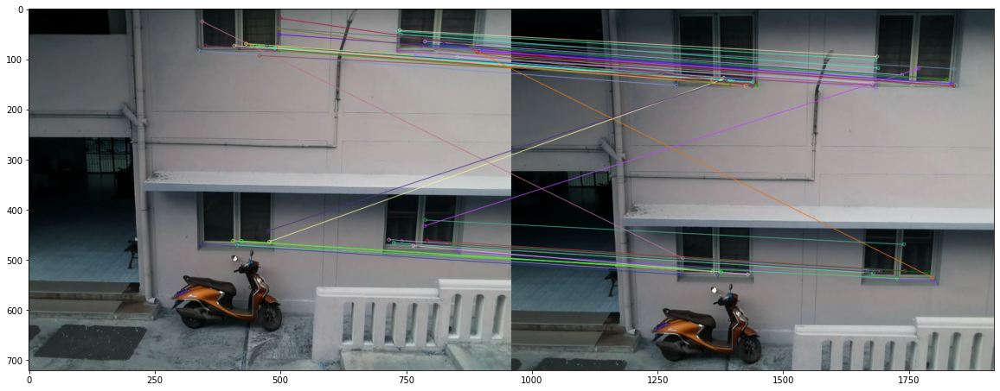

Final homography:  [[ 1.01470360e+00  2.62246044e-02 -1.86890260e+01]
 [-1.74778292e-03  1.00288641e+00  6.90017515e+01]
 [ 7.90542779e-06  2.57273490e-05  1.00000000e+00]]
Final inliers count:  45
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


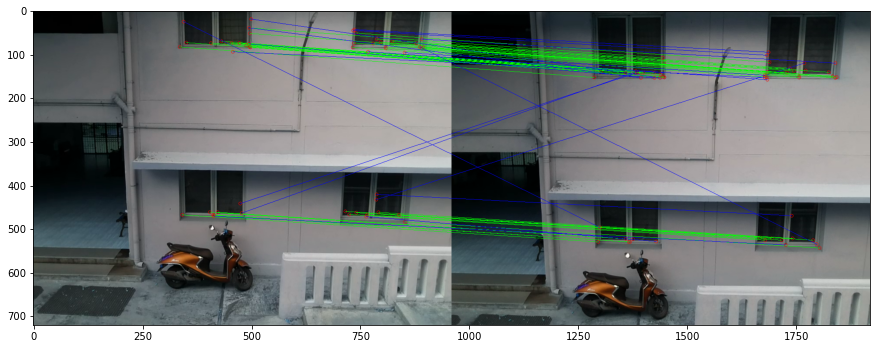

[[716.395751953125, 459.4634704589844, 707.9122924804688, 519.45703125], [497.8255615234375, 51.05318069458008, 487.1498107910156, 119.01908111572266], [741.8626098632812, 462.0871887207031, 734.151123046875, 521.6575317382812], [788.1488037109375, 64.86514282226562, 776.6146240234375, 131.63674926757812], [853.44384765625, 483.14691162109375, 844.31201171875, 543.3010864257812], [432.2962646484375, 69.41262817382812, 422.3280029296875, 137.3872833251953], [423.4423828125, 461.9952392578125, 416.6344909667969, 523.505126953125], [736.0092163085938, 73.28828430175781, 724.4827270507812, 140.13558959960938], [423.4423828125, 461.9952392578125, 416.6344909667969, 523.505126953125], [495.372314453125, 38.7911491394043, 484.97930908203125, 107.01905059814453], [443.7494201660156, 73.71044158935547, 434.3658142089844, 141.71397399902344], [432.2962646484375, 69.41262817382812, 422.3280029296875, 137.3872833251953], [824.9105834960938, 69.69756317138672, 812.5761108398438, 136.506103515625], 

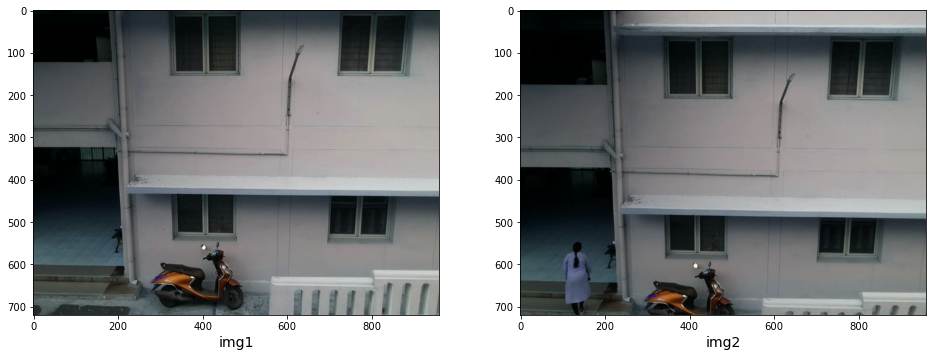

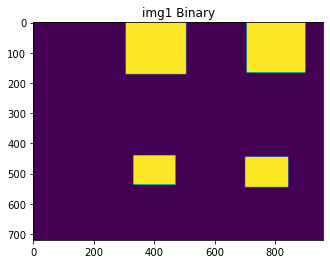

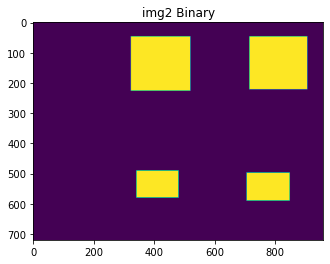

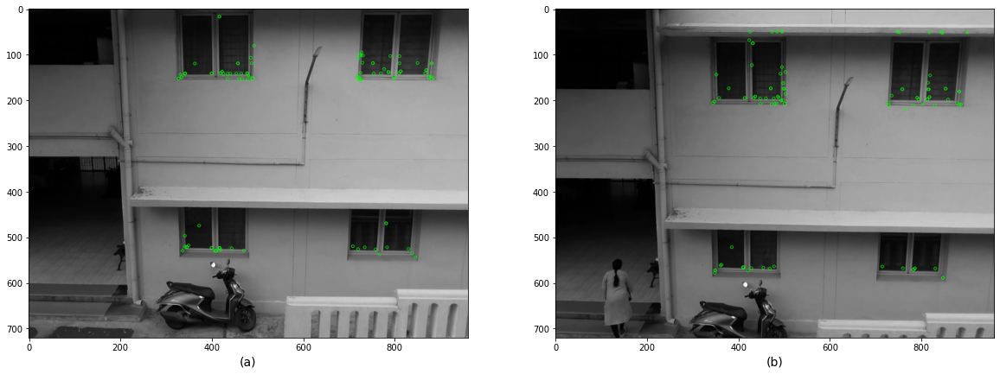

Using: bf feature matcher
Raw matches (Brute force): 56


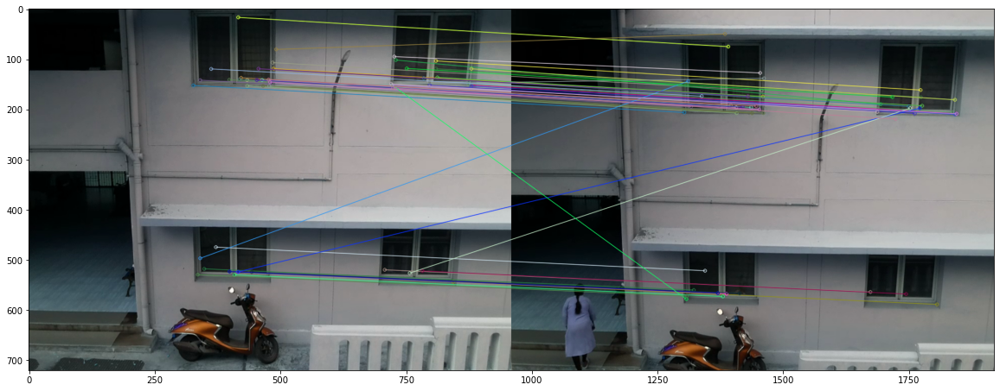

Final homography:  [[ 9.76049756e-01 -1.06724559e-02  2.59585743e+01]
 [ 3.20105648e-03  9.68068164e-01  5.78063423e+01]
 [ 5.32101001e-06 -6.95501523e-06  1.00000000e+00]]
Final inliers count:  43
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


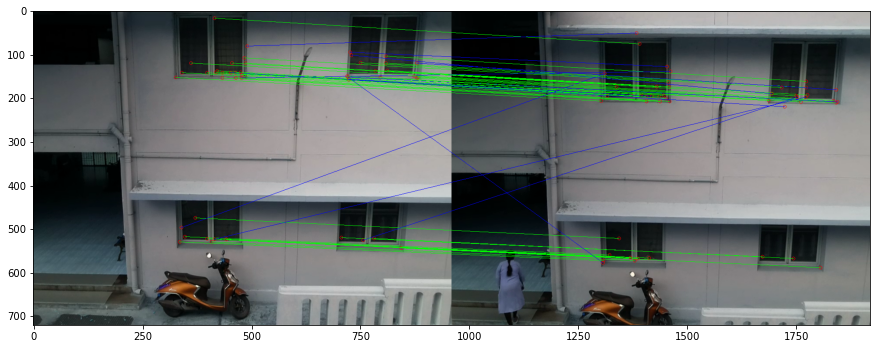

[[812.5761108398438, 136.506103515625, 816.7235717773438, 192.92098999023438], [487.1498107910156, 119.01908111572266, 499.8688049316406, 174.53627014160156], [422.3280029296875, 137.3872833251953, 435.9209289550781, 191.66163635253906], [809.8933715820312, 119.0411605834961, 813.9945068359375, 175.9049835205078], [812.5761108398438, 136.506103515625, 816.7235717773438, 192.92098999023438], [785.5450439453125, 137.88011169433594, 790.0135498046875, 194.1105499267578], [844.31201171875, 543.3010864257812, 846.2945556640625, 588.3847045898438], [422.3280029296875, 137.3872833251953, 435.9209289550781, 191.66163635253906], [707.9122924804688, 519.45703125, 713.7257080078125, 563.7079467773438], [434.3658142089844, 141.71397399902344, 446.952392578125, 196.0648956298828], [399.00567626953125, 141.16403198242188, 413.0635070800781, 194.95681762695312], [464.0042724609375, 141.58311462402344, 476.63134765625, 196.062744140625], [419.2418518066406, 140.68310546875, 433.2194519042969, 194.7250

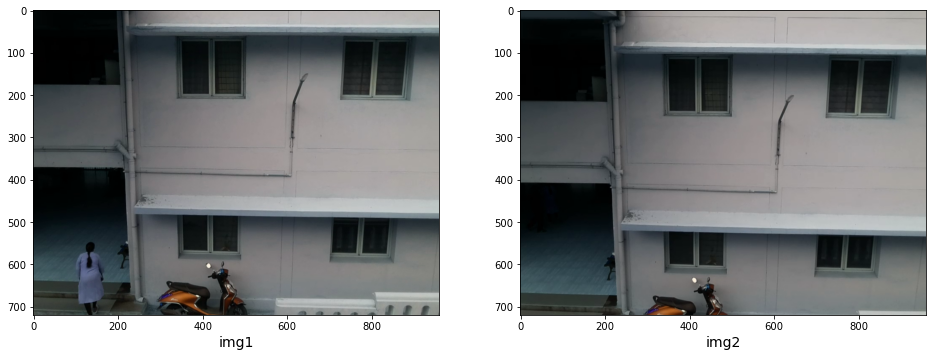

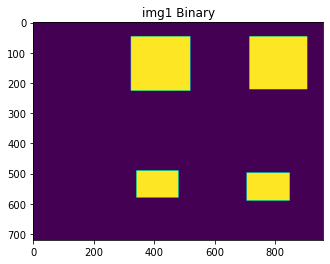

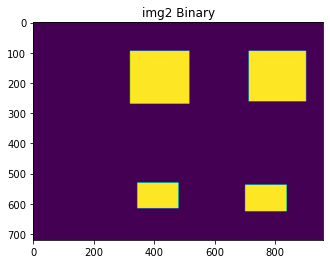

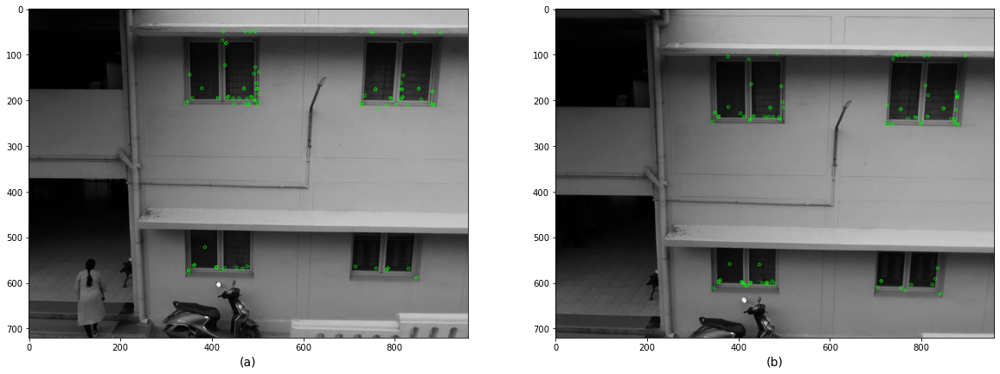

Using: bf feature matcher
Raw matches (Brute force): 54


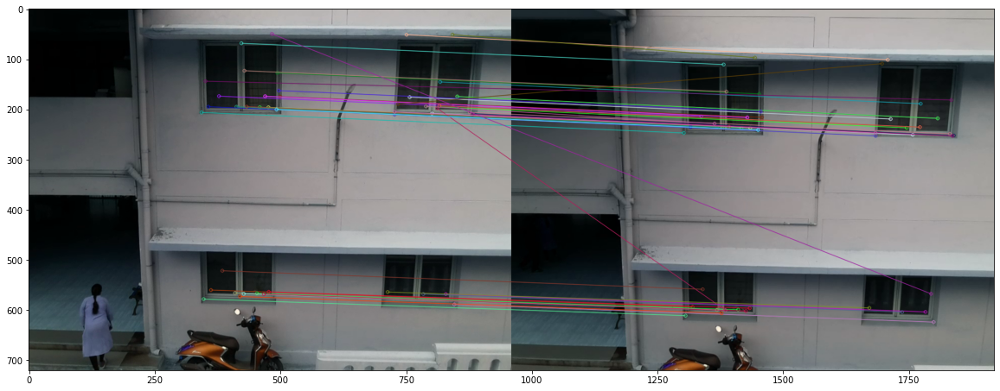

Final homography:  [[ 1.00045368e+00  1.34005490e-02 -8.11538468e-01]
 [ 6.54401795e-03  1.00842489e+00  3.80688033e+01]
 [ 1.25614750e-06  3.70024225e-05  1.00000000e+00]]
Final inliers count:  46
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


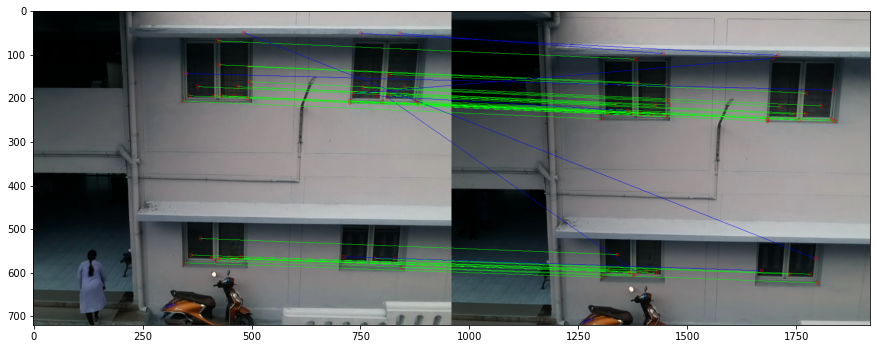

[[499.8688049316406, 174.53627014160156, 498.10699462890625, 215.78846740722656], [378.2847595214844, 173.74313354492188, 377.3110656738281, 214.6107177734375], [470.0806884765625, 173.90921020507812, 468.9762268066406, 216.15814208984375], [470.0806884765625, 173.90921020507812, 468.9762268066406, 216.15814208984375], [790.0135498046875, 194.1105499267578, 786.0289306640625, 236.77423095703125], [846.2945556640625, 588.3847045898438, 839.4135131835938, 623.4984741210938], [846.2945556640625, 588.3847045898438, 839.4135131835938, 623.4984741210938], [816.7235717773438, 192.92098999023438, 812.3881225585938, 235.4260711669922], [816.7235717773438, 192.92098999023438, 812.3881225585938, 235.4260711669922], [347.79296875, 577.72314453125, 346.12799072265625, 610.6719360351562], [476.63134765625, 196.062744140625, 474.8235778808594, 236.6280059814453], [757.5794067382812, 175.60777282714844, 754.001953125, 219.2723846435547], [459.4602966308594, 195.7860107421875, 457.3179626464844, 236.55

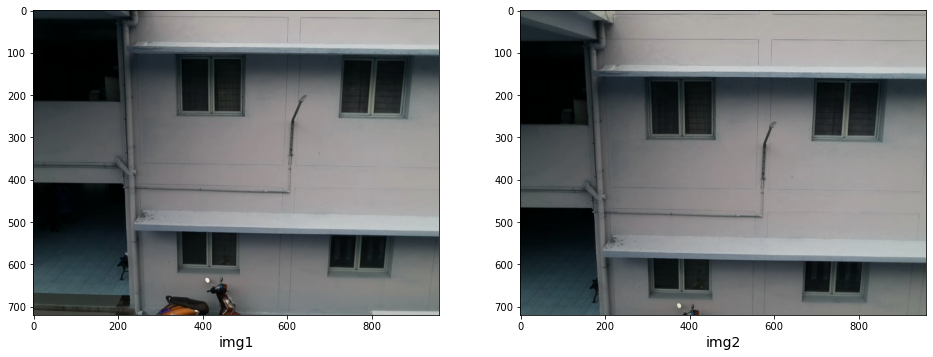

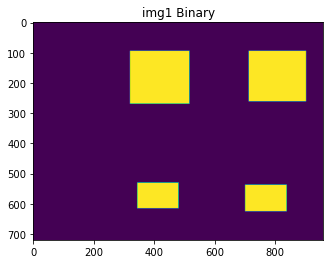

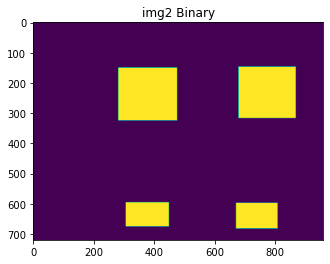

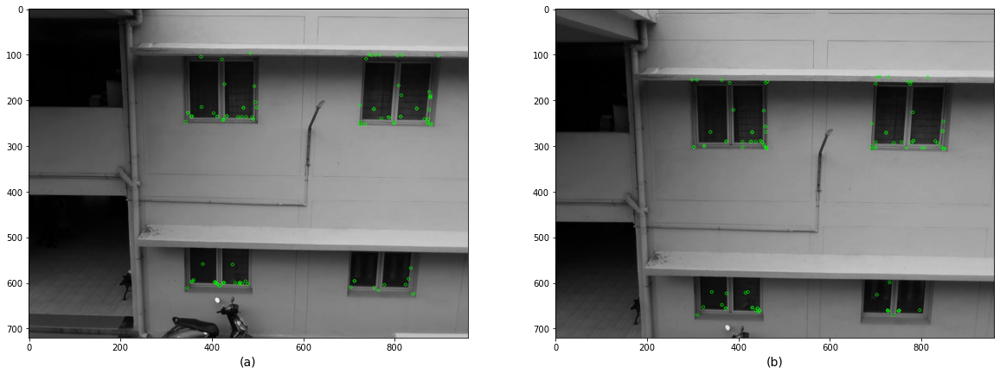

Using: bf feature matcher
Raw matches (Brute force): 51


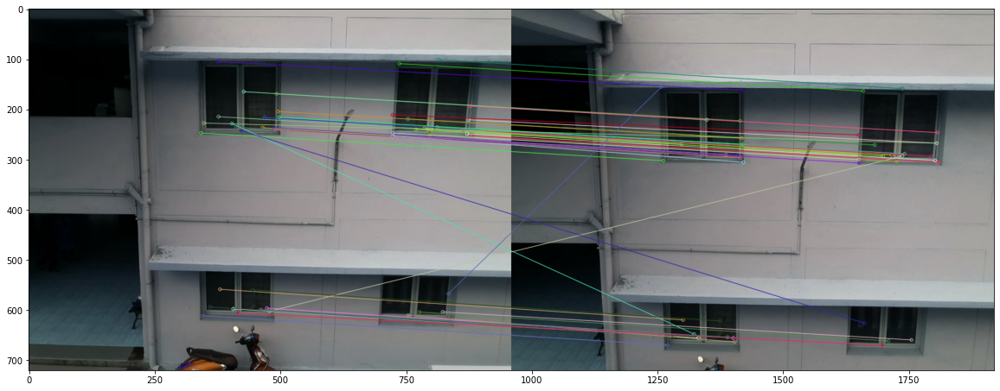

Final homography:  [[ 1.01628648e+00  1.12215799e-02 -4.93402309e+01]
 [-5.23615182e-03  1.00767430e+00  5.46252263e+01]
 [-3.49956384e-06 -1.06825343e-06  1.00000000e+00]]
Final inliers count:  38
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


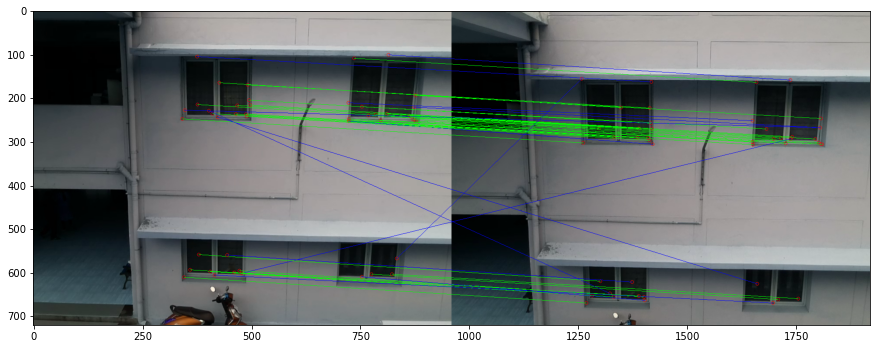

[[377.3110656738281, 214.6107177734375, 338.356201171875, 269.17132568359375], [468.9762268066406, 216.15814208984375, 429.5286865234375, 269.6692199707031], [468.9762268066406, 216.15814208984375, 429.5286865234375, 269.6692199707031], [754.001953125, 219.2723846435547, 722.18798828125, 270.8322448730469], [406.5854187011719, 597.3077392578125, 371.7261047363281, 655.0492553710938], [411.8670349121094, 235.5497589111328, 372.77911376953125, 289.7499694824219], [406.5854187011719, 597.3077392578125, 371.7261047363281, 655.0492553710938], [465.0871887207031, 236.6151123046875, 426.9092102050781, 290.4933776855469], [786.7496948242188, 237.6539306640625, 755.6751098632812, 291.0909729003906], [769.9776611328125, 239.9214324951172, 738.8807373046875, 293.1214599609375], [776.8388671875, 603.65625, 749.4453125, 661.0699462890625], [346.12799072265625, 610.6719360351562, 309.8551330566406, 669.4188232421875], [754.001953125, 219.2723846435547, 722.18798828125, 270.8322448730469], [812.38812

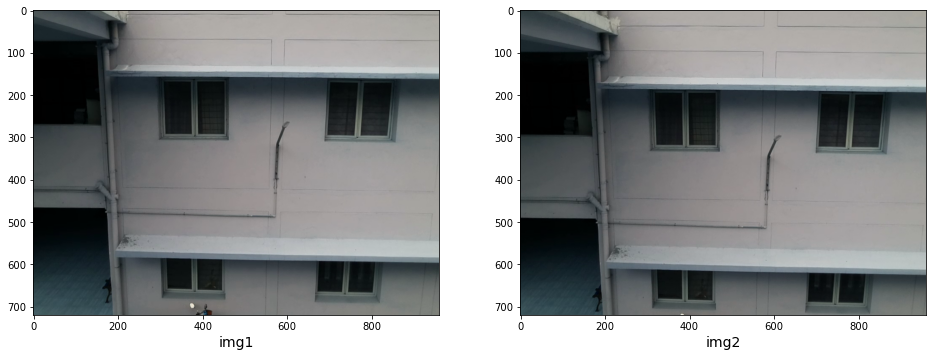

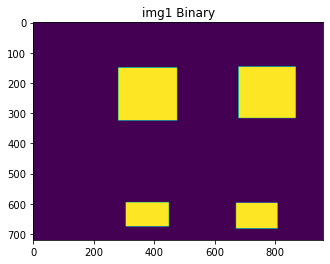

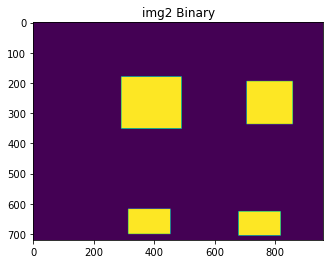

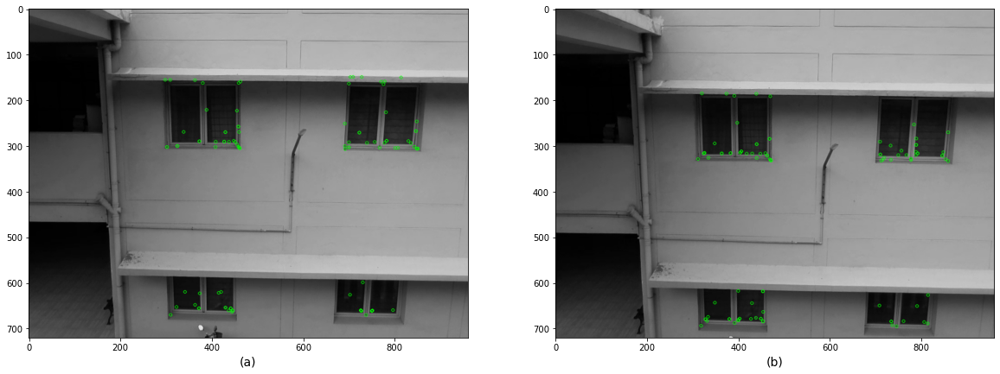

Using: bf feature matcher
Raw matches (Brute force): 57


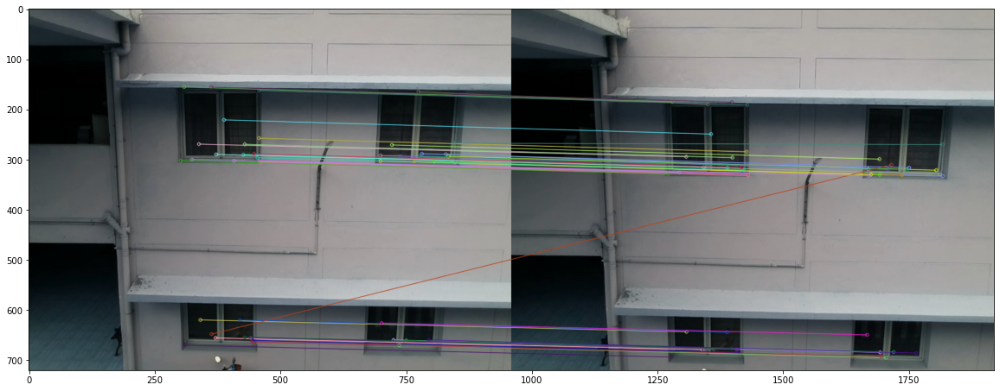

Final homography:  [[ 1.00987668e+00 -4.86984183e-03  7.18239165e+00]
 [ 4.97327842e-03  9.91334340e-01  2.69950783e+01]
 [ 8.03210298e-06 -5.40938899e-06  1.00000000e+00]]
Final inliers count:  46
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


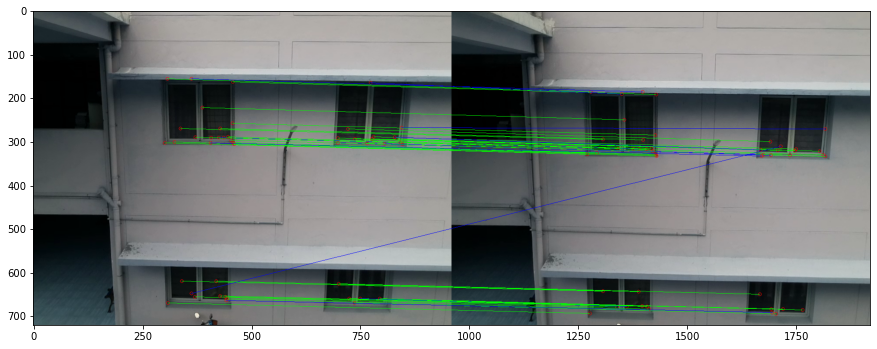

[[309.8551330566406, 669.4188232421875, 317.9208679199219, 693.1829833984375], [725.34228515625, 659.4501953125, 733.26708984375, 683.8499755859375], [437.37420654296875, 290.7546691894531, 447.2972106933594, 316.76959228515625], [458.4203186035156, 162.27381896972656, 469.0173034667969, 191.22335815429688], [408.4277038574219, 290.6133117675781, 417.51544189453125, 316.58038330078125], [429.5286865234375, 269.6692199707031, 439.2289733886719, 295.9857177734375], [338.356201171875, 269.17132568359375, 347.5444641113281, 294.4561462402344], [834.6675415039062, 293.7117614746094, 844.76171875, 321.1245422363281], [458.25909423828125, 301.94573974609375, 467.8825378417969, 328.7042541503906], [429.5286865234375, 269.6692199707031, 439.2289733886719, 295.9857177734375], [371.7261047363281, 655.0492553710938, 379.60162353515625, 678.5950317382812], [722.18798828125, 270.8322448730469, 731.8818359375, 299.0376281738281], [460.10260009765625, 303.9822082519531, 469.77130126953125, 330.7054138

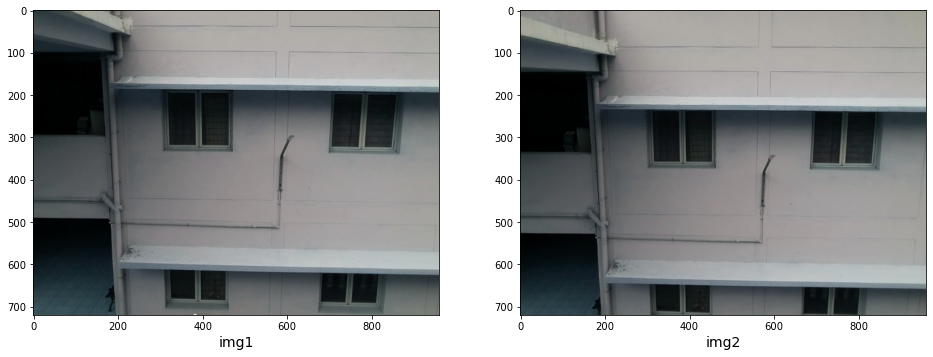

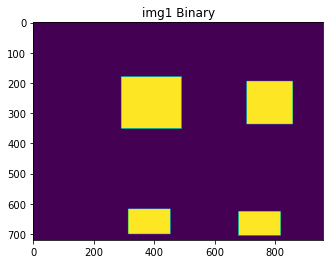

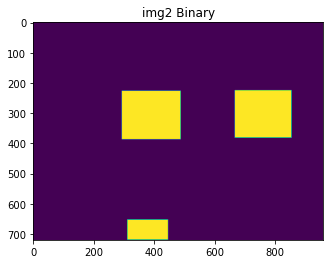

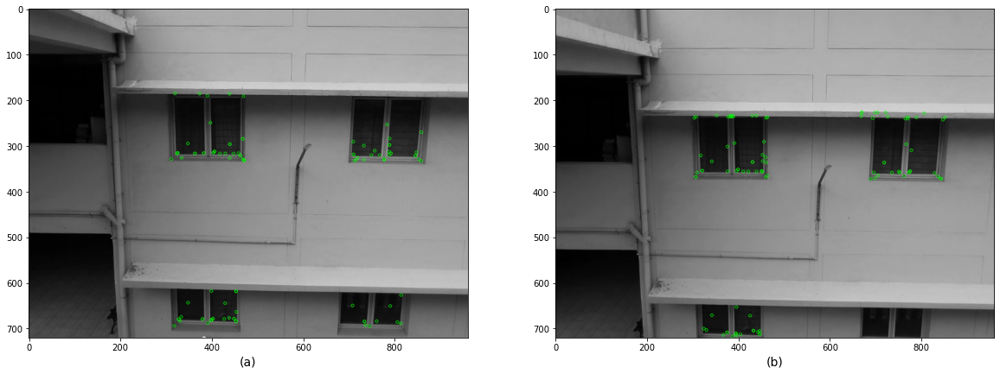

Using: bf feature matcher
Raw matches (Brute force): 52


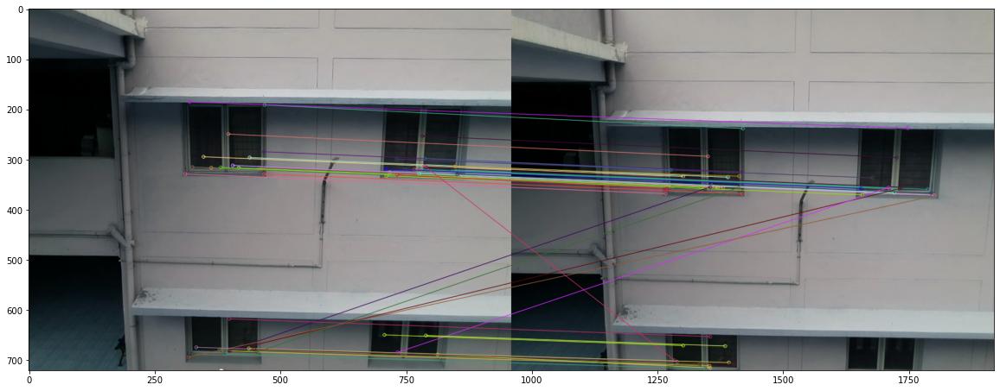

Final homography:  [[ 9.61648921e-01  8.39276830e-04  6.88997485e+00]
 [-5.95528393e-03  9.58129580e-01  5.56885952e+01]
 [-9.17500935e-06 -4.23462034e-06  1.00000000e+00]]
Final inliers count:  38
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


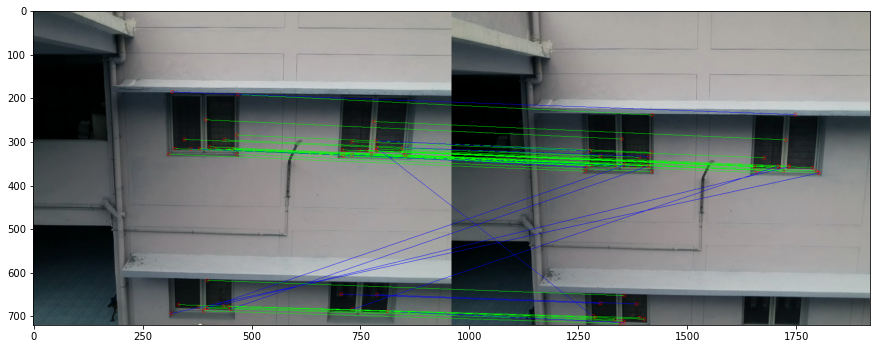

[[447.2972106933594, 316.76959228515625, 438.911376953125, 355.8698425292969], [844.76171875, 321.1245422363281, 827.8772583007812, 359.24822998046875], [717.8251342773438, 325.5898132324219, 704.0913696289062, 364.0517883300781], [766.5648803710938, 319.75848388671875, 751.5419311523438, 358.1300048828125], [439.2289733886719, 295.9857177734375, 430.38641357421875, 335.04888916015625], [458.1943359375, 315.6147766113281, 449.6786193847656, 354.5715026855469], [467.48883056640625, 284.3452453613281, 458.66351318359375, 324.881591796875], [439.2289733886719, 295.9857177734375, 430.38641357421875, 335.04888916015625], [405.83245849609375, 311.77508544921875, 398.4149475097656, 351.3837890625], [748.67724609375, 319.8599853515625, 734.4698486328125, 358.1971740722656], [405.83245849609375, 311.77508544921875, 398.4149475097656, 351.3837890625], [469.0173034667969, 191.22335815429688, 460.0924377441406, 238.2685546875], [790.8900146484375, 316.03955078125, 774.6514282226562, 355.1480712890

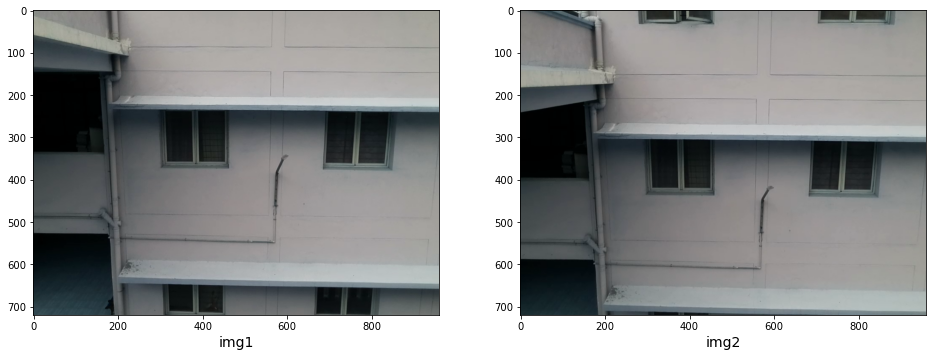

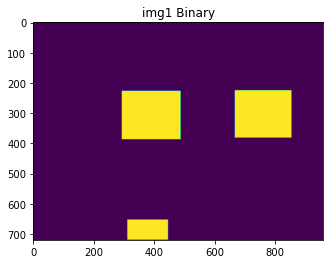

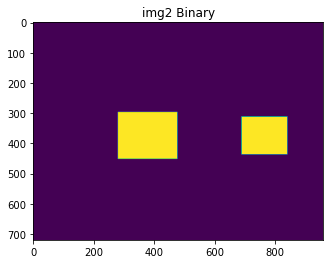

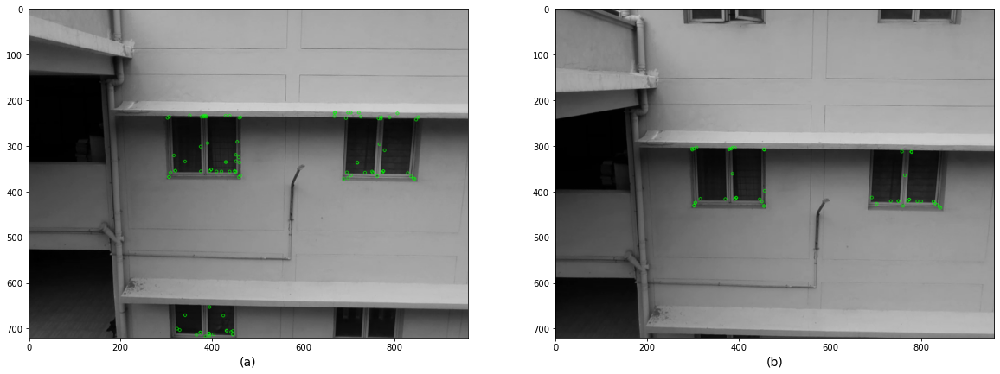

Using: bf feature matcher
Raw matches (Brute force): 31


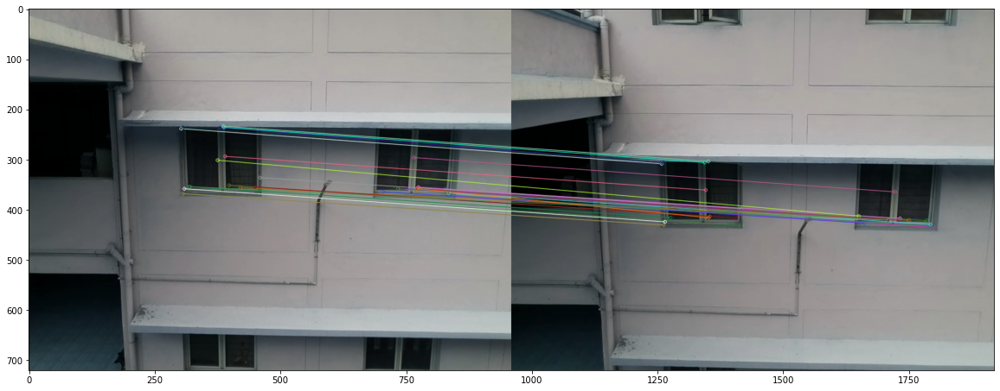

Final homography:  [[ 1.02645506e+00  7.60408051e-02 -1.83746874e+01]
 [-2.54211392e-02  1.08407836e+00  6.98536900e+01]
 [-5.72110200e-05  2.40348488e-04  1.00000000e+00]]
Final inliers count:  24
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


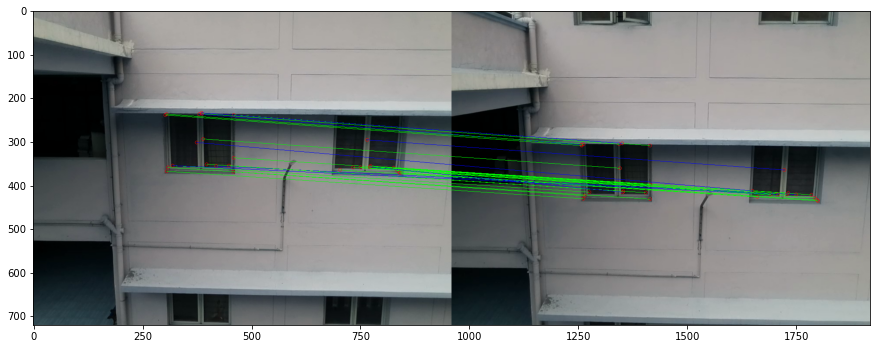

[[774.6514282226562, 355.1480712890625, 772.6184692382812, 417.1856689453125], [398.4149475097656, 351.3837890625, 394.6108703613281, 413.1759948730469], [303.0948791503906, 238.47315979003906, 298.7664794921875, 308.21685791015625], [842.9946899414062, 371.92822265625, 840.82080078125, 435.24053955078125], [827.8772583007812, 359.24822998046875, 825.6986694335938, 421.47723388671875], [774.6514282226562, 355.1480712890625, 772.6184692382812, 417.1856689453125], [398.4149475097656, 351.3837890625, 394.6108703613281, 413.1759948730469], [460.3338317871094, 336.0643005371094, 456.6648254394531, 398.0035400390625], [459.1947937011719, 368.1551208496094, 455.2781677246094, 431.3197937011719], [704.0913696289062, 364.0517883300781, 701.457763671875, 426.48577880859375], [320.2086486816406, 354.0611877441406, 316.2276916503906, 415.5240783691406], [835.4739379882812, 366.77569580078125, 833.33349609375, 428.9650573730469], [751.5419311523438, 358.1300048828125, 748.8822021484375, 420.5249328

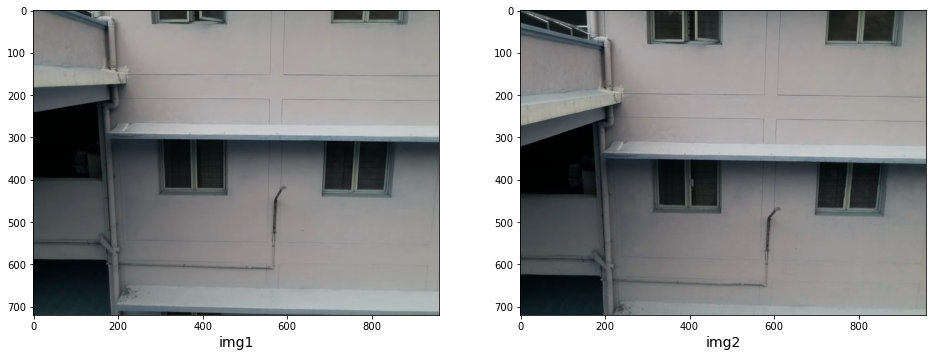

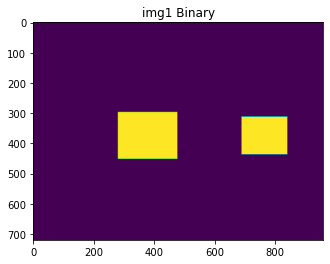

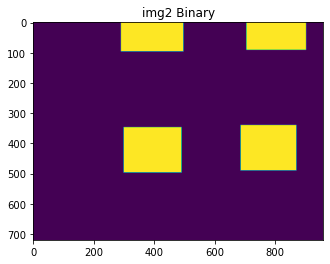

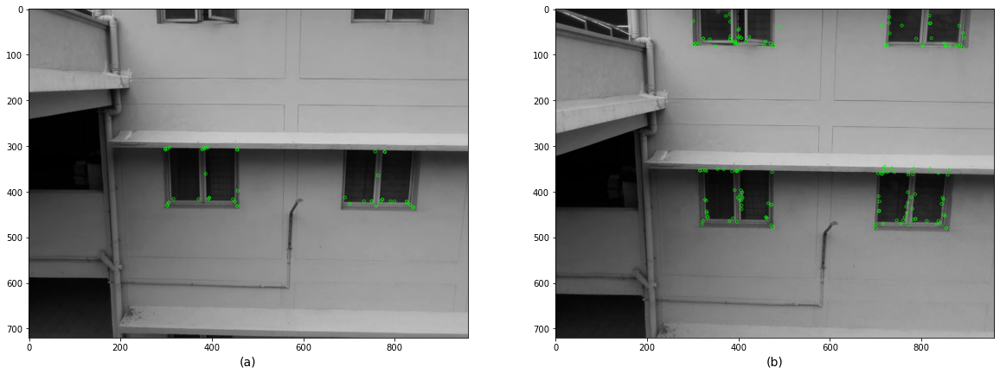

Using: bf feature matcher
Raw matches (Brute force): 32


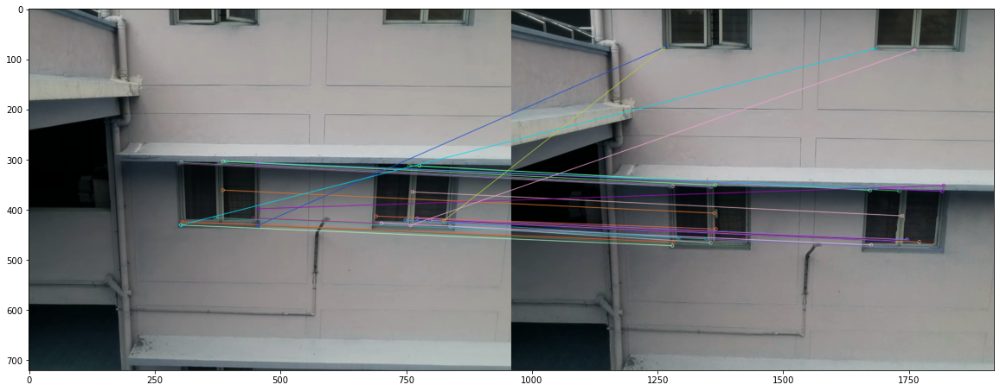

Final homography:  [[ 9.92869304e-01  4.72757408e-03  1.66525993e+01]
 [ 8.78811952e-03  9.52330183e-01  5.74404758e+01]
 [ 5.99815381e-06 -1.09150695e-05  1.00000000e+00]]
Final inliers count:  21
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


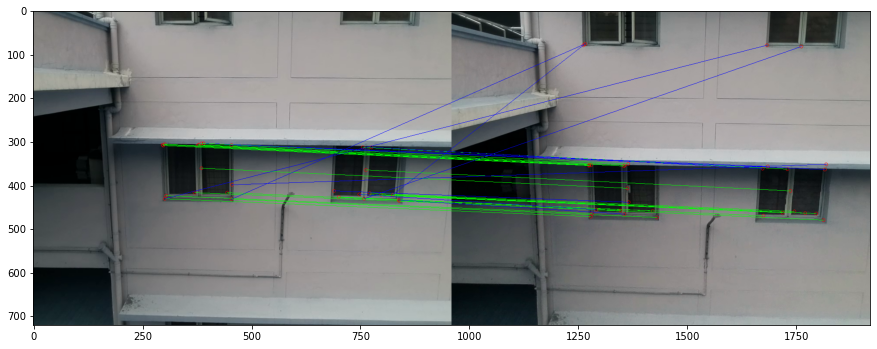

[[756.5974731445312, 312.1685791015625, 770.6893310546875, 362.426513671875], [455.2781677246094, 431.3197937011719, 471.2072448730469, 473.9513854980469], [378.85882568359375, 307.3662414550781, 395.512939453125, 355.2274169921875], [445.987548828125, 416.3533935546875, 461.60296630859375, 458.0113220214844], [701.457763671875, 426.48577880859375, 715.4450073242188, 469.97064208984375], [798.774658203125, 421.1920471191406, 811.13916015625, 463.8482666015625], [380.3753662109375, 306.48724365234375, 397.6128845214844, 353.98846435546875], [840.82080078125, 435.24053955078125, 853.28564453125, 479.1821594238281], [772.6184692382812, 417.1856689453125, 786.3731079101562, 459.3488464355469], [302.7148742675781, 305.9664611816406, 320.4801330566406, 353.1737060546875], [763.0753784179688, 364.28668212890625, 777.4144897460938, 412.05194091796875], [772.6184692382812, 417.1856689453125, 786.3731079101562, 459.3488464355469], [298.7664794921875, 308.21685791015625, 315.24139404296875, 354.1

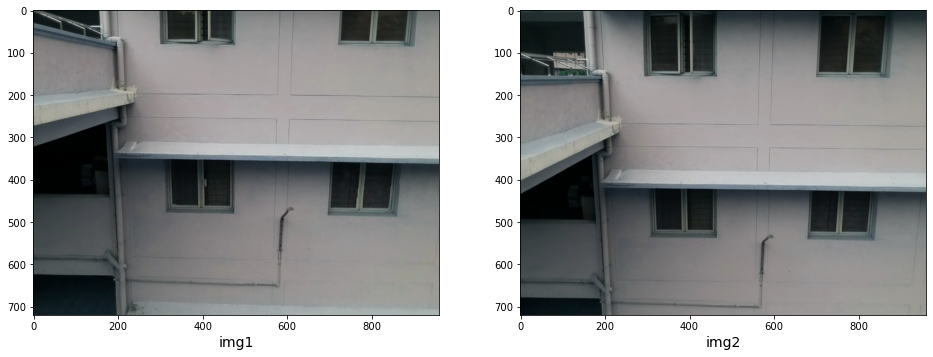

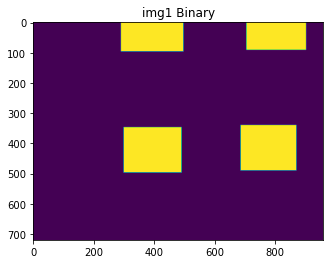

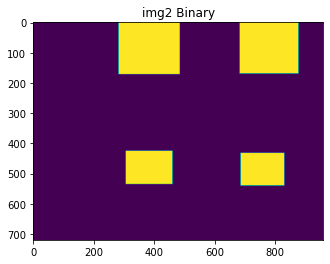

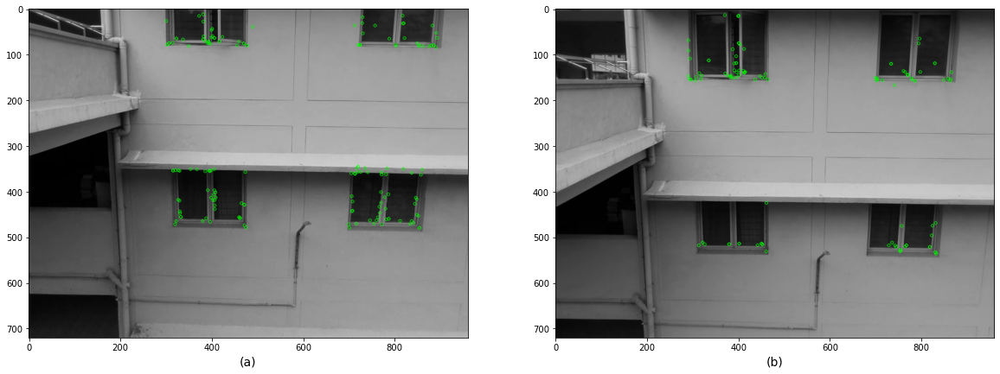

Using: bf feature matcher
Raw matches (Brute force): 55


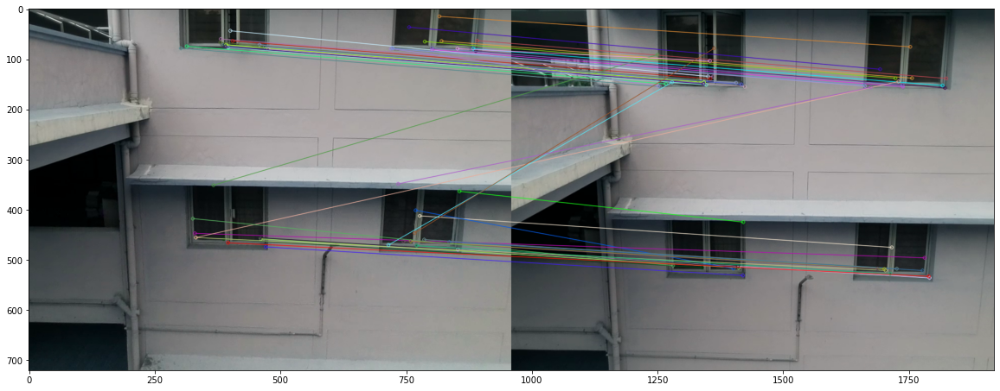

Final homography:  [[ 9.58193780e-01 -9.16912229e-04  6.23459596e+00]
 [-3.00152038e-03  9.46172249e-01  7.94809239e+01]
 [-3.95274282e-06 -1.31185420e-05  1.00000000e+00]]
Final inliers count:  38
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


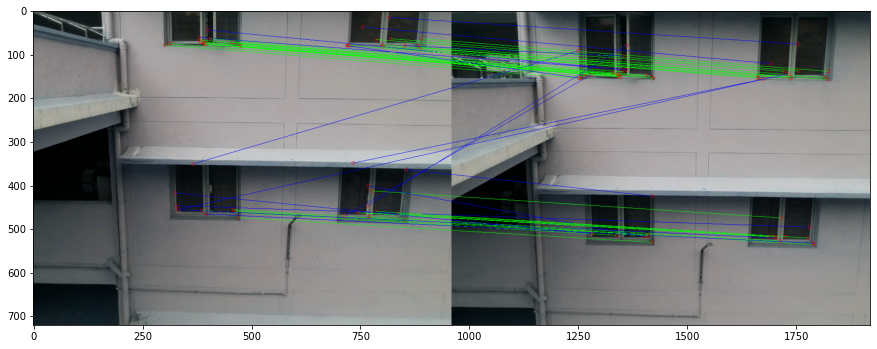

[[820.9163818359375, 63.9887809753418, 796.6079711914062, 137.94784545898438], [461.60296630859375, 458.0113220214844, 451.5986022949219, 515.39453125], [461.60296630859375, 458.0113220214844, 451.5986022949219, 515.39453125], [853.28564453125, 479.1821594238281, 831.4390869140625, 535.4808349609375], [853.28564453125, 479.1821594238281, 831.4390869140625, 535.4808349609375], [459.68658447265625, 455.80987548828125, 449.7923278808594, 513.37841796875], [459.68658447265625, 455.80987548828125, 449.7923278808594, 513.37841796875], [787.6675415039062, 65.11793518066406, 763.5865478515625, 138.1775665283203], [469.4920654296875, 75.69637298583984, 457.42010498046875, 150.3148956298828], [384.8839416503906, 70.73641204833984, 375.235595703125, 145.9688720703125], [802.0556640625, 81.27354431152344, 778.4483642578125, 154.7732391357422], [471.2072448730469, 473.9513854980469, 460.24554443359375, 530.7476196289062], [723.9072265625, 78.92676544189453, 703.2294311523438, 153.7657012939453], [3

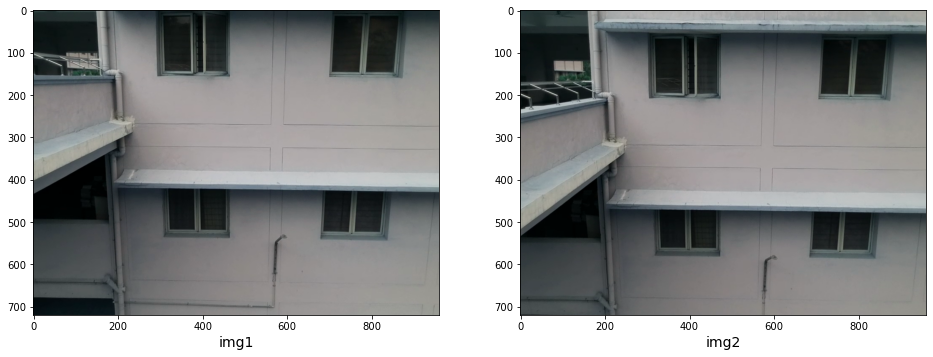

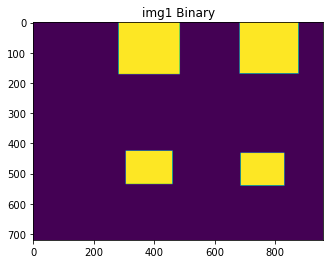

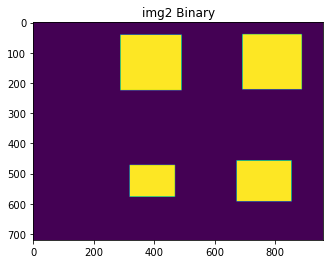

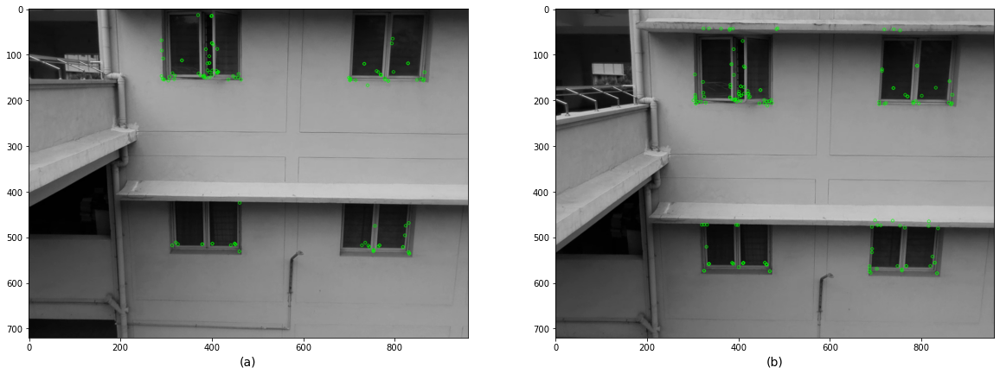

Using: bf feature matcher
Raw matches (Brute force): 67


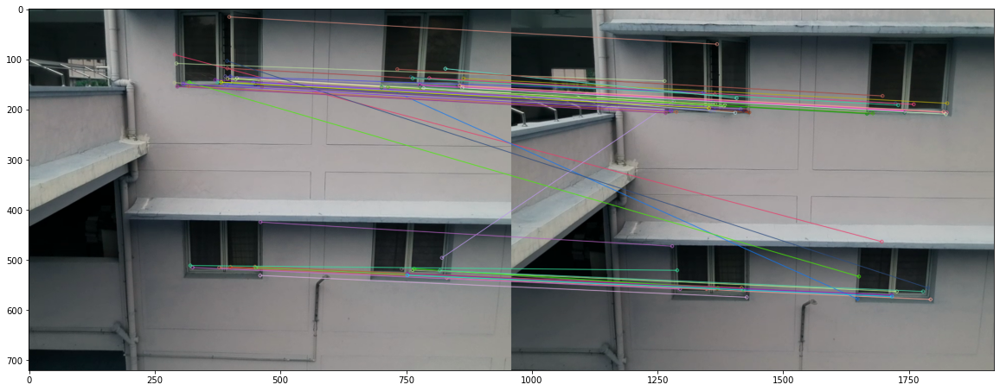

Final homography:  [[ 9.93565318e-01 -4.09807246e-03  1.36114203e+01]
 [ 5.34299321e-03  9.75543908e-01  5.34787420e+01]
 [ 4.46592503e-06  8.14777824e-07  1.00000000e+00]]
Final inliers count:  51
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


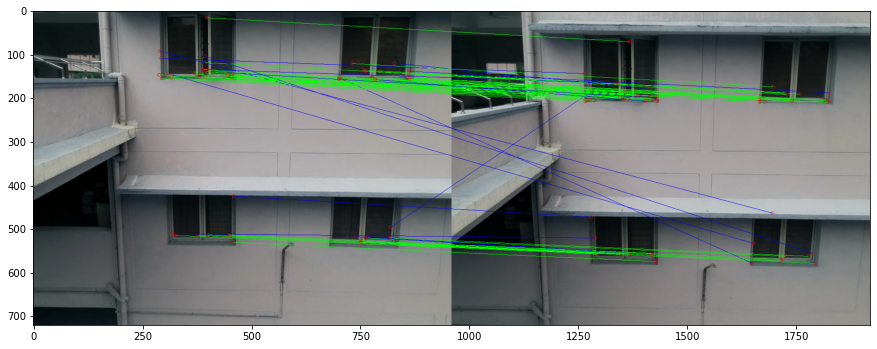

[[759.9450073242188, 135.93397521972656, 763.7403564453125, 187.9971160888672], [796.6079711914062, 137.94784545898438, 799.9434204101562, 190.07559204101562], [831.4390869140625, 535.4808349609375, 833.2890625, 578.4325561523438], [831.4390869140625, 535.4808349609375, 833.2890625, 578.4325561523438], [460.24554443359375, 530.7476196289062, 468.0218811035156, 574.0362548828125], [863.3182983398438, 153.95367431640625, 865.5028686523438, 206.44107055664062], [457.42010498046875, 150.3148956298828, 466.55218505859375, 202.27963256835938], [763.3396606445312, 520.093505859375, 766.2135620117188, 562.563232421875], [449.7923278808594, 513.37841796875, 457.2957458496094, 555.3572998046875], [394.7751770019531, 118.45555114746094, 404.5121765136719, 169.50816345214844], [325.8720397949219, 514.8656005859375, 335.2381896972656, 557.7509155273438], [395.3346252441406, 139.1405029296875, 405.1824035644531, 189.63658142089844], [401.106201171875, 513.620361328125, 409.4864196777344, 556.6102905

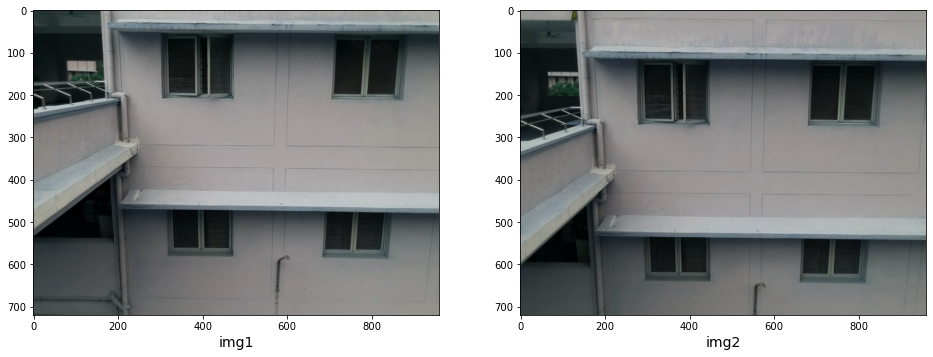

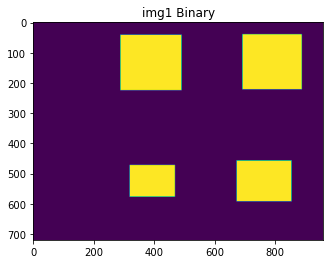

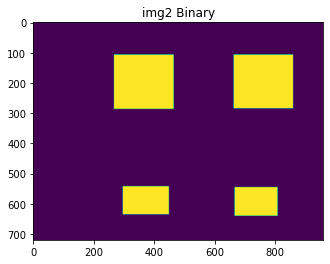

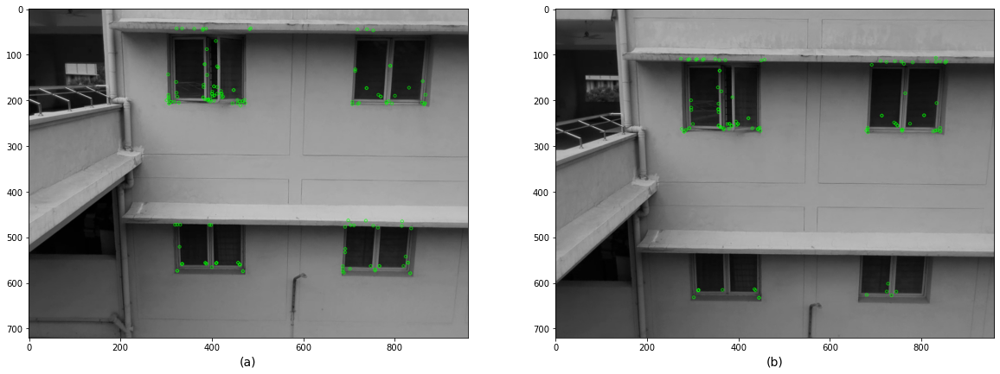

Using: bf feature matcher
Raw matches (Brute force): 66


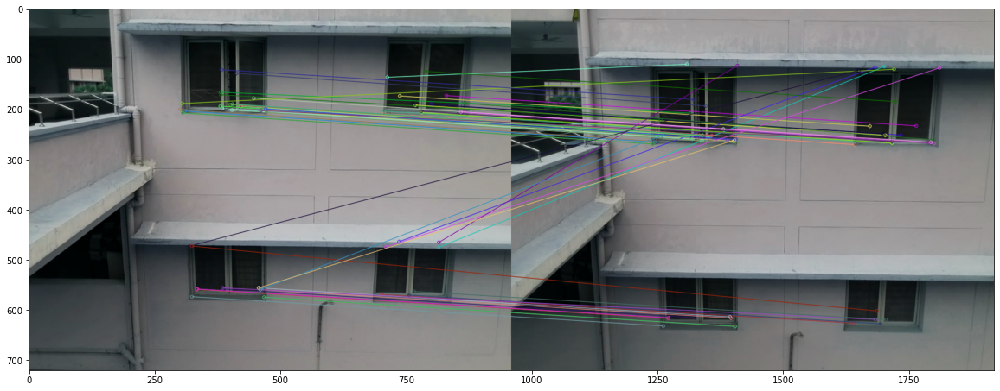

Final homography:  [[ 1.01509602e+00  1.95387147e-02 -3.36250373e+01]
 [-3.16137378e-03  1.01059670e+00  6.31447002e+01]
 [ 3.99891557e-06  2.82887861e-05  1.00000000e+00]]
Final inliers count:  50
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


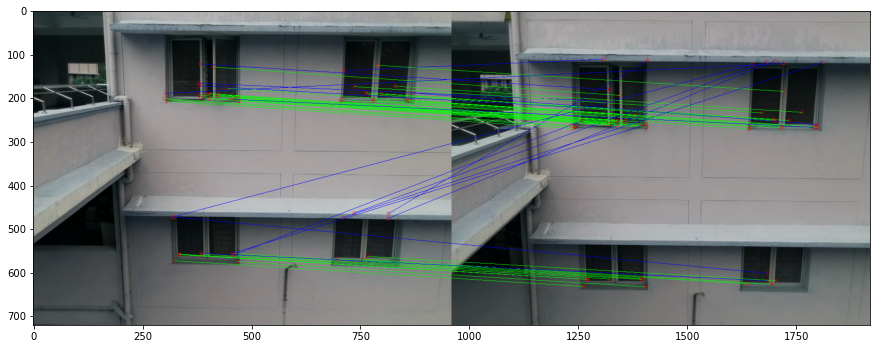

[[865.5028686523438, 206.44107055664062, 840.1566772460938, 267.858642578125], [310.2323913574219, 203.3975830078125, 284.3506164550781, 265.1639404296875], [468.0218811035156, 574.0362548828125, 444.41619873046875, 632.1636962890625], [468.0218811035156, 574.0362548828125, 444.41619873046875, 632.1636962890625], [447.59564208984375, 177.5713348388672, 421.3103942871094, 239.23731994628906], [701.8897705078125, 568.5698852539062, 679.740478515625, 625.6015625], [334.630859375, 558.385498046875, 311.6280517578125, 615.8374633789062], [799.9434204101562, 190.07559204101562, 774.2220458984375, 251.10899353027344], [769.00927734375, 191.68162536621094, 743.2911987304688, 251.4861602783203], [466.55218505859375, 202.27963256835938, 441.491943359375, 263.3622131347656], [334.630859375, 558.385498046875, 311.6280517578125, 615.8374633789062], [466.55218505859375, 202.27963256835938, 441.491943359375, 263.3622131347656], [310.2323913574219, 203.3975830078125, 284.3506164550781, 265.16394042968

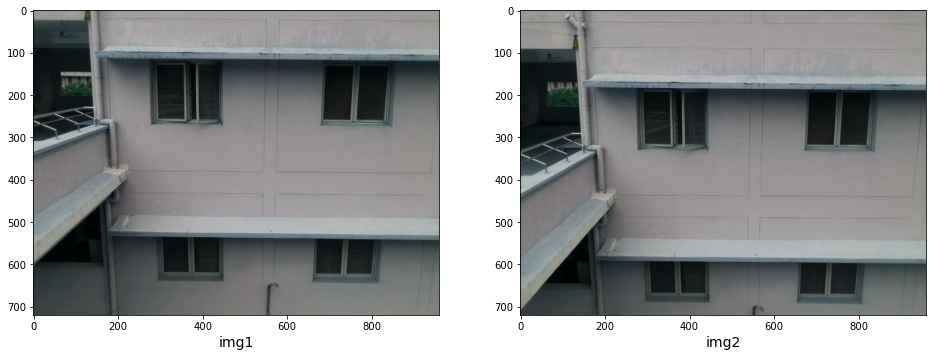

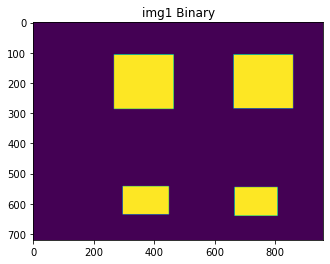

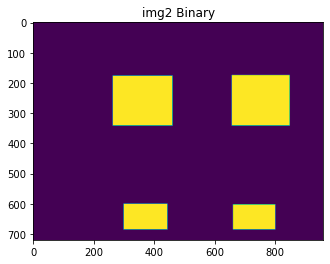

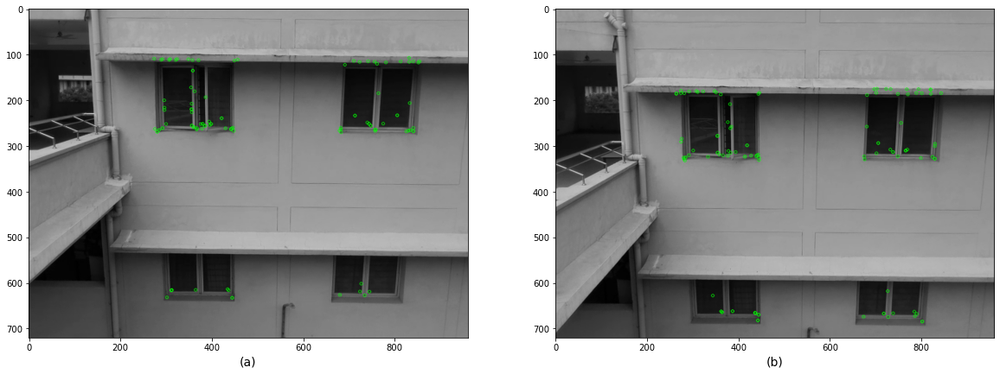

Using: bf feature matcher
Raw matches (Brute force): 59


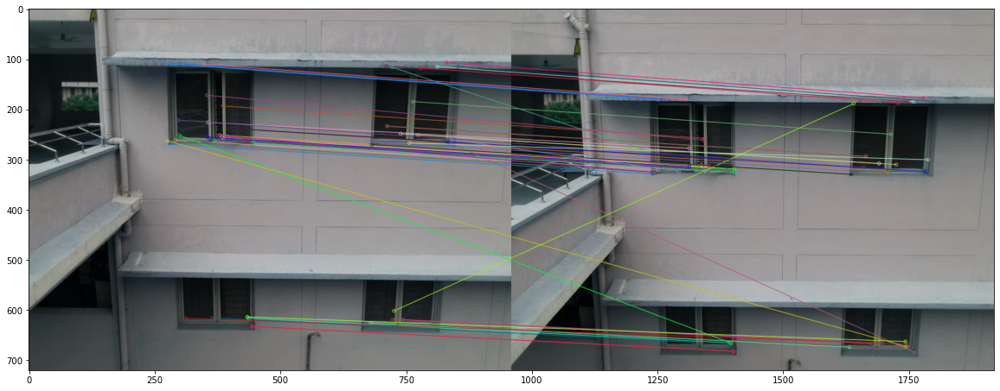

Final homography:  [[ 9.60786510e-01 -2.42863561e-02  1.15029156e+01]
 [-5.38430010e-03  9.01185378e-01  8.10347375e+01]
 [-4.95128791e-06 -7.20026025e-05  1.00000000e+00]]
Final inliers count:  41
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


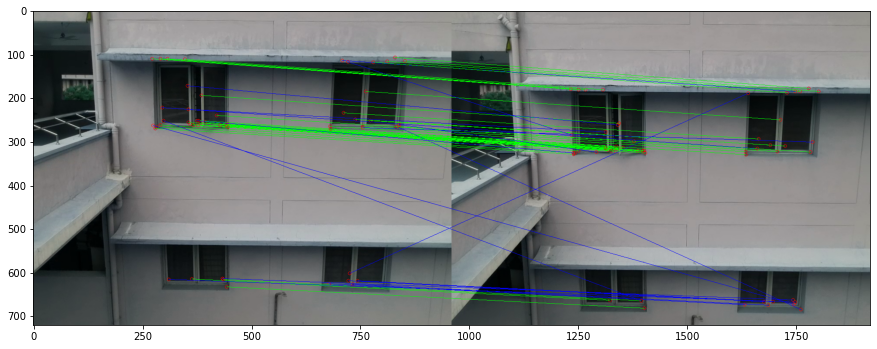

[[812.2157592773438, 115.09162139892578, 799.9671020507812, 184.5937042236328], [444.41619873046875, 632.1636962890625, 442.0141906738281, 681.5511474609375], [308.7589416503906, 109.8821029663086, 307.72265625, 180.06800842285156], [739.5848388671875, 248.66282653808594, 731.2665405273438, 307.864501953125], [774.2220458984375, 251.10899353027344, 765.1715087890625, 309.9593505859375], [284.3506164550781, 265.1639404296875, 283.7850036621094, 325.1978454589844], [441.491943359375, 263.3622131347656, 438.3041076660156, 322.553466796875], [444.41619873046875, 632.1636962890625, 442.0141906738281, 681.5511474609375], [712.6804809570312, 233.51683044433594, 704.9049682617188, 293.6122131347656], [273.8833312988281, 109.08515930175781, 273.65924072265625, 179.04164123535156], [364.70355224609375, 614.8238525390625, 363.732177734375, 663.7221069335938], [712.6804809570312, 233.51683044433594, 704.9049682617188, 293.6122131347656], [853.647705078125, 114.79098510742188, 842.2586669921875, 18

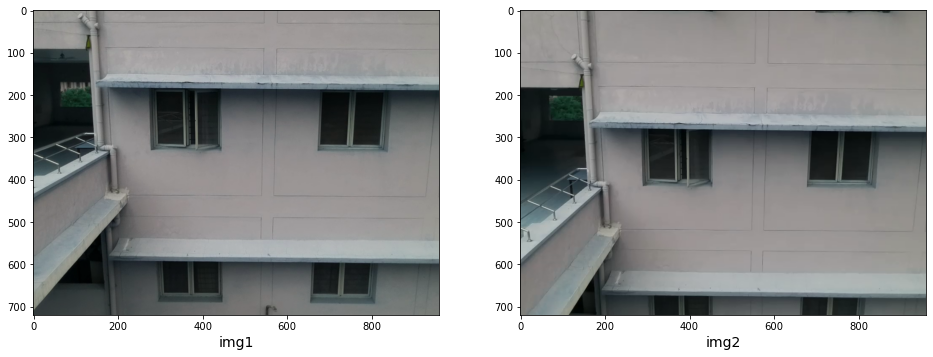

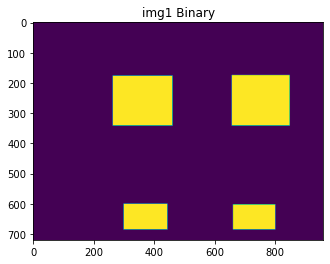

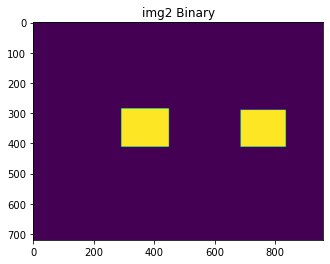

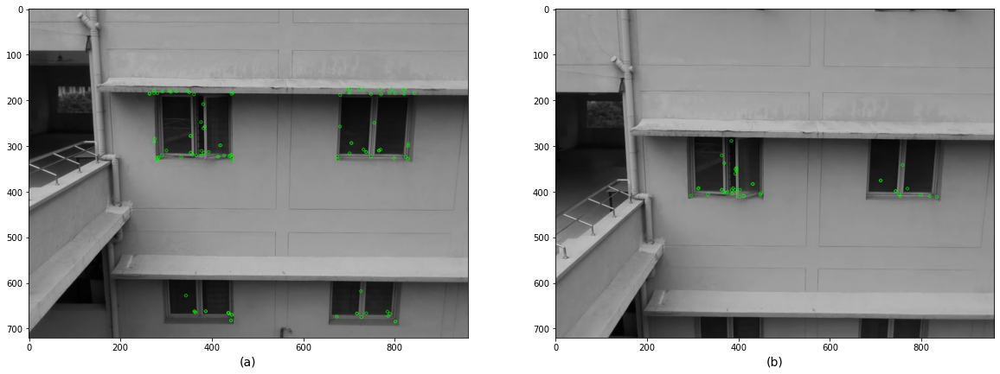

Using: bf feature matcher
Raw matches (Brute force): 31


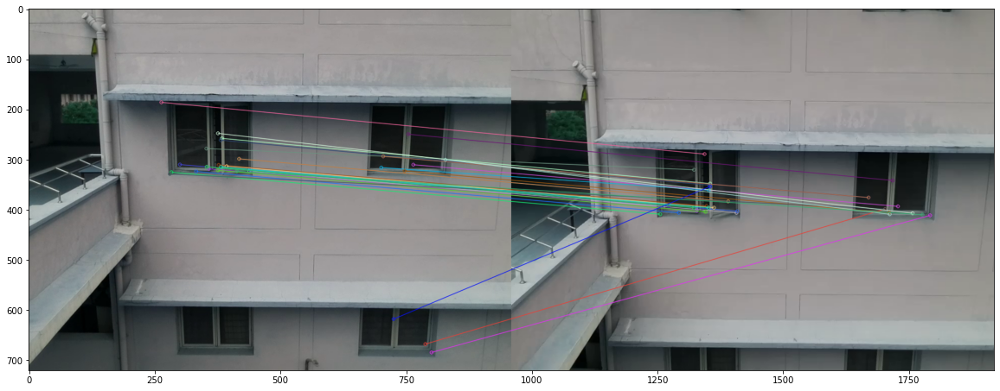

Final homography:  [[ 1.06922716e+00 -4.91492375e-02  2.81738000e+00]
 [ 3.63385416e-02  8.61019348e-01  1.17124071e+02]
 [ 9.74886924e-05 -8.61895886e-05  1.00000000e+00]]
Final inliers count:  19
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


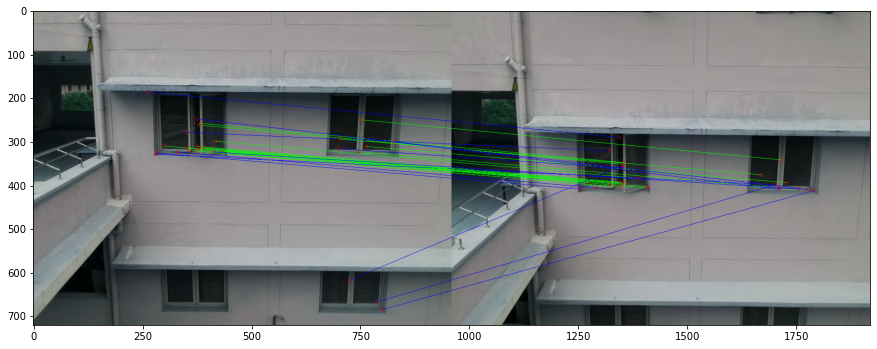

[[764.7703857421875, 310.1814270019531, 768.5326538085938, 393.1840515136719], [438.3041076660156, 322.553466796875, 447.4637145996094, 405.9748229980469], [384.1208801269531, 257.8057861328125, 394.8464660644531, 347.76275634765625], [377.6945495605469, 310.6546630859375, 387.833740234375, 392.2866516113281], [300.6759948730469, 309.9668884277344, 312.48663330078125, 392.0310974121094], [439.796630859375, 320.1002197265625, 448.8645324707031, 402.87896728515625], [704.9049682617188, 293.6122131347656, 710.185302734375, 375.5691833496094], [358.2006530761719, 318.58990478515625, 368.7133483886719, 402.1187744140625], [418.3557434082031, 298.5492858886719, 430.8744201660156, 383.3268737792969], [393.3587341308594, 313.11041259765625, 402.7534484863281, 395.80908203125], [381.68817138671875, 261.31878662109375, 392.86737060546875, 351.0804138183594], [418.3557434082031, 298.5492858886719, 430.8744201660156, 383.3268737792969], [754.693359375, 249.48434448242188, 758.02294921875, 341.5732

In [33]:

# grab the paths to the input images and initialize our images list
print("[INFO] loading images...")
imagePaths = sorted(list(paths.list_images(imgPath)))
images = []
# loop over the image paths, load each one, and add them to our
# images to stitch list
for imagePath in imagePaths:
    image = cv2.imread(imagePath, 1)
#     print(image.shape)
    images.append(image)
    print(imagePath)
    
print(images[0].shape)

windowCount = len(FinalList[0])
print("startWindowCount:", windowCount)
## MAIN LOOP ##
for i in range(len(images) - 1):
    img1 = images[i]
    img2 = images[i+1]
    
#     print(img1.shape)
    # read images and transform them to grayscale
    # Make sure that the train image is the image that will be transformed
    # Opencv defines the color channel in the order BGR 
    # Transform it to RGB to be compatible to matplotlib
    img1_gray = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
    img2_gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

    fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
    ax1.imshow(img1, cmap="gray")
    ax1.set_xlabel("img1", fontsize=14)
    ax2.imshow(img2, cmap="gray")
    ax2.set_xlabel("img2", fontsize=14)
    plt.show()
    
    ## Preparing Binary Mask and mapping bounding box coordinates
    ## COORDS1 and COORDS2 : WOULD COME FROM TEXT FILE
#     coords1 = batch_data_int[i]
#     coords1 = np.array(coords1)
#     print(coords1)
#     coords1 = coords1.reshape(-1, 2)
#     coords1 = np.reshape(coords1,(coords1.shape[0]//4 , 4, coords1.shape[1]))
    
#     coords2 = batch_data_int[i+1]
#     coords2 = np.array(coords2)
#     coords2 = coords2.reshape(-1,2)
#     coords2 = np.reshape(coords2,(coords2.shape[0]//4 , 4, coords2.shape[1]))
    
    coords1 = FinalList[i]
    coords2 = FinalList[i+1]
#     print(coords1)
    
    padding = 0
    img1_binary = prepareBinaryMask(img1_gray, coords1, padding)
    img2_binary = prepareBinaryMask(img2_gray, coords2, padding)
    plt.figure()
    plt.title('img1 Binary')
    plt.imshow(img1_binary)
    plt.show()
    plt.title('img2 Binary')
    plt.imshow(img2_binary)
    plt.show()

    ## Commented as the coords would come from recorded text File.
    ## LEFT TO DO
#     print("coords1:", coords1)
    pick1 = mapToPickv1(coords1, padding)
    pick2 = mapToPickv1(coords2, padding)
#     print("pick1:", pick1)
        
    kpsA, featuresA = detectAndDescribe(img1_gray, img1_binary, method=feature_extractor)
    kpsB, featuresB = detectAndDescribe(img2_gray, img2_binary, method=feature_extractor)
#     print('featuresA: ')
#     print(featuresA)
#     print('featuresB: ')
#     print(featuresB)
#     print((kpsA))
#     print(kpsB)
#     kpsA_dummy = np.float32([kp.pt for kp in kpsA])
#     print("kpsA: ", kpsA_dummy)
    
    # display the keypoints and features detected on both images
    fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
    ax1.imshow(cv2.drawKeypoints(img1_gray,kpsA,None,color=(0,255,0)))
    ax1.set_xlabel("(a)", fontsize=14)
    ax2.imshow(cv2.drawKeypoints(img2_gray,kpsB,None,color=(0,255,0)))
    ax2.set_xlabel("(b)", fontsize=14)
    plt.show()
    
    # Match Feature Points
    print("Using: {} feature matcher".format(feature_matching))
    fig = plt.figure(figsize=(20,8))
    if feature_matching == 'bf':
        matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
        img3 = cv2.drawMatches(img1,kpsA,img2,kpsB,matches,
                               None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    elif feature_matching == 'knn':
        matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.75, method=feature_extractor)
        img3 = cv2.drawMatches(img1,kpsA,img2,kpsB,np.random.choice(matches,100),
                               None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img3)
    plt.show()
    
    ## Calculating homography and rejecting outliers
    correspondenceList = []
    estimation_thresh = 0.75
    for match in matches:
        (x1, y1) = kpsA[match.queryIdx].pt
        (x2, y2) = kpsB[match.trainIdx].pt
        correspondenceList.append([x1, y1, x2, y2])

    corrs = np.matrix(correspondenceList)
#     print("Correspondences:", corrs)
    #run ransac algorithm
    finalH, inliers = ransac(corrs, estimation_thresh)
    print("Final homography: ", finalH)
    print("Final inliers count: ", len(inliers))
#     print("Inliers: " +  str(inliers))
    img3 = drawMatches(img1,kpsA,img2,kpsB, matches, inliers)
    plt.figure(figsize=(15,15))
    plt.imshow(img3)
    plt.show()

    ## Converting to numpy array = INLIERS
    inliers_Arr = np.array(inliers)
    inliers = np.squeeze(inliers_Arr, axis = 1).tolist()
    print(inliers)
    
    print("pick1:", pick1)
    print("pick2:", pick2)
    newWindows, newWindowsCount = calculateUnMatchedWindows(inliers, pick1, pick2)
    windowCount += newWindowsCount

print('Total windows are:', windowCount)

# Approach 2: Counting Windows using an approximate 3D plane

## Pasting windows on an approximate 3D plane using Triangulation

In [33]:
## INITIALIZED VARIABLES
verticalPlane = np.zeros((1500,1000,3),np.uint8)
imgPath = "F:\\IIIT-H Work\\win_det_heatmaps\\datasets\\IIIT-H Dataset\\Bakul-All\\002\\images\\"
coordFilePath = '..\\win_det_heatmaps\coordinatesFromPostProcessing-2-shufflenet.csv'
verticalPlaneCopy = np.copy(verticalPlane)
focalLength = 920 # in pixels
depth = 700 # in cm
nmsThresh = 0

## HEIGHT INFO OF SEQUENCE
# height_info_1 = [60, 110, 230, 330, 380, 420, 450, 480, 510, 530, 560, 580, 590, 600, 610, 670, 750, 780, 800, 850, 910, 950, 1000]
# height_info_5 = [170, 220, 350, 420, 500, 560, 640, 700, 740, 800, 860, 910, 960, 1000]
# height_info_4 = [90, 160, 210, 270, 330, 380, 400, 520, 580, 620, 650, 700, 760, 840, 890, 940, 980, 1000]
height_info = [50, 90, 140, 200, 230, 310, 340, 360, 420, 450, 510, 590, 640, 670, 720, 750, 780, 810, 920, 950, 970, 990]
# height_info_3 = [70, 120, 150, 170, 200, 310, 330, 390, 430, 470, 500, 520, 550, 600, 630, 690, 720, 750, 800, 860]
# height_info_2new = [160, 240, 330, 500, 580, 660, 730, 740, 910]
print("Height Info Size:", len(height_info))

Height Info Size: 22


## Loading Coords from CSV File & Mapping to all 4 coords of Windows logic

In [34]:
def loadCoordsFromCSV(filePath):
    with open(filePath, newline='') as f:
        csvread = csv.reader(f)
#         print(csvread)
        batch_data = list(csvread)

    batch_data_int = []
    for inner_list in batch_data:
        innet_out_list = []
        for string in inner_list:
            innet_out_list.append(int(float(string)))
        batch_data_int.append(innet_out_list)

    FinalList = []
    for i in range(len(batch_data_int)):
        el = batch_data_int[i]
        elChunks = [el[x:x+4] for x in range(0, len(el), 4)]
        newElChunks = elChunks.copy()
        for i in range(len(elChunks)):
            chunk = elChunks[i]
            newChunk = chunk.copy()

            newChunk.insert(2, chunk[0])
            newChunk.insert(3, chunk[3])
            newChunk.insert(6, chunk[2])
            newChunk.insert(7, chunk[1])
            newElChunks[i] = newChunk
        perImageCoords = np.array(newElChunks)
        perImageCoords = perImageCoords.reshape(-1,4,2)
        FinalList.append(perImageCoords)

    print("Final list:", FinalList)
    print("Final list size:", len(FinalList))
    return FinalList

## Here input is in form of list of sX, sY, eX, eY
## Eg: input = [[[s1,s2, e1,e2], [s1, s2, e1, e2]],   [[s3,s4,e3,e4],[s3,s4,e3,e4]]]
def mapToAll4Coords(input):
    inputInListOfLists = [arr.tolist() for arr in input]
    finalListMappedWithAll4Coords = []
    for image in inputInListOfLists:
        finalSubList = []
        imageClone = image.copy()
        for i in range(len(image)):
            window = image[i]
            windowClone = window.copy()
            windowClone.insert(2, window[0])
            windowClone.insert(3, window[3])
            windowClone.insert(6, window[2])
            windowClone.insert(7, window[1])
            imageClone[i] = windowClone
        perImageCoords = np.array(imageClone)
        perImageCoords = perImageCoords.reshape(-1,4,2)
        finalListMappedWithAll4Coords.append(perImageCoords)
    
    return finalListMappedWithAll4Coords

In [35]:
## Eg to test mapToAll4Coords()
input = [np.array([[107, 225, 255, 332]]), np.array([[100, 295, 255, 407]]), np.array([[125, 455, 275, 550], [92, 17, 255, 165]])]

input_Arr = np.array(input)
print(input_Arr)
mapped4Coords = mapToAll4Coords(input)
print(mapped4Coords)
print(mapped4Coords[0].shape)

[array([[107, 225, 255, 332]]) array([[100, 295, 255, 407]])
 array([[125, 455, 275, 550],
        [ 92,  17, 255, 165]])]
[array([[[107, 225],
        [107, 332],
        [255, 332],
        [255, 225]]]), array([[[100, 295],
        [100, 407],
        [255, 407],
        [255, 295]]]), array([[[125, 455],
        [125, 550],
        [275, 550],
        [275, 455]],

       [[ 92,  17],
        [ 92, 165],
        [255, 165],
        [255,  17]]])]
(1, 4, 2)


<ipython-input-35-5cd3c0c6618f>:4: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  input_Arr = np.array(input)


In [36]:
## Loading coords from CSV File
FinalList = loadCoordsFromCSV(coordFilePath)

Final list: [array([[[283,   0],
        [283, 155],
        [473, 155],
        [473,   0]],

       [[689,   0],
        [689, 147],
        [876, 147],
        [876,   0]]]), array([[[313,  32],
        [313, 205],
        [508, 205],
        [508,  32]],

       [[706,  22],
        [706, 202],
        [899, 202],
        [899,  22]]]), array([[[325, 100],
        [325, 272],
        [515, 272],
        [515, 100]],

       [[719,  97],
        [719, 265],
        [904, 265],
        [904,  97]],

       [[  0, 105],
        [  0, 242],
        [115, 242],
        [115, 105]]]), array([[[333, 167],
        [333, 332],
        [520, 332],
        [520, 167]],

       [[719, 157],
        [719, 325],
        [907, 325],
        [907, 157]],

       [[  0, 167],
        [  0, 300],
        [127, 300],
        [127, 167]]]), array([[[374, 195],
        [374, 352],
        [474, 352],
        [474, 195]],

       [[695, 217],
        [695, 347],
        [840, 347],
        [840, 217]],


## Plane Mapping, NMS and Storey Logic Functions

In [43]:
# FOV = 82.6 degrees, imgDim = 720*960, FocalLength = 410 pixels

def mapToVerticalPlane(focalLength, depth, boundingBoxes, height, verticalPlane, img):
    mappedBoundingBoxes = []
    heightOfPlane = verticalPlane.shape[0]
    h, w, c = img.shape
    for box in boundingBoxes:
        sX, sY, eX, eY = box
        print(box)
        
        sY = h/2 - sY
        eY = h/2 - eY
        mappedSX, mappedSY, mappedEX, mappedEY = sX, int(heightOfPlane - ((sY*depth/focalLength) + height)), eX, int(heightOfPlane - ((eY*depth/focalLength) + height))
        
        print("mapped:" + str(mappedSX) + " " +  str(mappedSY)  + " " + str(mappedEX) + " " + str(mappedEY))
#         verticalPlane[mappedSY:mappedEY, mappedSX:mappedEX] = [255,255,255]
        cv2.rectangle(verticalPlane, (mappedSX, mappedSY), (mappedEX, mappedEY), (255, 255, 255), 4)
        
        mappedBoundingBoxes.append((mappedSX, mappedSY, mappedEX, mappedEY))
    return mappedBoundingBoxes
        

def non_max_suppression_fast(boxes, overlapThresh):
    # if there are no boxes, return an empty list
    if len(boxes) == 0:
        return []
    # if the bounding boxes integers, convert them to floats --
    # this is important since we'll be doing a bunch of divisions
    if boxes.dtype.kind == "i":
        boxes = boxes.astype("float")
    # initialize the list of picked indexes	
    pick = []
    # grab the coordinates of the bounding boxes
    x1 = boxes[:,0]
    y1 = boxes[:,1]
    x2 = boxes[:,2]
    y2 = boxes[:,3]
    # compute the area of the bounding boxes and sort the bounding
    # boxes by the bottom-right y-coordinate of the bounding box
    area = (x2 - x1 + 1) * (y2 - y1 + 1)
    idxs = np.argsort(y2)
    # keep looping while some indexes still remain in the indexes
    # list
    while len(idxs) > 0:
        # grab the last index in the indexes list and add the
        # index value to the list of picked indexes
        last = len(idxs) - 1
        i = idxs[last]
        pick.append(i)
        # find the largest (x, y) coordinates for the start of
        # the bounding box and the smallest (x, y) coordinates
        # for the end of the bounding box
        xx1 = np.maximum(x1[i], x1[idxs[:last]])
        yy1 = np.maximum(y1[i], y1[idxs[:last]])
        xx2 = np.minimum(x2[i], x2[idxs[:last]])
        yy2 = np.minimum(y2[i], y2[idxs[:last]])
        # compute the width and height of the bounding box
        w = np.maximum(0, xx2 - xx1 + 1)
        h = np.maximum(0, yy2 - yy1 + 1)
        # compute the ratio of overlap
        overlap = (w * h) / area[idxs[:last]]
#         print("overlap: ", overlap)
        # delete all indexes from the index list that have
        idxs = np.delete(idxs, np.concatenate(([last],
            np.where(overlap > overlapThresh)[0])))
    # return only the bounding boxes that were picked using the
    # integer data type
    return boxes[pick].astype("int")

############### Calculating storey #####################
def calculateStoreys(coords, heightOfPlane = 1500):
    yTop = coords[:,1]
    yBottom = coords[:,3]
    yAvg = (yTop + yBottom)/2
    storeyCount = 1 if len(coords) > 0 else 0
    index = 0
    storeyHeights = [heightOfPlane - yAvg[0]] if len(coords) > 0 else []
#     print('yTop:', yTop)
#     print('yAvg:', yAvg)
#     print('yBottom:', yBottom)    
    print('yAvg Heights:', heightOfPlane - yAvg)

    singleStoreyHeight = []
    avgStoreyHeights = []
    
    for i in range(len(coords)):
        if (((yAvg[index] > yTop[i]) and (yAvg[index] < yBottom[i])) or 
            ((yTop[index] > yTop[i]) and (yTop[index] < yBottom[i]))  or
            ((yBottom[index] > yTop[i]) and (yBottom[index] < yBottom[i]))):
            singleStoreyHeight.append(heightOfPlane - yAvg[i])
            continue
        else:
            avgStoreyHeights.append(sum(singleStoreyHeight)/len(singleStoreyHeight))
            singleStoreyHeight = []
            index = i
            storeyCounted = False
            for j in range(i):  
                if (((yAvg[index] > yTop[j]) and (yAvg[index] < yBottom[j])) or 
                    ((yTop[index] > yTop[j]) and (yTop[index] < yBottom[j])) or
                    ((yBottom[index] > yTop[j]) and (yBottom[index] < yBottom[j]))):
                    storeyCounted = True
                    break
            if(storeyCounted == False):
                storeyHeights.append(heightOfPlane - yAvg[index])
                singleStoreyHeight.append(heightOfPlane - yAvg[i])
                storeyCount+=1
                
    avgStoreyHeights.append(sum(singleStoreyHeight)/len(singleStoreyHeight))
    print('avgStoreyHeights: ', avgStoreyHeights)
    print('StoreyCount after running post processing module: ', storeyCount)
    print("storeyHeights are:", storeyHeights)
    return storeyCount, storeyHeights, avgStoreyHeights

def plotBoxes(verticalPlane, boxes):
    for box in boxes:
        sX, sY, eX, eY = box
        cv2.rectangle(verticalPlane, (sX, sY), (eX, eY), (255, 255, 255), 4)
    
    fig, ax1 = plt.subplots(nrows=1, ncols=1, constrained_layout=False, figsize=(25, 500))
    ax1.imshow(verticalPlane, cmap="gray")
    ax1.set_xlabel("PLANE", fontsize=14)
    plt.show()

## Running Vertical Plane Mapping

[INFO] loading images...
imgPathDir:F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\002\images\
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\002\images\Bakul_002_000050.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\002\images\Bakul_002_000090.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\002\images\Bakul_002_000140.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\002\images\Bakul_002_000200.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\002\images\Bakul_002_000230.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\002\images\Bakul_002_000310.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\002\images\Bakul_002_000340.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\002\images\Bakul_002_000360.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\002\images\Bakul_002_000420.png
F:\I

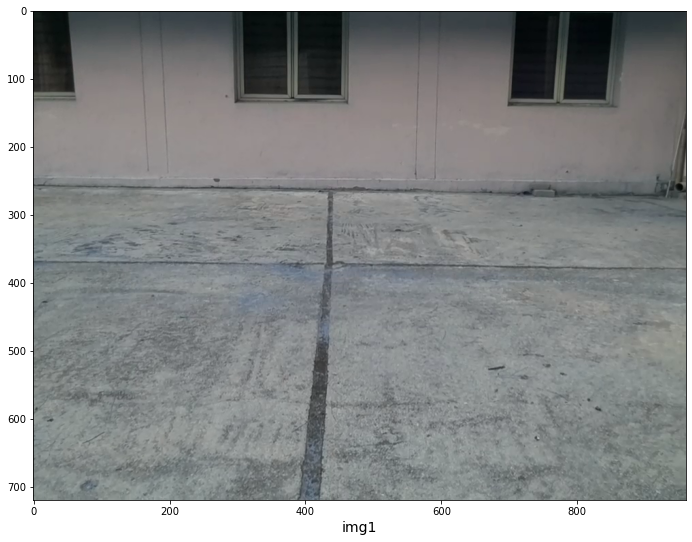

[283, 0, 473, 155]
mapped:283 1176 473 1294
[689, 0, 876, 147]
mapped:689 1176 876 1287


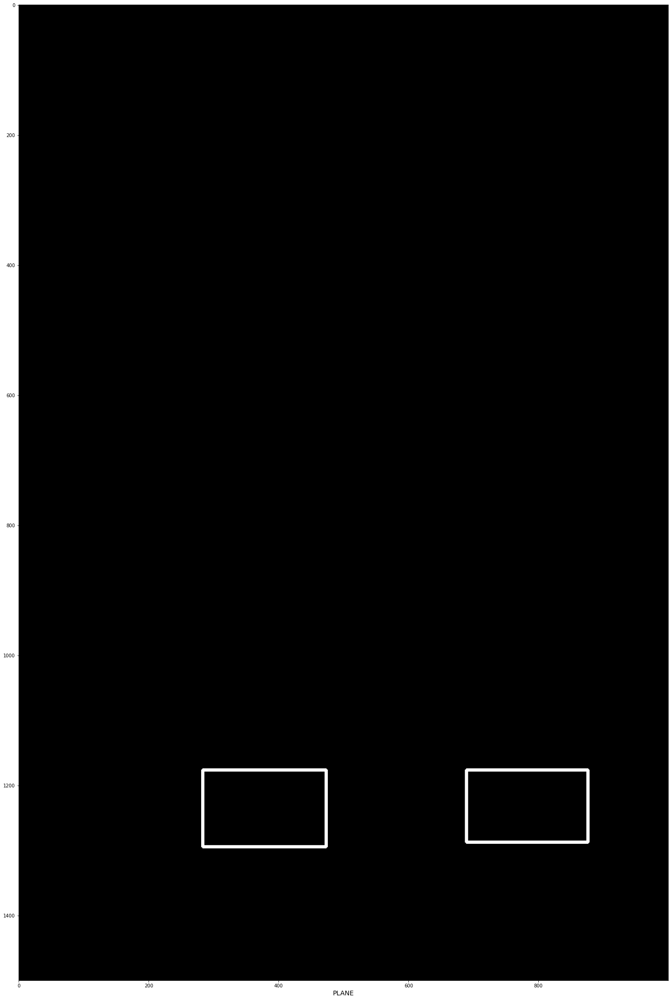

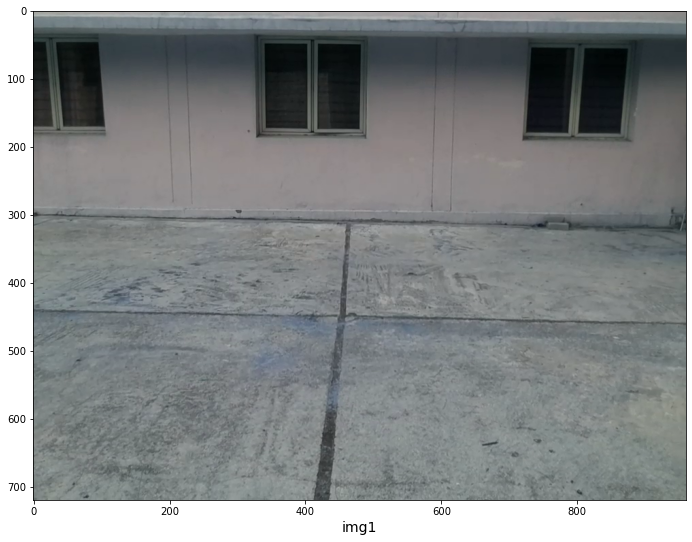

[313, 32, 508, 205]
mapped:313 1160 508 1292
[706, 22, 899, 202]
mapped:706 1152 899 1289


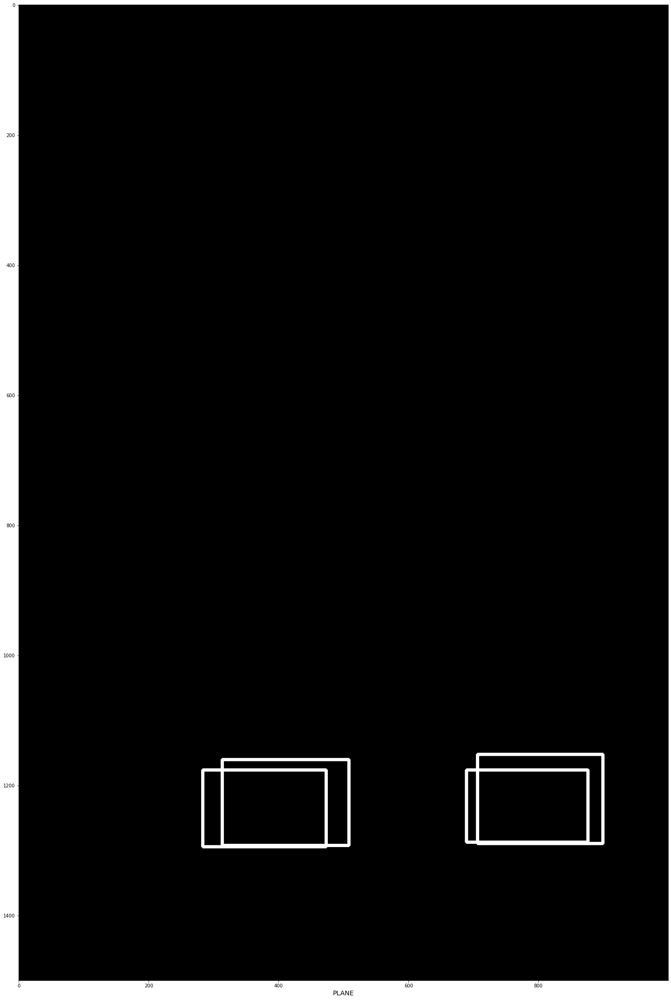

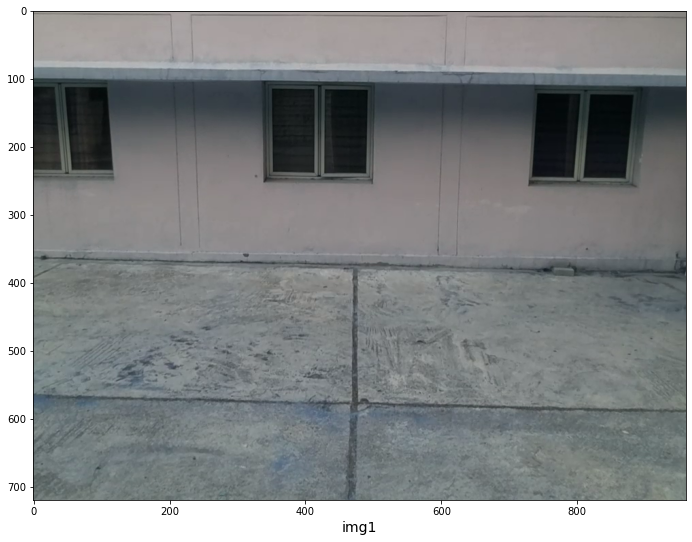

[325, 100, 515, 272]
mapped:325 1162 515 1293
[719, 97, 904, 265]
mapped:719 1159 904 1287
[0, 105, 115, 242]
mapped:0 1165 115 1270


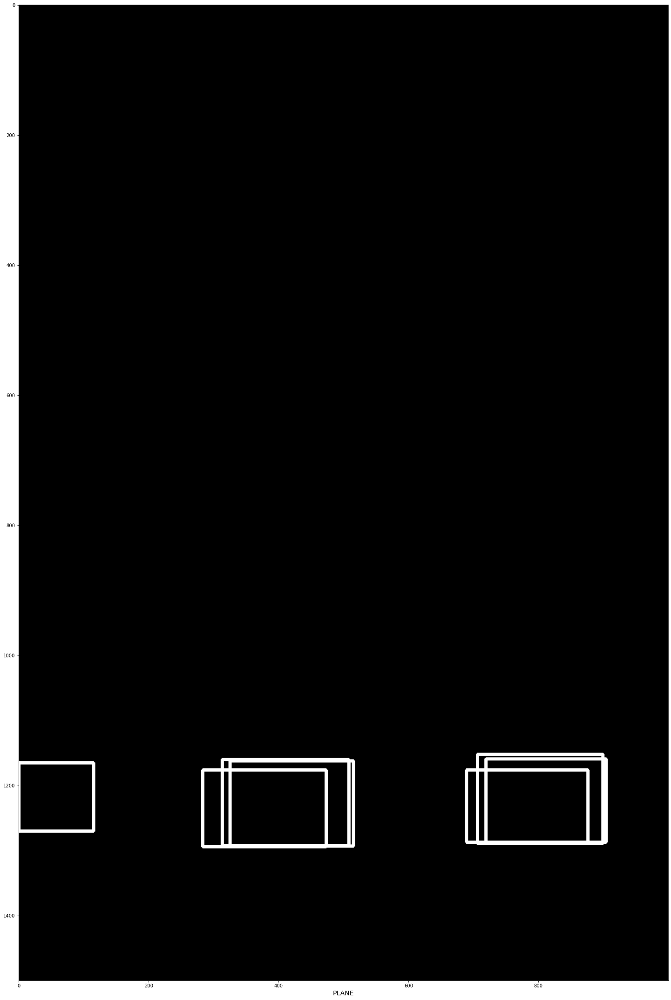

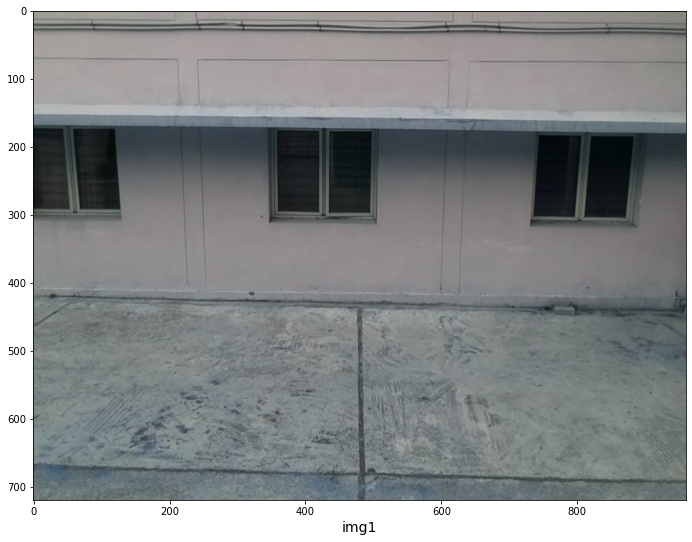

[333, 167, 520, 332]
mapped:333 1153 520 1278
[719, 157, 907, 325]
mapped:719 1145 907 1273
[0, 167, 127, 300]
mapped:0 1153 127 1254


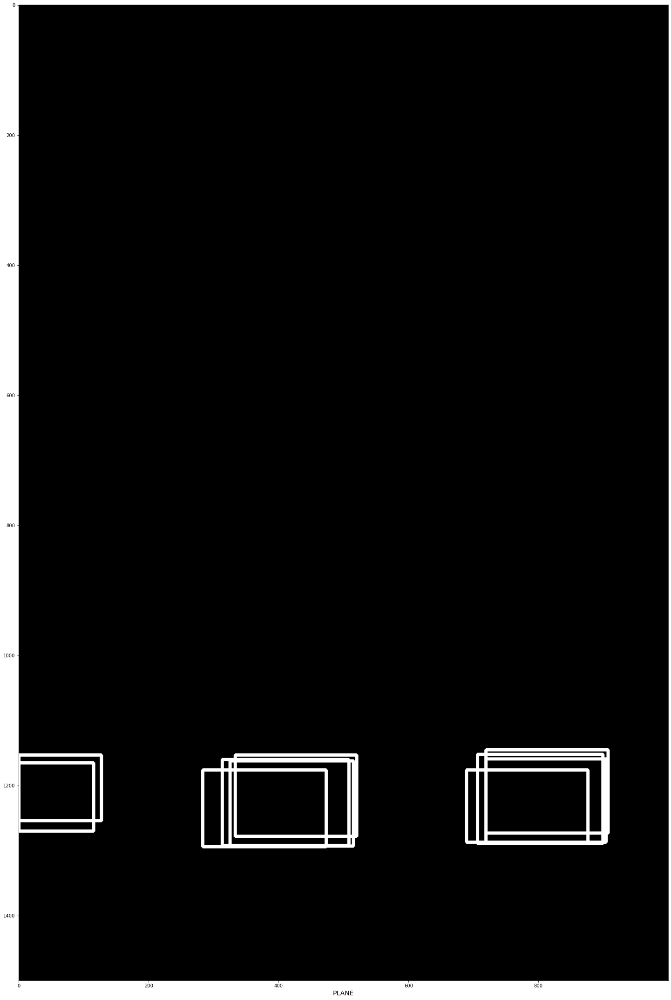

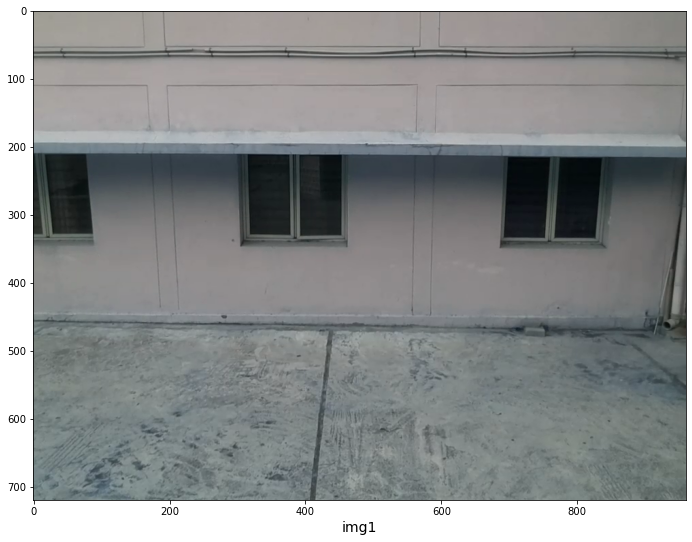

[374, 195, 474, 352]
mapped:374 1144 474 1263
[695, 217, 840, 347]
mapped:695 1161 840 1260
[0, 210, 85, 337]
mapped:0 1155 85 1252


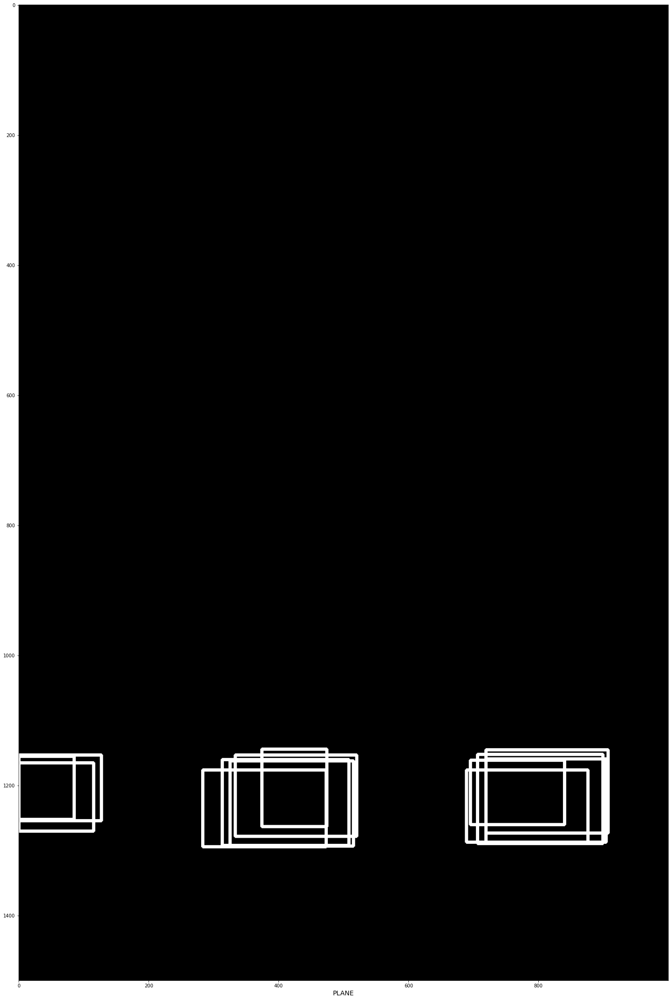

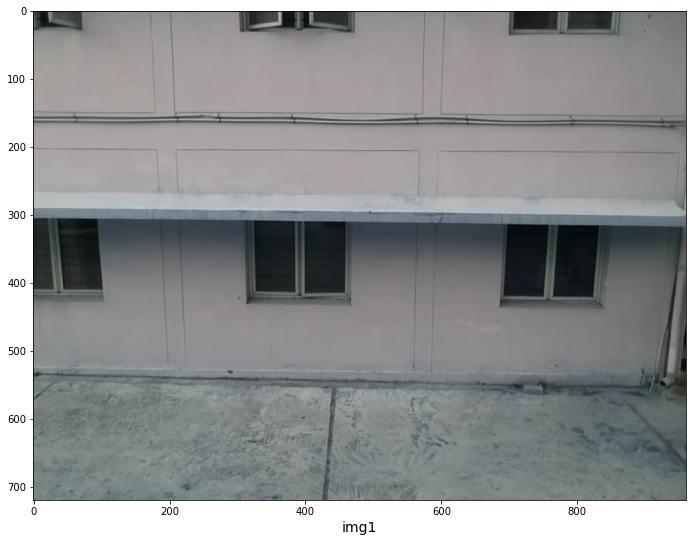

[298, 302, 483, 447]
mapped:298 1145 483 1256
[677, 297, 857, 445]
mapped:677 1142 857 1254
[0, 307, 95, 422]
mapped:0 1149 95 1237


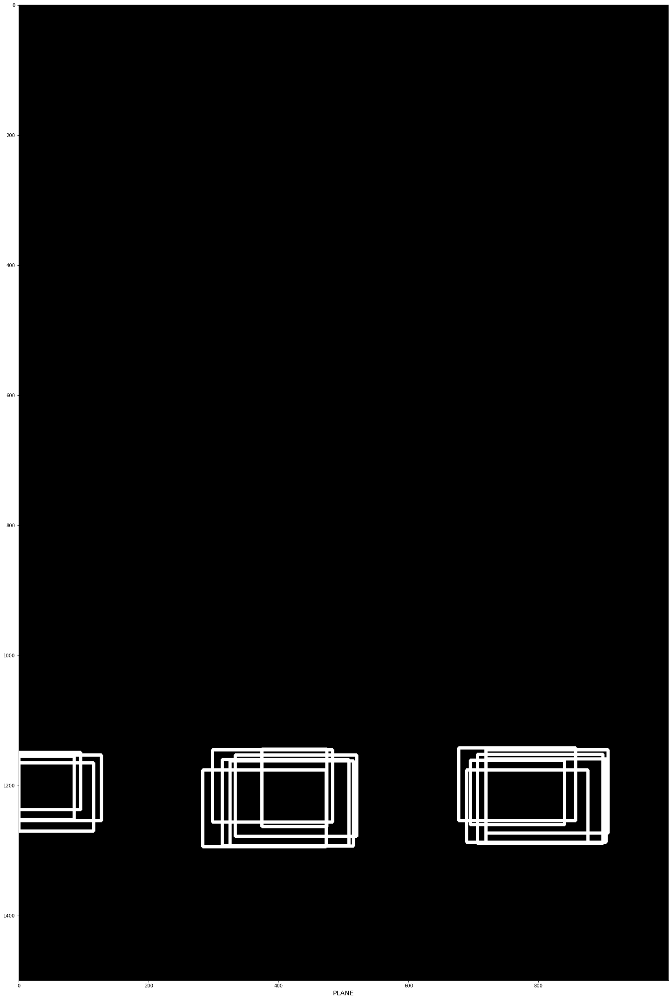

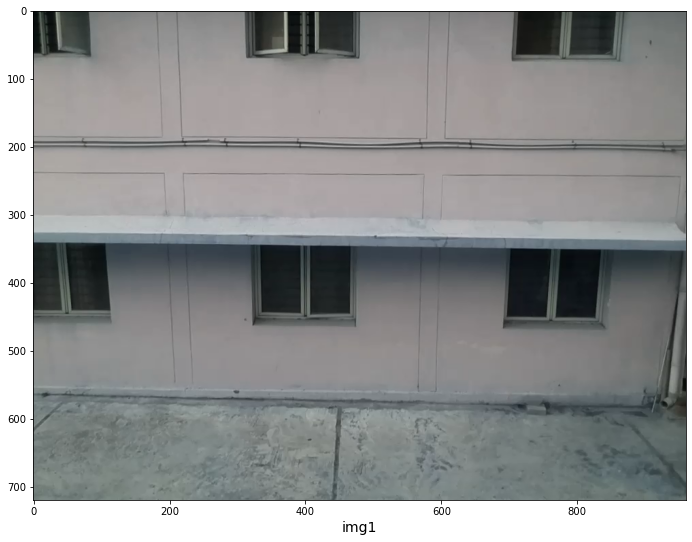

[361, 327, 486, 467]
mapped:361 1134 486 1241
[700, 355, 837, 462]
mapped:700 1156 837 1237
[0, 342, 110, 452]
mapped:0 1146 110 1230
[710, 0, 865, 75]
mapped:710 886 865 943


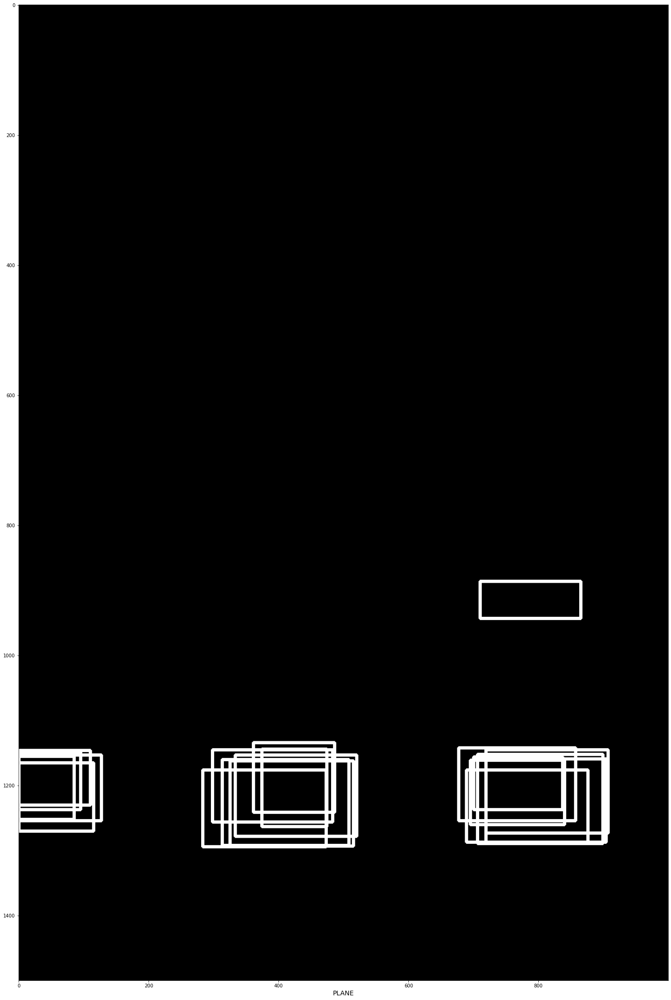

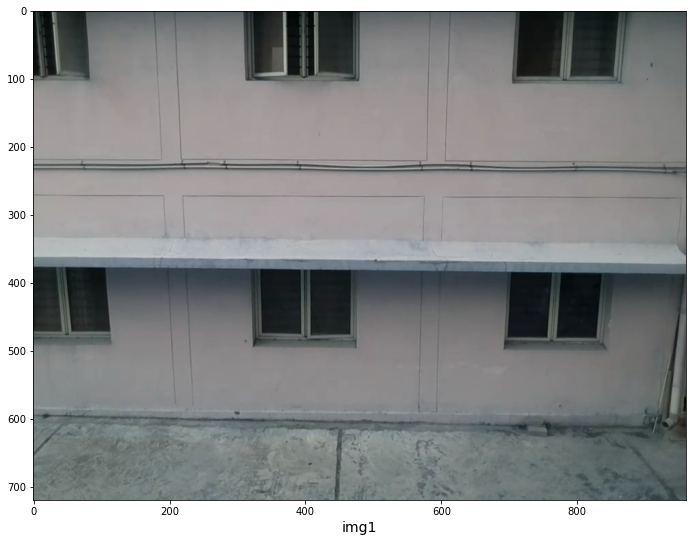

[700, 392, 840, 492]
mapped:700 1164 840 1240
[325, 385, 472, 490]
mapped:325 1159 472 1238
[0, 380, 110, 482]
mapped:0 1155 110 1232
[297, 0, 490, 122]
mapped:297 866 490 958
[717, 0, 862, 107]
mapped:717 866 862 947


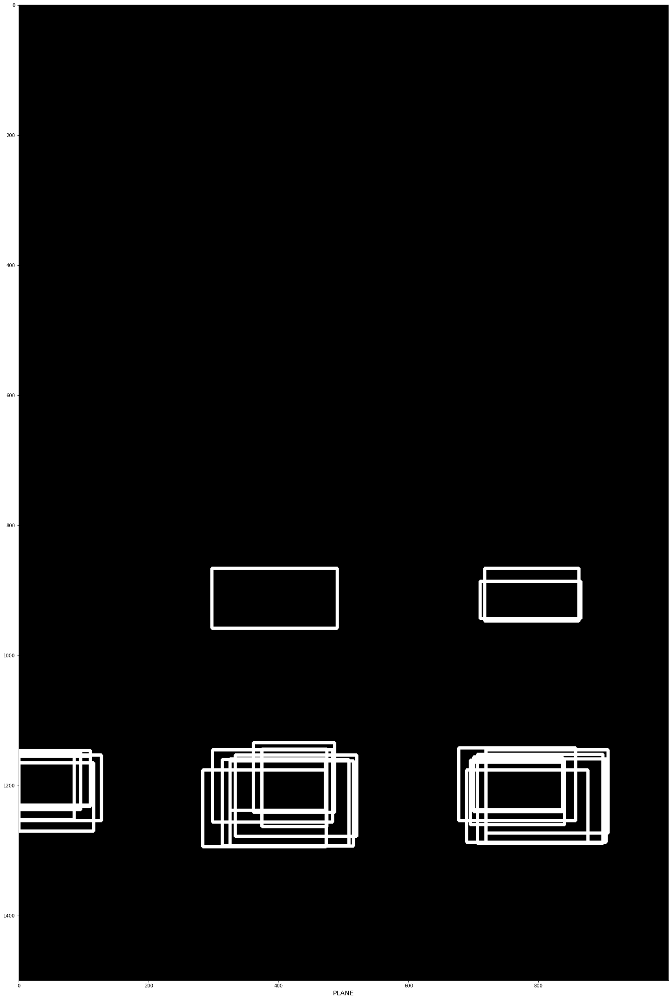

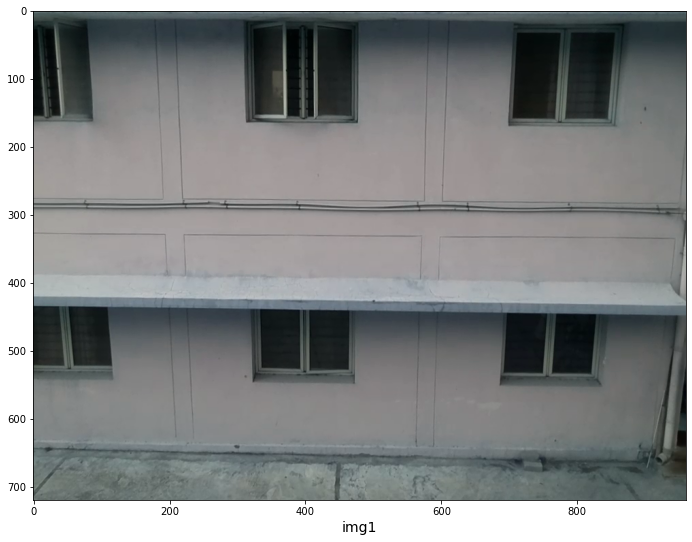

[695, 450, 830, 547]
mapped:695 1148 830 1222
[358, 422, 483, 547]
mapped:358 1127 483 1222
[0, 437, 110, 532]
mapped:0 1138 110 1210
[705, 25, 857, 170]
mapped:705 825 857 935
[312, 17, 475, 165]
mapped:312 819 475 931


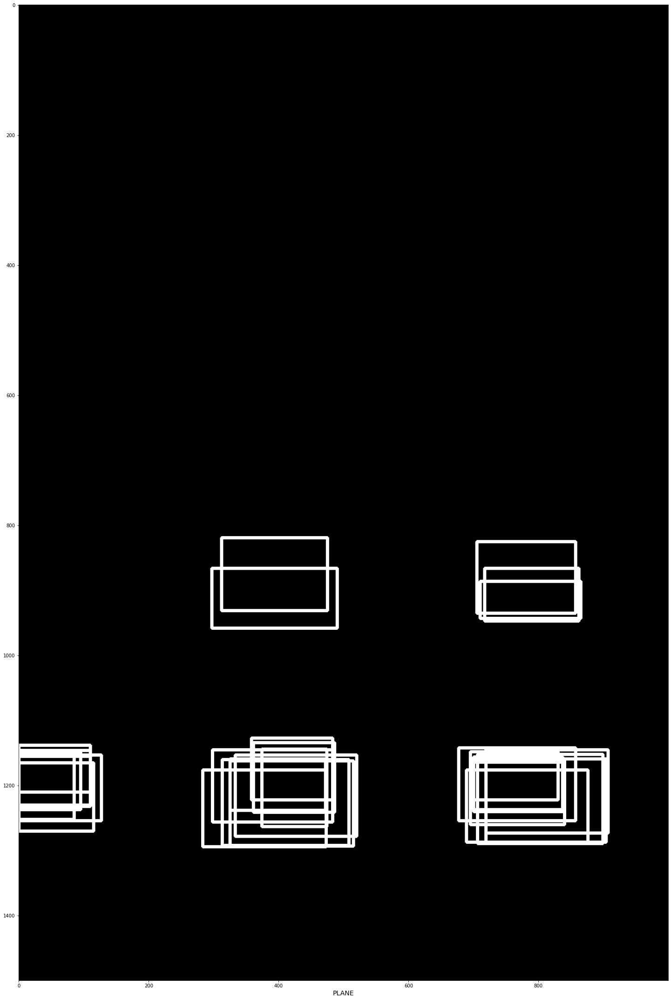

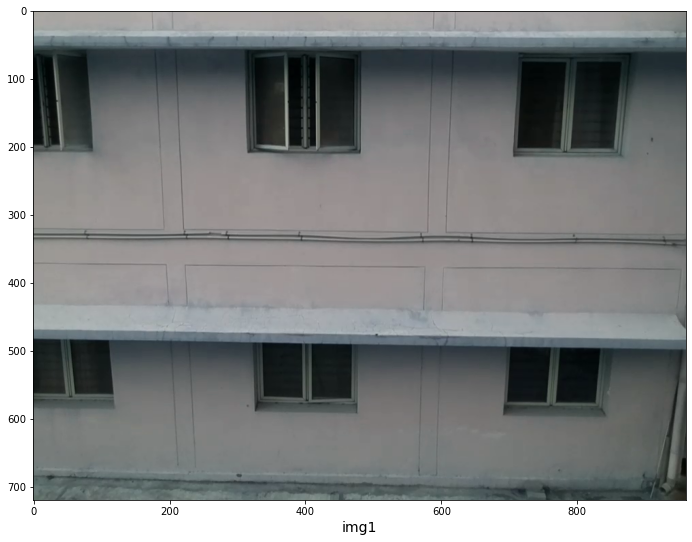

[697, 500, 840, 592]
mapped:697 1156 840 1226
[327, 495, 472, 585]
mapped:327 1152 472 1221
[0, 492, 112, 575]
mapped:0 1150 112 1213
[715, 65, 865, 212]
mapped:715 825 865 937
[315, 62, 475, 207]
mapped:315 823 475 933


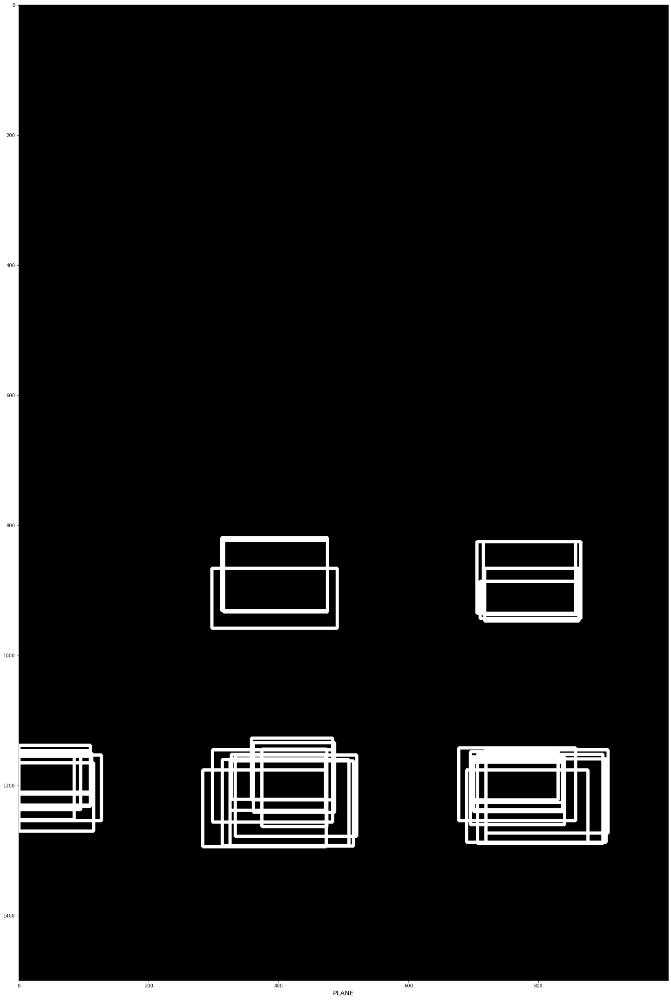

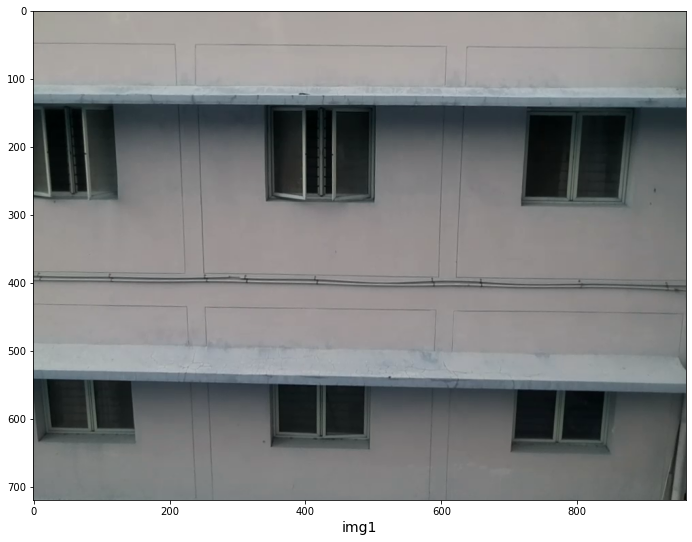

[710, 562, 845, 647]
mapped:710 1143 845 1208
[352, 555, 492, 640]
mapped:352 1138 492 1203
[5, 547, 150, 632]
mapped:5 1132 150 1196
[385, 125, 515, 292]
mapped:385 811 515 938
[725, 147, 872, 287]
mapped:725 827 872 934
[0, 140, 115, 277]
mapped:0 822 115 926


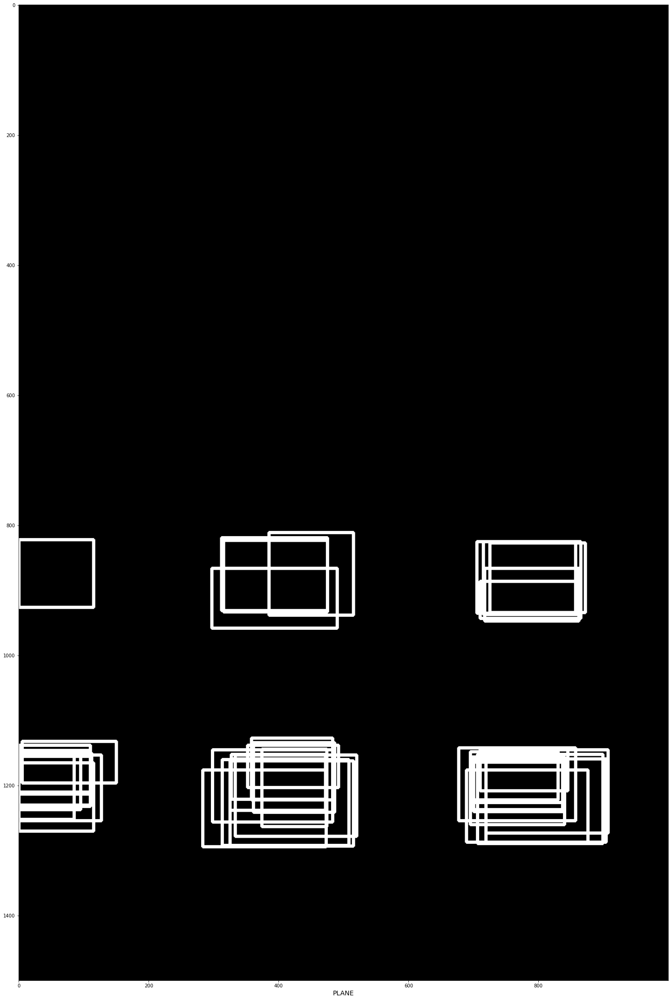

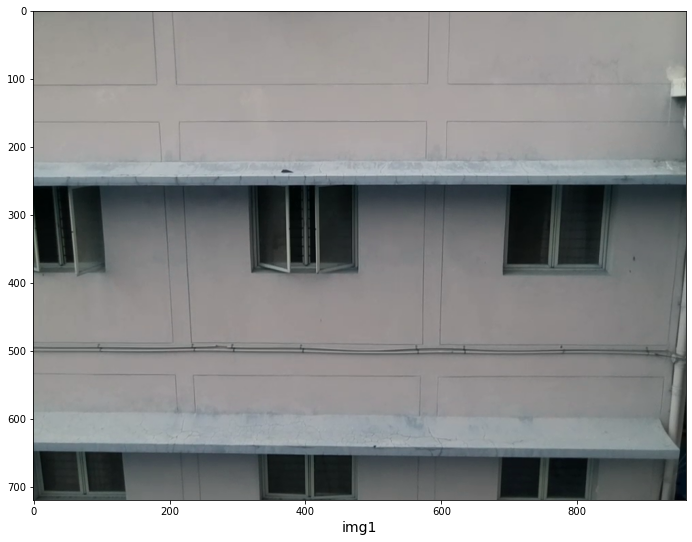

[337, 657, 470, 719]
mapped:337 1135 470 1183
[0, 655, 127, 719]
mapped:0 1134 127 1183
[308, 247, 495, 400]
mapped:308 824 495 940
[677, 247, 859, 400]
mapped:677 824 859 940
[0, 260, 97, 385]
mapped:0 833 97 929


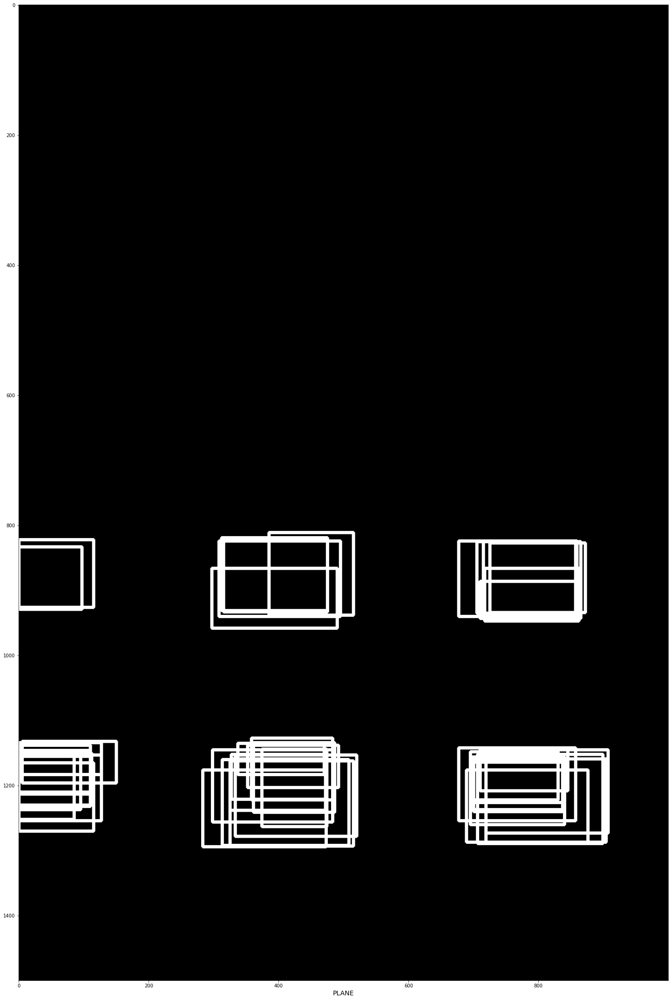

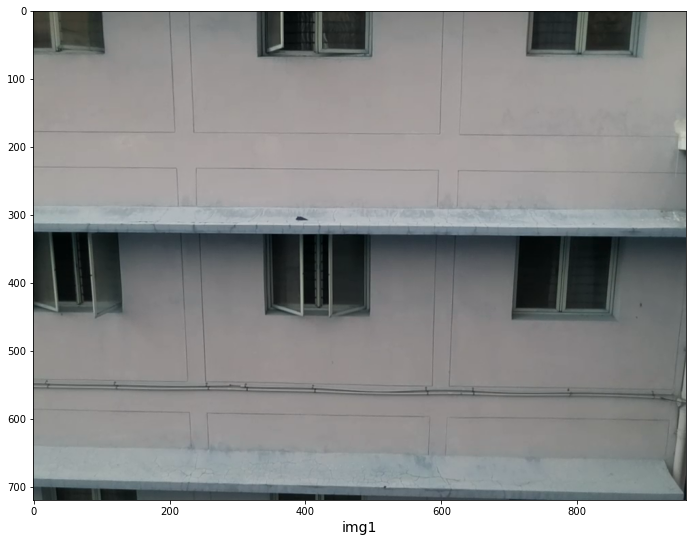

[710, 337, 855, 450]
mapped:710 842 855 928
[340, 335, 490, 447]
mapped:340 840 490 926
[0, 332, 120, 442]
mapped:0 838 120 922
[323, 0, 518, 85]
mapped:323 586 518 650
[711, 0, 899, 82]
mapped:711 586 899 648


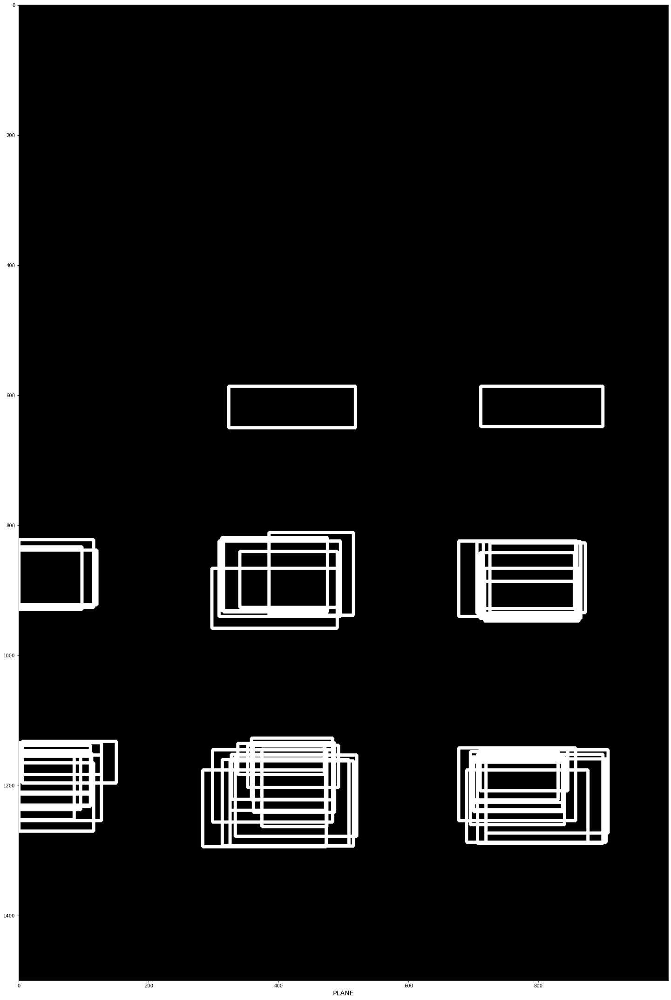

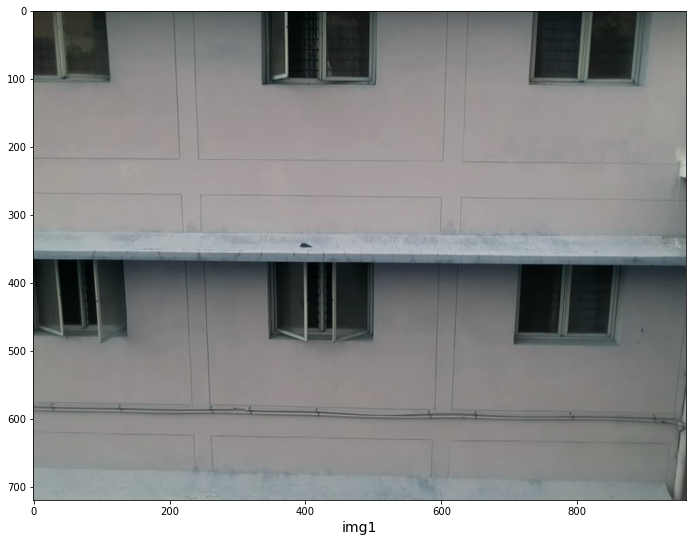

[712, 380, 857, 487]
mapped:712 845 857 926
[350, 375, 497, 482]
mapped:350 841 497 922
[0, 375, 132, 477]
mapped:0 841 132 919
[321, 0, 514, 125]
mapped:321 556 514 651
[712, 0, 899, 125]
mapped:712 556 899 651


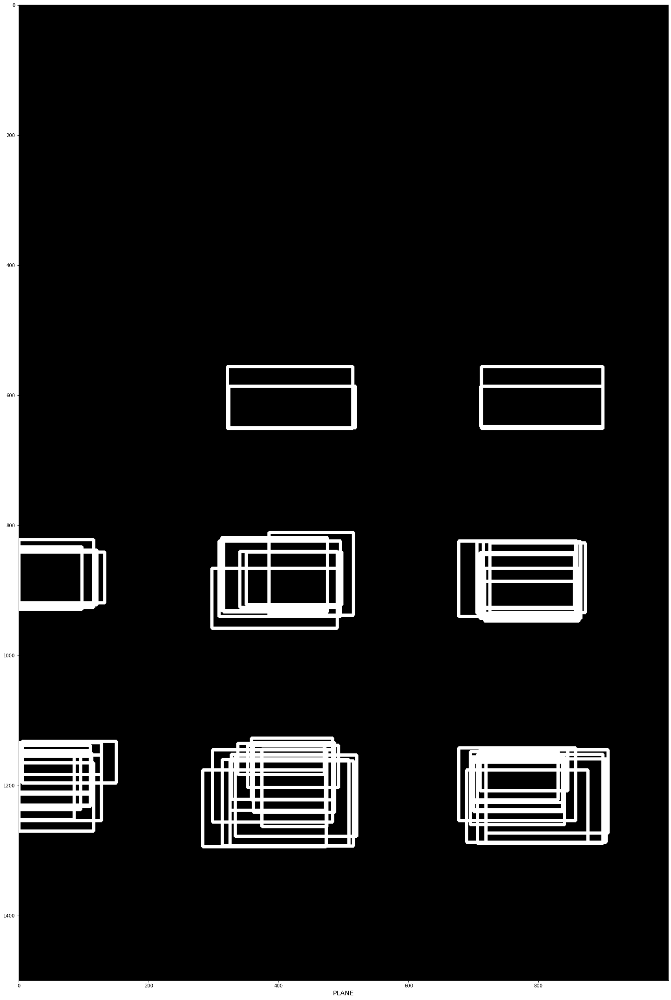

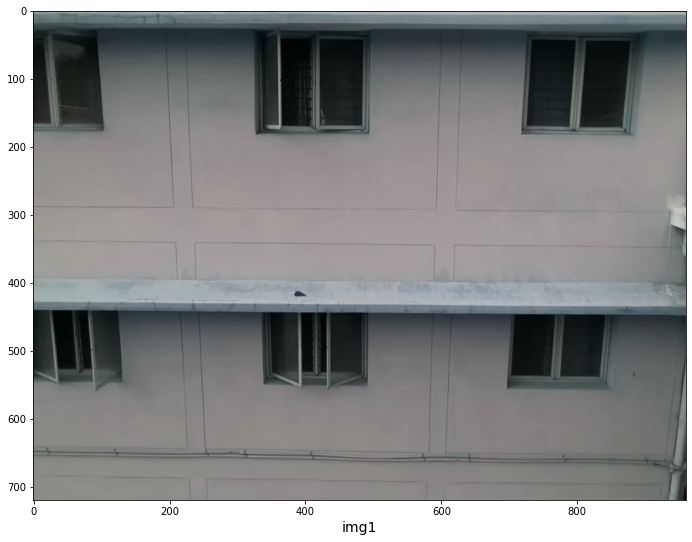

[340, 450, 490, 555]
mapped:340 848 490 928
[702, 455, 845, 552]
mapped:702 852 845 926
[0, 440, 127, 545]
mapped:0 840 127 920
[697, 17, 892, 197]
mapped:697 519 892 655
[315, 20, 517, 195]
mapped:315 521 517 654


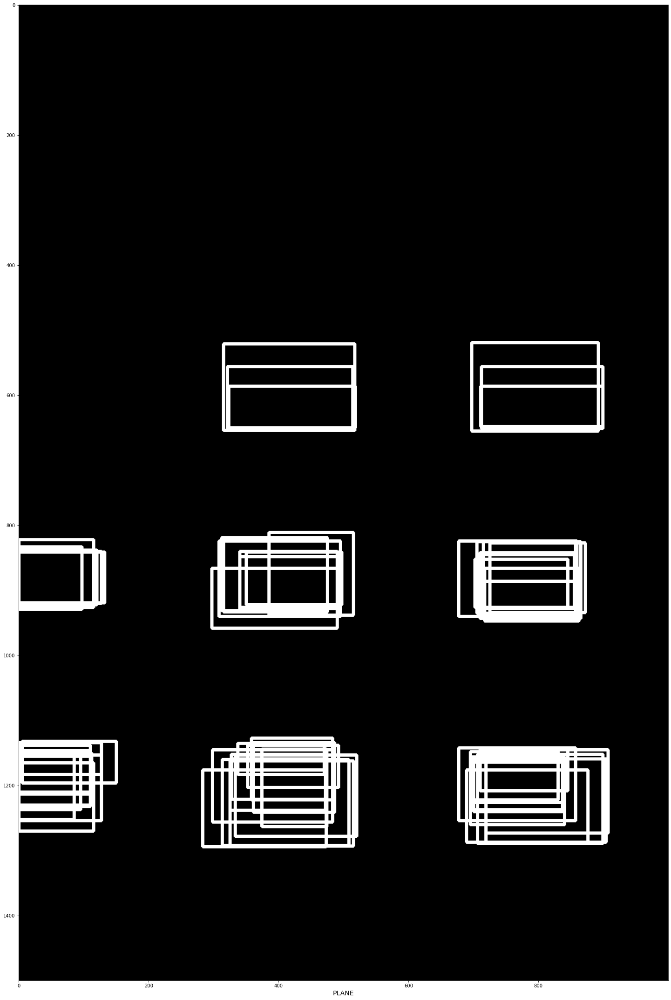

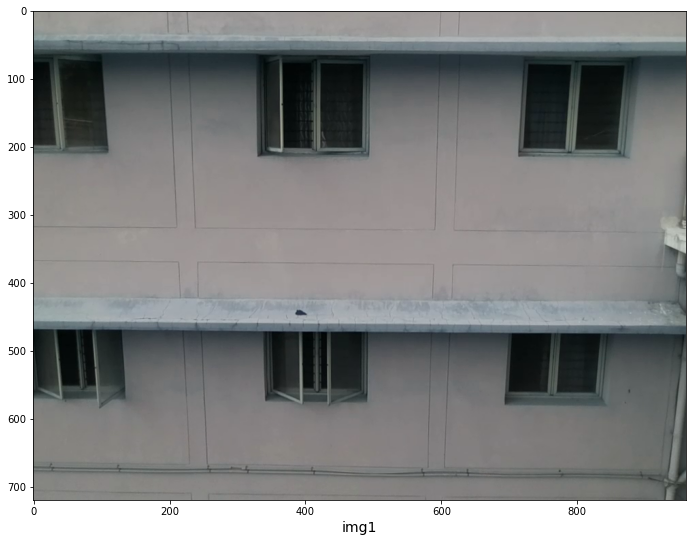

[340, 475, 490, 577]
mapped:340 837 490 915
[0, 470, 135, 572]
mapped:0 833 135 911
[700, 480, 840, 572]
mapped:700 841 840 911
[314, 55, 509, 230]
mapped:314 517 509 651
[703, 52, 893, 227]
mapped:703 515 893 648


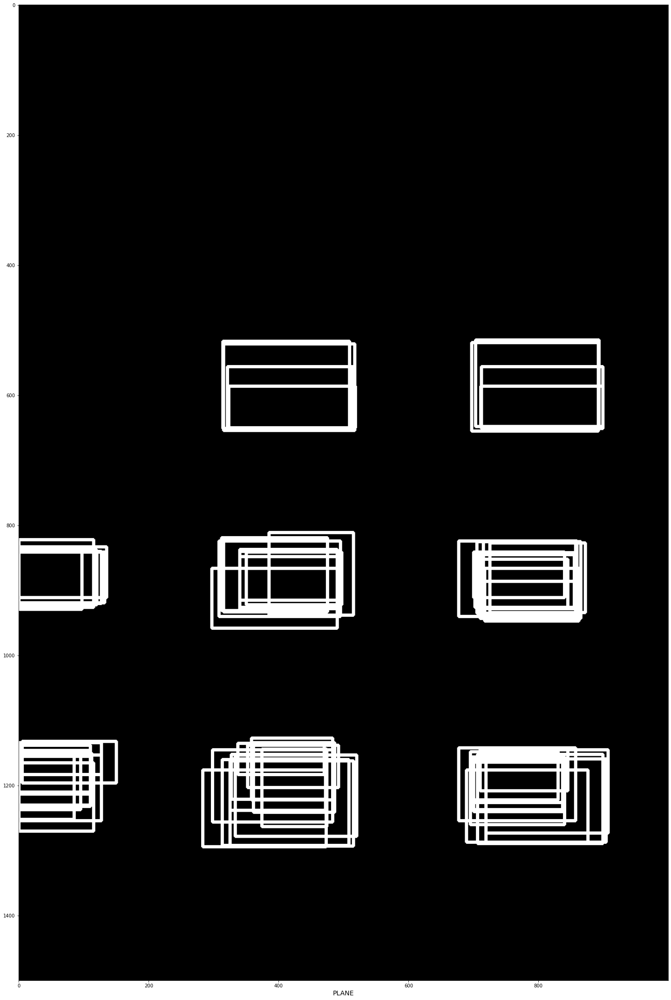

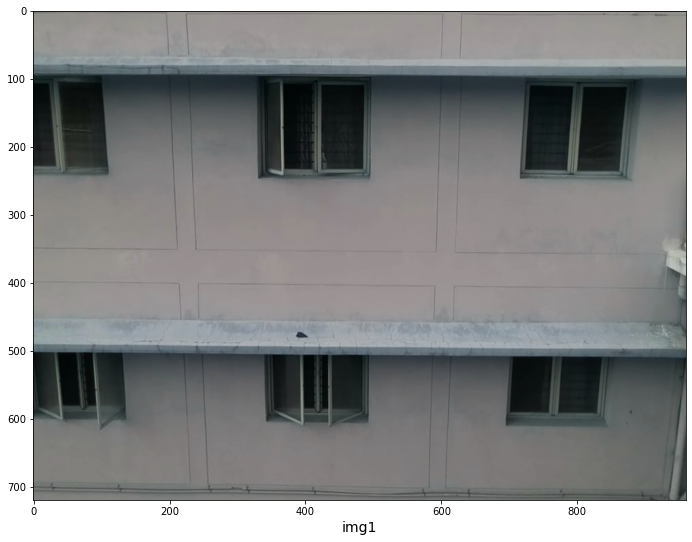

[0, 505, 135, 605]
mapped:0 830 135 906
[342, 515, 490, 605]
mapped:342 837 490 906
[702, 517, 840, 605]
mapped:702 839 840 906
[318, 87, 510, 260]
mapped:318 512 510 643
[707, 87, 894, 260]
mapped:707 512 894 643


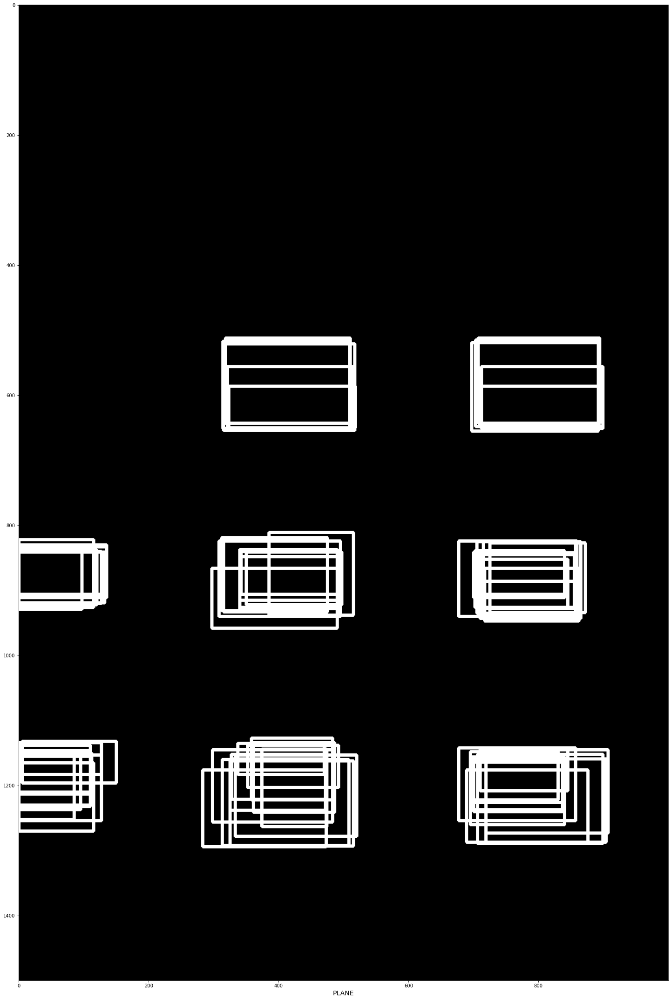

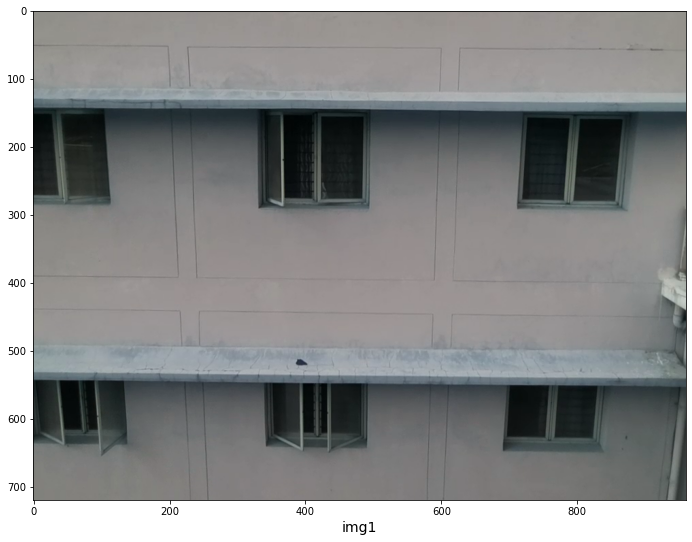

[342, 552, 490, 645]
mapped:342 836 490 906
[695, 555, 832, 645]
mapped:695 838 832 906
[0, 547, 130, 637]
mapped:0 832 130 900
[318, 137, 510, 305]
mapped:318 520 510 648
[699, 135, 889, 302]
mapped:699 518 889 645


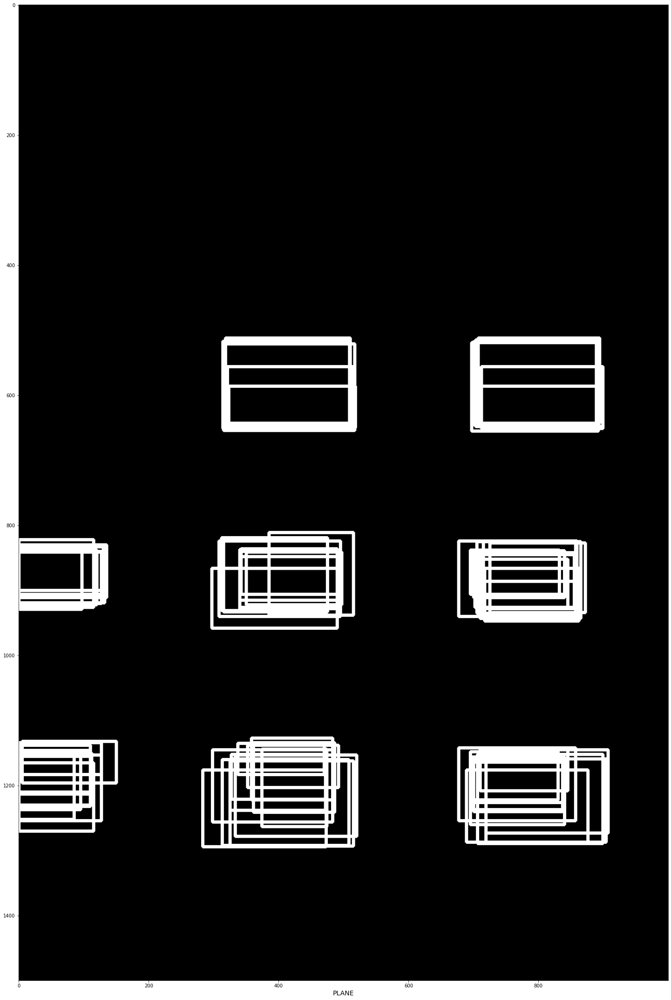

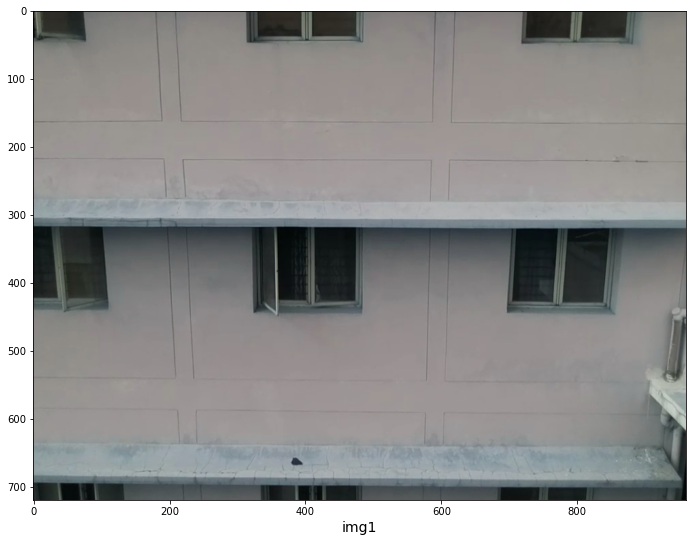

[682, 307, 870, 457]
mapped:682 539 870 653
[310, 307, 495, 455]
mapped:310 539 495 652


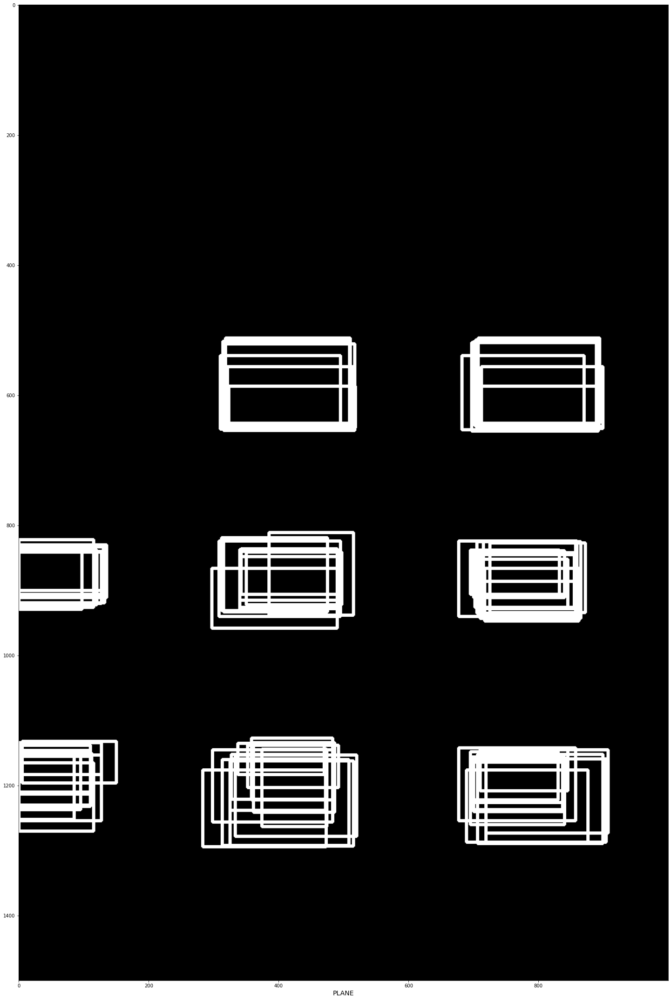

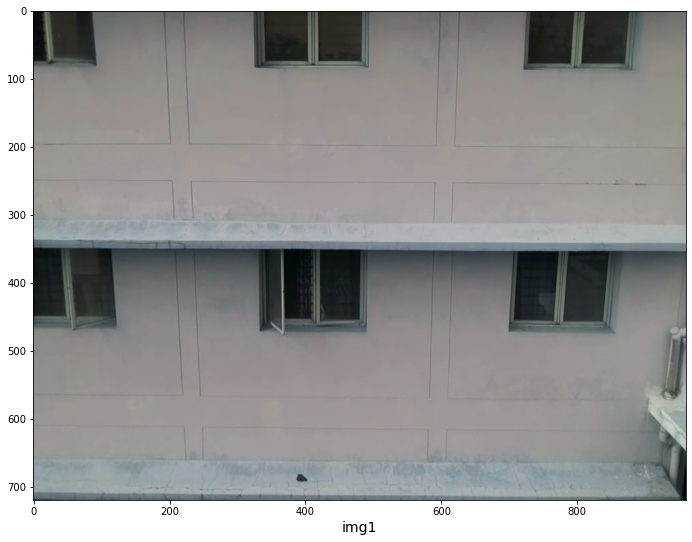

[685, 340, 870, 487]
mapped:685 534 870 646
[332, 355, 487, 470]
mapped:332 546 487 633
[318, 0, 508, 102]
mapped:318 276 508 353
[725, 0, 882, 87]
mapped:725 276 882 342


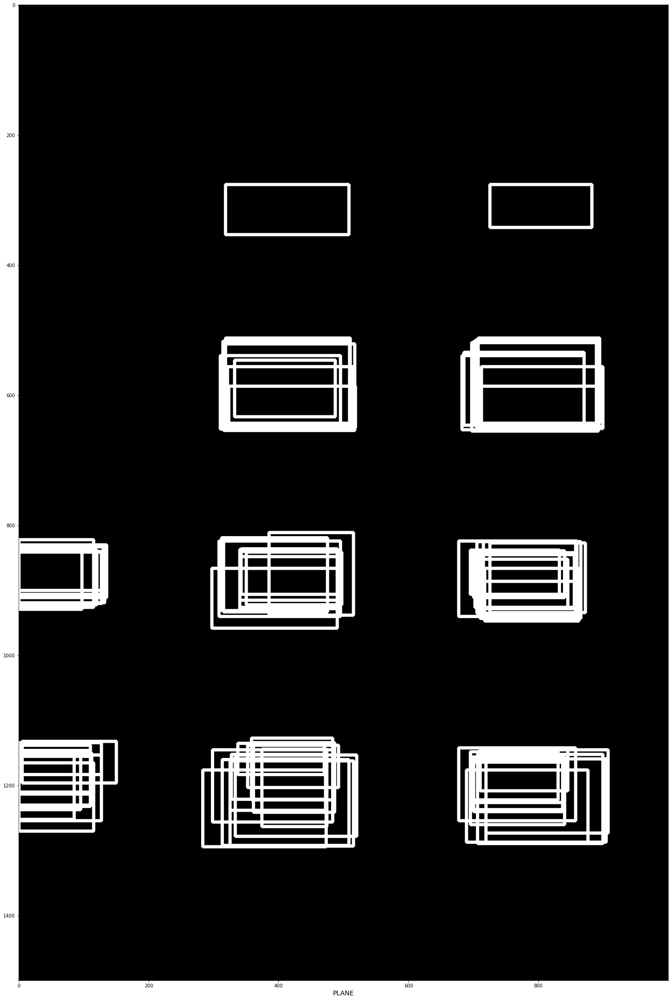

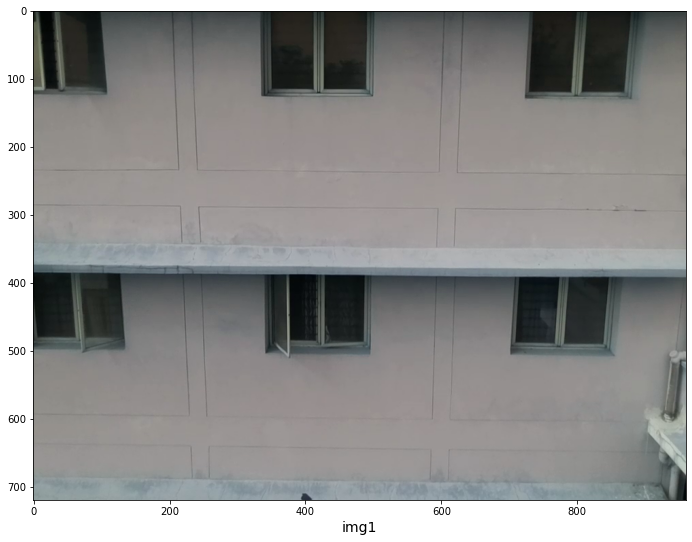

[325, 377, 510, 520]
mapped:325 542 510 651
[689, 377, 869, 520]
mapped:689 542 869 651
[328, 0, 518, 142]
mapped:328 256 518 364
[735, 0, 880, 127]
mapped:735 256 880 352


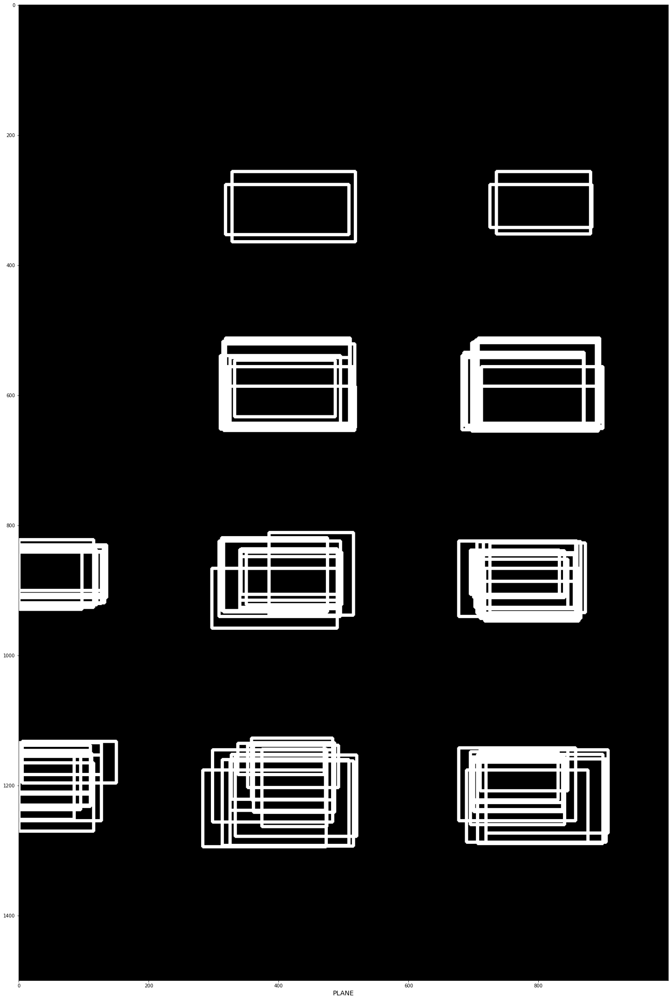

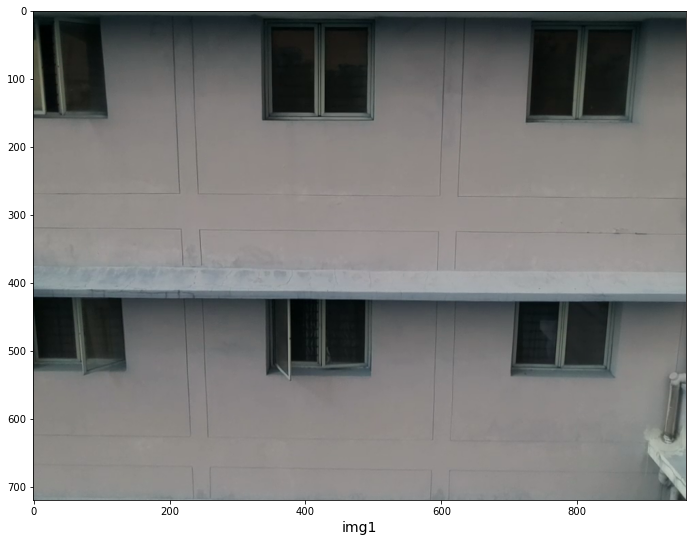

[691, 417, 868, 552]
mapped:691 553 868 656
[331, 417, 509, 550]
mapped:331 553 509 654
[329, 2, 522, 180]
mapped:329 237 522 373
[735, 17, 882, 165]
mapped:735 249 882 361


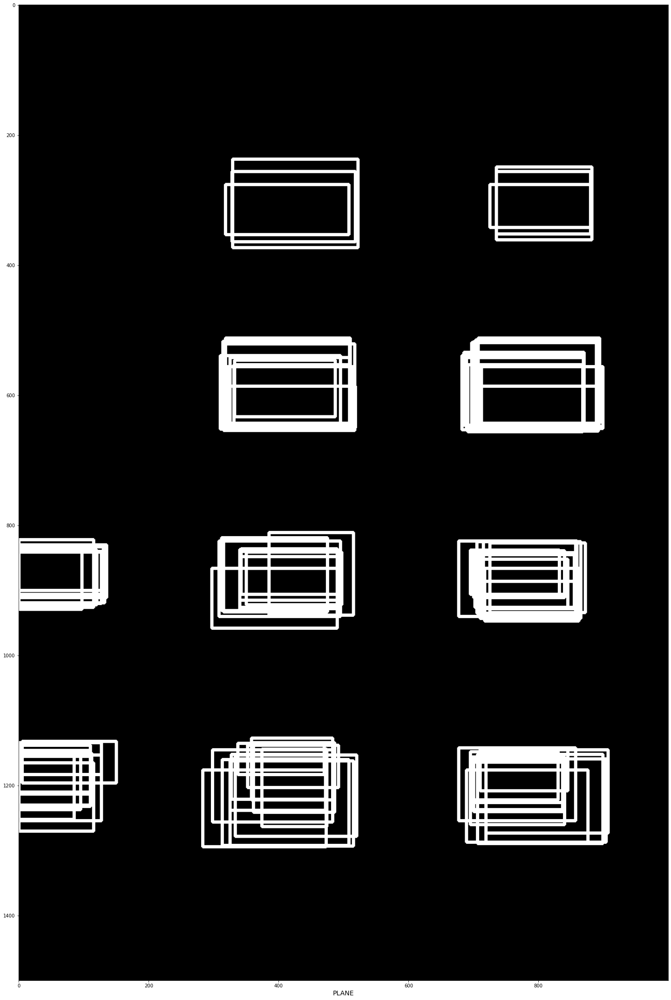

before NMS: [[ 283 1176  473 1294]
 [ 689 1176  876 1287]
 [ 313 1160  508 1292]
 [ 706 1152  899 1289]
 [ 325 1162  515 1293]
 [ 719 1159  904 1287]
 [   0 1165  115 1270]
 [ 333 1153  520 1278]
 [ 719 1145  907 1273]
 [   0 1153  127 1254]
 [ 374 1144  474 1263]
 [ 695 1161  840 1260]
 [   0 1155   85 1252]
 [ 298 1145  483 1256]
 [ 677 1142  857 1254]
 [   0 1149   95 1237]
 [ 361 1134  486 1241]
 [ 700 1156  837 1237]
 [   0 1146  110 1230]
 [ 710  886  865  943]
 [ 700 1164  840 1240]
 [ 325 1159  472 1238]
 [   0 1155  110 1232]
 [ 297  866  490  958]
 [ 717  866  862  947]
 [ 695 1148  830 1222]
 [ 358 1127  483 1222]
 [   0 1138  110 1210]
 [ 705  825  857  935]
 [ 312  819  475  931]
 [ 697 1156  840 1226]
 [ 327 1152  472 1221]
 [   0 1150  112 1213]
 [ 715  825  865  937]
 [ 315  823  475  933]
 [ 710 1143  845 1208]
 [ 352 1138  492 1203]
 [   5 1132  150 1196]
 [ 385  811  515  938]
 [ 725  827  872  934]
 [   0  822  115  926]
 [ 337 1135  470 1183]
 [   0 1134  127 1183]

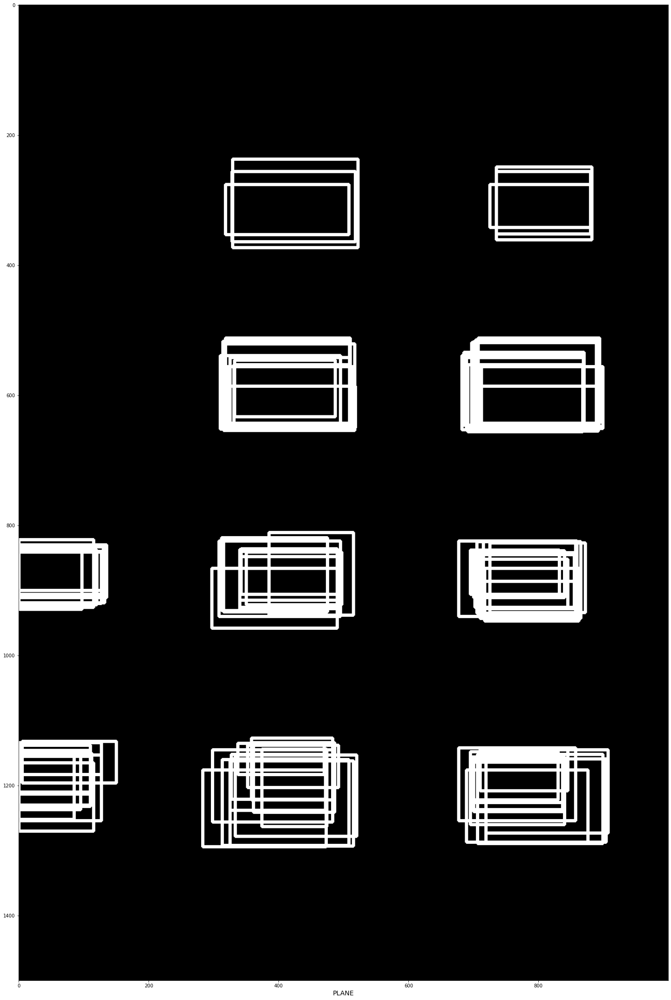

(90, 4)
after NMS: [[ 283 1176  473 1294]
 [ 706 1152  899 1289]
 [   0 1165  115 1270]
 [ 297  866  490  958]
 [ 717  866  862  947]
 [   0  833   97  929]
 [ 691  553  868  656]
 [ 331  553  509  654]
 [ 329  237  522  373]
 [ 735  249  882  361]]
(10, 4)


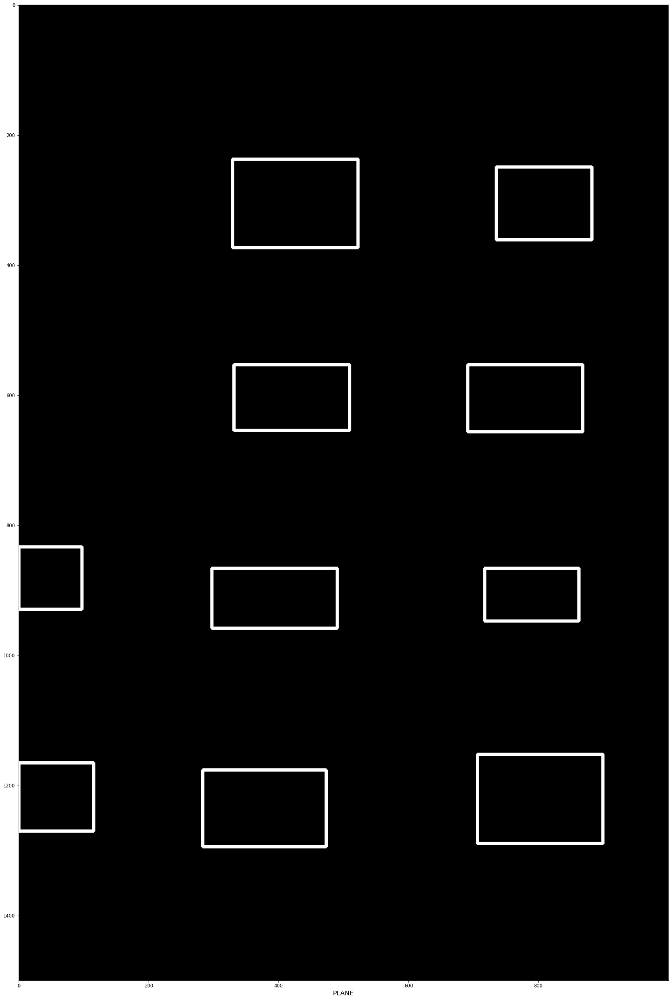

Total no. of windows in seq: 10
yAvg: [1235.  1220.5 1217.5  912.   906.5  881.   604.5  603.5  305.   305. ]
StoreyCount after running post processing module:  4
storeyHeights are: [265.0, 588.0, 895.5, 1195.0]


In [38]:


# grab the paths to the input images and initialize our images list
print("[INFO] loading images...")
print('imgPathDir:' + str(imgPath))
imagePaths = sorted(list(paths.list_images(imgPath)))
# print(imagePaths)
images = []
# loop over the image paths, load each one, and add them to our
# images to stitch list
for imagePath in imagePaths:
    image = cv2.imread(imagePath, 1)
#     print(image.shape)
    images.append(image)
    print(imagePath)

windowCount = len(FinalList[0])
print("startWindowCount:", windowCount)
allMappedBoxes = []
## MAIN LOOP ##
for i in range(len(images)):
    img1 = images[i]
    
#     print(img1.shape)
    # read images and transform them to grayscale
    # Make sure that the train image is the image that will be transformed
    # Opencv defines the color channel in the order BGR 
    # Transform it to RGB to be compatible to matplotlib
    img1_gray = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
#     img2_gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

    fig, ax1 = plt.subplots(nrows=1, ncols=1, constrained_layout=False, figsize=(16,9))
    ax1.imshow(img1, cmap="gray")
    ax1.set_xlabel("img1", fontsize=14)
    plt.show()
    
    ## Preparing Binary Mask and mapping bounding box coordinates
    ## COORDS1 and COORDS2 : WOULD COME FROM TEXT FILEW
    coords1 = FinalList[i]
#     coords2 = FinalList[i+1]
    
    padding = 0

    ## Commented as the coords would come from recorded text File.
    pick1 = mapToPickv1(coords1, padding)
#     pick2 = mapToPickv1(coords2, padding)
    
    mappedBoxes = mapToVerticalPlane(focalLength,depth,pick1,height_info[i], verticalPlaneCopy, img1)
    allMappedBoxes = allMappedBoxes + mappedBoxes
    
    fig, ax1 = plt.subplots(nrows=1, ncols=1, constrained_layout=False, figsize=(25, 500))
    ax1.imshow(verticalPlaneCopy, cmap="gray")
    ax1.set_xlabel("PLANE", fontsize=14)
    plt.show()
    
## NMS
print("before NMS:", np.array(allMappedBoxes))
plotBoxes(np.copy(verticalPlane), allMappedBoxes)
print(np.array(allMappedBoxes).shape)

finalBoxes = non_max_suppression_fast(np.array(allMappedBoxes), nmsThresh)
print("after NMS:", finalBoxes)
print(finalBoxes.shape)
plotBoxes(np.copy(verticalPlane), finalBoxes)
print("Total no. of windows in seq: " + str(finalBoxes.shape[0]))
storeyCount, storeyHeights, avgStoreyHeights = calculateStoreys(finalBoxes)

## Final Result of Vertical Plane Mapping Approach 

In [44]:
print("Total no. of windows in seq: " + str(finalBoxes.shape[0]))
storeyCount, storeyHeights, avgStoreyHeights = calculateStoreys(finalBoxes)
print("StoreyCount:", storeyCount)
print("storeyHeights:", storeyHeights)
print("avgStoreyHeights: ", avgStoreyHeights)

print("FinalBoxes:", finalBoxes)
print("FinalBoxes (in list):", list(finalBoxes))

Total no. of windows in seq: 10
yAvg Heights: [ 265.   279.5  282.5  588.   593.5  619.   895.5  896.5 1195.  1195. ]
avgStoreyHeights:  [275.6666666666667, 600.1666666666666, 896.0, 1195.0]
StoreyCount after running post processing module:  4
storeyHeights are: [265.0, 588.0, 895.5, 1195.0]
StoreyCount: 4
storeyHeights: [265.0, 588.0, 895.5, 1195.0]
avgStoreyHeights:  [275.6666666666667, 600.1666666666666, 896.0, 1195.0]
FinalBoxes: [[ 283 1176  473 1294]
 [ 706 1152  899 1289]
 [   0 1165  115 1270]
 [ 297  866  490  958]
 [ 717  866  862  947]
 [   0  833   97  929]
 [ 691  553  868  656]
 [ 331  553  509  654]
 [ 329  237  522  373]
 [ 735  249  882  361]]
FinalBoxes (in list): [array([ 283, 1176,  473, 1294]), array([ 706, 1152,  899, 1289]), array([   0, 1165,  115, 1270]), array([297, 866, 490, 958]), array([717, 866, 862, 947]), array([  0, 833,  97, 929]), array([691, 553, 868, 656]), array([331, 553, 509, 654]), array([329, 237, 522, 373]), array([735, 249, 882, 361])]
